# **REQUIREMENTS**

In [ ]:
!pip install clipscope pillow
!pip install open-clip-torch
!pip install ftfy regex tqdm
!pip install git+https://github.com/openai/CLIP.git
!pip install transformers pillow torch --quiet

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-9osbr8wb
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-9osbr8wb
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done


In [ ]:
from scipy.stats import mannwhitneyu
import numpy as np
from scipy.stats import shapiro, ks_2samp
from scipy.stats import mannwhitneyu, ks_2samp
import matplotlib.pyplot as plt
import seaborn as sns

import os
from PIL import Image
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

import math
from torch.utils.data import DataLoader

import json
import torch
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd


from matplotlib.path import Path
to_pil = transforms.ToPILImage()

from PIL import Image, ImageDraw



from urllib.request import urlopen
import PIL
from clipscope import ConfiguredViT, TopKSAE,SAE
import open_clip
import math
import torch.nn.functional as F
import torchvision.transforms as T
import torch.nn as nn
import torchvision.transforms as trans
from torchvision.transforms import Compose, Resize, ToTensor, Normalize, InterpolationMode
import clip
import cv2

from transformers import CLIPProcessor, CLIPModel, CLIPConfig
from clipscope import ConfiguredViT, TopKSAE,HookedViT


%matplotlib inline

from google.colab import drive
drive.mount('/content/drive')

import numpy as np
from PIL import Image
from scipy.ndimage import label
import matplotlib.pyplot as plt

import pandas as pd
import torch
from torch.utils.data import Dataset, DataLoader
import numpy as np
import requests
from io import BytesIO
from tqdm import tqdm


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **GENERAL CONFIGURATION**

General configuration of the model for information extraction such as residual layers, implementation of SAE to the CLIP architecture, implementation of GRAD-ECLIP, dataset configuration for images and text.

In [ ]:
def compute_ious_multiple_objects(mask_pil, mask_np, threshold,plot=False,n = 0.001):

    arr_pil = np.array(mask_pil)          # 0 o 255
    bin_pil = (arr_pil >= 128).astype(np.uint8)

    bin_np = (mask_np >= threshold).astype(np.uint8)

    label_np, num_labels = label(bin_np)

    ious = []
    valid_labels = []

    for lbl in range(1, num_labels+1):
        obj_mask = (label_np == lbl).astype(np.uint8)

        intersection = np.logical_and(bin_pil, obj_mask).sum()
        union        = np.logical_or(bin_pil, obj_mask).sum()

        if union == 0:
            iou_val = 0.0
        else:
            iou_val = intersection / union

        if iou_val > 0:
            ious.append(iou_val)
            valid_labels.append(lbl)

    index_valid_labels=[i for i, x in enumerate(ious) if x > n]
    valid_labels = [valid_labels[i] for i in index_valid_labels]
    ious = [x for x in ious if x > n]

    combined_mask = np.zeros_like(bin_pil, dtype=np.uint8)


    for i, lbl in enumerate(valid_labels, start=1):

      obj_mask = (label_np == lbl).astype(np.uint8)
      combined_mask = combined_mask  | obj_mask


    intersection = np.logical_and(bin_pil, combined_mask).sum()
    union        = np.logical_or(bin_pil, combined_mask).sum()

    if union == 0:
        final_IoU = 0.0
    else:
        final_IoU = intersection / union

    if plot:
        fig, axs = plt.subplots(
            1,
            1 + len(valid_labels),
            figsize=(5*(1 + len(valid_labels)), 5)
        )

        if not isinstance(axs, np.ndarray):
            axs = [axs]

        axs[0].imshow(mask_pil, cmap='gray')
        axs[0].set_title("mask_pil (un objeto)")
        axs[0].axis('off')

        # (b) Mostrar cada objeto válido en subplots siguientes
        for i, lbl in enumerate(valid_labels, start=1):
            obj_mask = (label_np == lbl).astype(np.uint8)
            axs[i].imshow(obj_mask, cmap='jet')
            axs[i].set_title(f"Obj label={lbl}\nIoU={ious[i-1]:.3f}")
            axs[i].axis('off')

        plt.tight_layout()
        plt.show()

    return final_IoU, combined_mask



In [ ]:
def create_binary_mask(image_id, annotations_path):
    identifier = image_id
    with open(annotations_path, "r") as f:
      annotations = json.load(f)

    image_data = next((item for item in annotations['images'] if identifier in item['file_name']), None)

    if not image_data:
        print(f"Error: {identifier}")
        return None
    width, height = image_data['width'], image_data['height']


    mask = Image.new('L', (width, height), 0)
    draw = ImageDraw.Draw(mask)

    for annotation in annotations['annotations']:
        if annotation['image_id'] == image_id:
            segmentation = annotation['segmentation']
            for seg in segmentation:

                polygon = np.array(seg).reshape(-1, 2).tolist()
                draw.polygon(polygon, outline=1, fill=1)


    return np.array(mask)

In [ ]:

torch.manual_seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(42)

class CustomCLIPVisionModel(nn.Module):
    def __init__(self,dir_sae_hf,layer_sae ):
        super().__init__()

        device = "cuda" if torch.cuda.is_available() else "cpu"


        self.locations = [(layer_sae, 'resid')]

        def get_ViT_eager(self, model_name):
            config = CLIPConfig.from_pretrained(model_name, attn_implementation="eager")
            model = CLIPModel.from_pretrained(model_name, config=config)
            processor = CLIPProcessor.from_pretrained(model_name)
            return model, processor

        original_get_ViT = HookedViT.get_ViT  # Guardar el original si es necesario
        HookedViT.get_ViT = get_ViT_eager

        #CLIP
        self.clip_model = ConfiguredViT(self.locations, device=device).model

        #ViT
        self.vision_model = self.clip_model.vision_model
        self.embeddings = self.vision_model.embeddings
        self.pre_layernorm = self.vision_model.pre_layrnorm
        self.encoder = self.vision_model.encoder
        self.post_layernorm = self.vision_model.post_layernorm
        self.visual_projection = self.clip_model.visual_projection


        #LLM
        self.text_model = self.clip_model.text_model
        self.text_projection = self.clip_model.text_projection

    def compute_attention(self, layer, hidden_states):

          bs, seq_len, _ = hidden_states.shape
          num_heads = layer.self_attn.num_heads
          head_dim = layer.self_attn.head_dim


          q = layer.self_attn.q_proj(hidden_states) * layer.self_attn.scale
          key_proj = layer.self_attn.k_proj(hidden_states)
          value_proj = layer.self_attn.v_proj(hidden_states)

          # Usar _shape para keys y values
          key_states = layer.self_attn._shape(key_proj, seq_len, bs)
          value_states = layer.self_attn._shape(value_proj, seq_len, bs)

          # Para queries, reorganizar similarmente:
          query_states = layer.self_attn._shape(q, seq_len, bs)

          proj_shape = (bs * num_heads, seq_len, head_dim)

          query_states = query_states.view(*proj_shape)
          key_states = key_states.view(*proj_shape)
          value_states = value_states.view(*proj_shape)

          attn_weights = torch.bmm(query_states, key_states.transpose(1, 2))
          attn_weights = F.softmax(attn_weights, dim=-1)

          # Aplicar dropout
          attn_probs = nn.functional.dropout(attn_weights, p=layer.self_attn.dropout, training=layer.self_attn.training)

          attn_output_heads = torch.bmm(attn_probs, value_states)

          attn_output = attn_output_heads.transpose(0, 1).contiguous().view(bs, seq_len, num_heads * head_dim)
          attn_output = layer.self_attn.out_proj(attn_output)

          attn_output_weights = attn_weights.view(bs, num_heads, seq_len, -1).sum(dim=1) / num_heads

          return attn_output , attn_output_weights, query_states, key_states, value_states



    def reshape_to_heads(self,x,bs, seq_len, num_heads, head_dim):
      return x.view(bs, seq_len, num_heads, head_dim).transpose(1, 2).contiguous()

    def forward(self, pixel_values,text_values, n,intervene_layer_sae,SAEs,data_extraction=False,intervene_laten_vector=None):


        with torch.no_grad():

          text_embedding = self.text_model(text_values)
          text_embedding = self.text_projection(text_embedding[1])


        data_extraction_laten= []
        cos_reconstruction_laten = []


        sae_counter=0
        sae_counter_int = 0
        # layers_to_intervene = sorted({tupla[0] for tupla in intervene_laten_vector[0] }, reverse=True)
        # print(layers_to_intervene)
        encodes = []

        feah, feaw = self.vision_model.embeddings.patch_embedding(pixel_values).shape[-2:]

        all_attn_output_grad_eclip = []
        all_attn_weigths_grad_eclip = []
        q = []
        k = []
        v = []


        hidden_states = self.embeddings(pixel_values)
        hidden_states = self.pre_layernorm(hidden_states)

        for idx, layer in enumerate(self.encoder.layers):
            residual = hidden_states
            normed1 = layer.layer_norm1(hidden_states)


            if idx < n:

              attn_output, _ = layer.self_attn(
                  normed1,
                  attention_mask=None,
                  causal_attention_mask=None,
                  output_attentions=False
              )
              hidden_states = residual + attn_output

            else:

              last_hiddens_state_grad_eclip = normed1

              attn_output, attn_output_weights, q_states, k_states, v_states = self.compute_attention(layer,normed1)
              q.append(q_states)
              k.append(k_states)
              v.append(v_states)

              all_attn_output_grad_eclip.append(attn_output)
              all_attn_weigths_grad_eclip.append(attn_output_weights)

              hidden_states = residual + attn_output

            residual = hidden_states
            normed2 = layer.layer_norm2(hidden_states)
            mlp_output = layer.mlp(normed2)
            hidden_states = residual + mlp_output

            if idx == 21:

              recon_sae = SAEs[0].forward(hidden_states[:, 0, :])
              laten_s = SAEs[0].get_latent_representation(hidden_states[:, 0, :])
              data_extraction_laten.append(laten_s)
              cos_recu_sae = F.cosine_similarity(recon_sae, hidden_states[:, 0, :], dim=-1)
              cos_reconstruction_laten.append(cos_recu_sae)
              print(f'Coseno reconstru layer {idx}',cos_recu_sae)

              hidden_states[:, 0, :] = recon_sae

            elif idx == 22:
              recon_sae = SAEs[1].forward(hidden_states[:, 0, :])
              laten_s = SAEs[1].get_latent_representation(hidden_states[:, 0, :])
              data_extraction_laten.append(laten_s)
              cos_recu_sae = F.cosine_similarity(recon_sae, hidden_states[:, 0, :], dim=-1)
              cos_reconstruction_laten.append(cos_recu_sae)
              print(f'Coseno reconstru layer {idx}',cos_recu_sae)

              hidden_states[:, 0, :] = recon_sae

            elif idx == 23:

              recon_sae = SAEs[2].forward(hidden_states[:, 0, :])
              laten_s = SAEs[2].get_latent_representation(hidden_states[:, 0, :])
              data_extraction_laten.append(laten_s)
              cos_recu_sae = F.cosine_similarity(recon_sae, hidden_states[:, 0, :], dim=-1)
              cos_reconstruction_laten.append(cos_recu_sae)
              print(f'Coseno reconstru layer {idx}',cos_recu_sae)

              hidden_states[:, 0, :] = recon_sae





            # if idx == 24:
            #   #(idx in self.saes_layers) and not(data_extraction):
            #   print('pailas')




            #   sae_input = hidden_states[:, 0, :]

            #   encoded = sae_jr.forward(sae_input)

            #   cos = F.cosine_similarity(sae_input, encoded, dim=-1)

            #   print('Cos sim: ',cos)


              # sae = self.saes[sae_counter]
              # encoded = sae._encode((sae_input - sae.pre_b) @ sae.enc)
              # encodes.append(encoded)
              # layers_to_intervene=[123,1234]

              # if sae_counter in layers_to_intervene: #generate intervene

              #   filter_with_layer  = [tupla[1] for tupla in intervene_laten_vector[0] if tupla[0] == sae_counter_int]
              #   mask = torch.ones_like(encoded)
              #   values = [intervene_laten_vector[1] for _ in range(len(filter_with_layer))]

              #   for ind, value in zip(filter_with_layer, values):
              #     mask[0,ind] = value

              #   latent = encoded * mask

              #   sae_counter_int+=1

              # else:

              #   latent = encoded



              # sae_counter += 1

              # _, reconstruction = sae._decode(latent, sae.dec)
              # reconstruction = reconstruction + sae.pre_b

              # #prueba_norm = F.normalize(reconstruction, p=2, dim=1, eps=1e-12)

              # cos = F.cosine_similarity(sae_input, reconstruction, dim=-1)


              # hidden_states[:, 0, :] = encoded#reconstruction




        pooled_output = hidden_states[:, 0, :]
        pooled_output = self.post_layernorm(pooled_output)

        vit_output = self.visual_projection(pooled_output)

        cosine_final = F.cosine_similarity(text_embedding,vit_output, dim=-1)


        print('Final consin ',cosine_final )

        return {
          "data_extraction_laten":data_extraction_laten,
          "cos_reconstruction_laten":cos_reconstruction_laten,
          "cos_reconstruction_constractive":cosine_final,
          }

        # return {
        #     "last_hiddens_state_grad_eclip": last_hiddens_state_grad_eclip,
        #     "vit_output": vit_output,
        #     "all_attn_output_grad_eclip": all_attn_output_grad_eclip,
        #     "all_attn_weigths_grad_eclip": all_attn_weigths_grad_eclip,
        #     "q": q,
        #     "k": k,
        #     "v": v,
        #     "encoded_sae": encodes,
        #     "feah, feaw": (feah, feaw),
        #     "data_extraction":data_extraction_list,
        #     "cosine":cosine}

    def grad_eclip(self,pixel_values,text_values, n,intervene_layer_sae,intervene_laten_vector,img,plot):

      general_info = {}
      with torch.no_grad():
            text_embedding = self.text_model(text_values)
            text_embedding = self.text_projection(text_embedding[1])
      visual_encoder = self.forward(pixel_values=pixel_values, n=n,
                                    intervene_layer_sae=intervene_layer_sae,
                                    data_extraction=False,
                                    intervene_laten_vector=intervene_laten_vector)
      # Extraer variables de visual_encoder sin rastrear gradientes
      qs = visual_encoder["q"]
      ks = visual_encoder["k"]
      vs = visual_encoder["v"]
      attn_outputs = visual_encoder["all_attn_output_grad_eclip"]
      map_size = visual_encoder["feah, feaw"]
      visual_embedding = visual_encoder["vit_output"]



      cosine = F.cosine_similarity(text_embedding,visual_embedding, dim=-1)

      tmp_maps = []


    # Iterar sobre capas de atención para generar mapas temporales espaciales
      for q, k, v, attn_output in zip(qs, ks, vs, attn_outputs):
          attn_output.requires_grad_(True)
          grad = torch.autograd.grad(cosine, attn_output, retain_graph=True)[0]

          # Extraer gradientes para tokens espaciales, excluyendo el token de clase (asumiendo posición 0)
          # Suponemos que la dimensión 1 corresponde a la secuencia (tokens)
          # y que el primer token es el [CLS], por lo que 1: toma los tokens espaciales.
          grad_spatial = grad[0, 1:, :]  # Forma: [256, 1024] si hay 256 tokens espaciales

          # Reorganizar grad_spatial en cabezas y dimensión de canal
          num_heads = 16
          head_dim = 64
          # Dividir la dimensión 1024 en 16 cabezas de 64
          grad_spatial_heads = grad_spatial.view(256, num_heads, head_dim)  # Forma: [256, 16, 64]

          # Extraer v_patch para tokens espaciales en todas las cabezas
          # v tiene forma [16, 257, 64] => queremos excluir el token de clase (índice 0 en secuencia)
          # y reorganizar para que la dimensión espacial sea la primera.
          # Primero, excluimos el token de clase a lo largo de la secuencia:
          v_spatial = v[:, 1:, :]  # Forma: [16, 256, 64]
          # Reorganizamos para obtener dimensión [256, 16, 64]
          v_patch = v_spatial.permute(1, 0, 2)  # Forma: [256, 16, 64]

          ####################################################

          # --- Cálculo de la normalización espacial suave w_i ---
          # Suponiendo que q y k tienen forma [num_heads, seq_len, head_dim]
          q_cls = q[:, 0, :]         # Extraer el token [CLS]: forma [16, 64]
          k_spatial =  k[:, 1:, :].permute(1, 0, 2)  # Excluir el token [CLS]: forma [16, 256, 64]


          # Calcular la similitud entre q_cls y cada k_i para cada head
          # Resultados en sim de forma [256, 16]: para cada token espacial y head
          sim = torch.einsum('hd,ihd->ih', q_cls, k_spatial)

          # Aplicar normalización min-max suave por cada head
          w_i_list = []
          for head in range(sim.size(1)):
              sim_head = sim[:, head]              # [256]
              sim_min, sim_max = sim_head.min(), sim_head.max()
              if sim_max - sim_min > 1e-6:
                  w_head = (sim_head - sim_min) / (sim_max - sim_min)
              else:
                  w_head = torch.zeros_like(sim_head)
              w_i_list.append(w_head)
          # w_i: forma [256, 16]
          w_i = torch.stack(w_i_list, dim=1)

          # Expandir w_i para que coincida con la dimensión de canal
          w_i_expanded = w_i.unsqueeze(-1)  # Forma: [256, 16, 1]

          # Combinar gradientes, w_i suave y valores v_patch
          combined = (grad_spatial_heads * w_i_expanded) * v_patch

          spatial_map = combined.sum(dim=(1, 2))  # Forma: [256]

          ####################################################


          # # Combinar gradientes y valores
          # combined = grad_spatial_heads * v_patch  # Forma: [256, 16, 64]

          # # Sumar sobre las dimensiones de cabeza y canal para obtener un valor por ubicación espacial
          # spatial_map = combined.sum(dim=(1, 2))  # Forma: [256]

          tmp_maps.append(spatial_map)

          del grad, grad_spatial, grad_spatial_heads, v_spatial, v_patch, combined, spatial_map
          torch.cuda.empty_cache()

      # Apilar mapas temporales de cada capa
      stacked_maps = torch.stack(tmp_maps, dim=0)  # Forma: [N, 256] para N capas
      relu_maps = F.relu_(stacked_maps)            # Aplicar ReLU in situ
      # Sumar sobre la dimensión de capas para combinar resultados de todas las capas
      emap = relu_maps.sum(0)                      # Forma: [256]

      # Reorganizar emap a la forma espacial 16x16
      emap = emap.reshape(*map_size)
      h, w = img.size
      resize = trans.Resize((w,h))

      tmp = emap.clone()
      tmp -= tmp.min()
      tmp /= tmp.max()
      c_ret, map = self.visualize(tmp.detach().cpu(), img, resize)
      general_info['heatmap'] = map
      general_info['heatmap_and_img'] = c_ret

      if plot:
        plt.axis('off')
        plt.imshow(c_ret)
        plt.show()

      torch.cuda.empty_cache()

      general_info['laten_space'] = visual_encoder["encoded_sae"]
      general_info['cosine_similarity'] = cosine

      return general_info

    def sim_qk(self,q, k):
      q_cls = F.normalize(q[:1,0,:], dim=-1)
      k_patch = F.normalize(k[1:,0,:], dim=-1)

      cosine_qk = (q_cls * k_patch).sum(-1)
      cosine_qk_max = cosine_qk.max(dim=-1, keepdim=True)[0]
      cosine_qk_min = cosine_qk.min(dim=-1, keepdim=True)[0]
      cosine_qk = (cosine_qk-cosine_qk_min) / (cosine_qk_max-cosine_qk_min)
      return cosine_qk

    def visualize(self, map, raw_image, resize):
        image = np.asarray(raw_image.copy())
        map = resize(map.unsqueeze(0))[0].cpu().numpy()

        map = np.nan_to_num(map, nan=0.0, posinf=1.0, neginf=0.0)
        map = np.clip(map, 0, 1)  # Escalar al rango [0, 1]

        color = cv2.applyColorMap((map*255).astype(np.uint8), cv2.COLORMAP_JET) # cv2 to plt
        color = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
        c_ret = np.clip(image * (1 - 0.5) + color * 0.5, 0, 255).astype(np.uint8)
        return c_ret, map

  #  def forward_text(self, input_ids, attention_mask=None, position_ids=None):
  #       """
  #       Procesa la entrada de texto a través del modelo CLIP de texto capa por capa,
  #       replicando manualmente operaciones internas como la atención, normalizaciones y MLP.

  #       Args:
  #           input_ids (torch.LongTensor): IDs de los tokens de entrada.
  #           attention_mask (torch.Tensor, opcional): Máscara de atención.
  #           position_ids (torch.LongTensor, opcional): IDs de posición.

  #       Returns:
  #           dict con:
  #               - last_hidden_state: Estado oculto final tras el encoder.
  #               - pooled_output: Salida de pooler (representación del token [EOS] o similar).
  #               - (Opcional) activaciones intermedias u otras salidas según se necesite.
  #       """
  #       # Obtener embeddings de texto y aplicar normalización inicial si es necesario
  #       hidden_states = self.text_model.embeddings(input_ids=input_ids, position_ids=position_ids)

  #       # Preparar máscara causal para el texto (si es necesario)
  #       batch_size, seq_len = input_ids.size()
  #       causal_mask = torch.empty(batch_size, seq_len, seq_len, device=hidden_states.device)
  #       causal_mask.fill_(float("-inf"))
  #       causal_mask.triu_(1)  # Asegura que tokens futuros no influyan en presentes

  #       # Expandir la máscara de atención si se proporciona
  #       if attention_mask is not None:
  #           # Expande la máscara de [batch, seq_len] a [batch, 1, seq_len, seq_len]
  #           expanded_attn_mask = attention_mask[:, None, None, :].to(hidden_states.dtype)
  #           expanded_attn_mask = (1.0 - expanded_attn_mask) * float("-inf")
  #       else:
  #           expanded_attn_mask = None

  #       # Iterar sobre las capas del encoder de texto
  #       for idx, layer in enumerate(self.text_model.encoder.layers):
  #           # Primera normalización y Self-Attention con residual
  #           residual = hidden_states
  #           normed1 = layer.layer_norm1(hidden_states)
  #           attn_output, _ = layer.self_attn(
  #               normed1,
  #               attention_mask=expanded_attn_mask,
  #               causal_attention_mask=causal_mask.unsqueeze(1),  # Formato requerido
  #               output_attentions=False
  #           )
  #           hidden_states = residual + attn_output

  #           # Segunda normalización y MLP con residual
  #           residual = hidden_states
  #           normed2 = layer.layer_norm2(hidden_states)
  #           mlp_output = layer.mlp(normed2)
  #           hidden_states = residual + mlp_output

  #           # Opcional: captura de activaciones en capas específicas si se requiere

  #       # Aplicar normalización final (final_layer_norm) del transformador de texto
  #       last_hidden_state = self.text_model.final_layer_norm(hidden_states)

  #       # Pooling: tomar la representación del token final (EOT) o similar
  #       pooled_output = last_hidden_state[torch.arange(last_hidden_state.shape[0]), input_ids.argmax(dim=-1)]

  #       # Proyección final para el texto
  #       projection_output = self.text_projection(pooled_output)
  #       pre_normalized_text_features = projection_output.clone()  # Salida antes de normalizar (opcional)
  #       text_features = projection_output / projection_output.norm(dim=-1, keepdim=True)

  #       return {
  #           "last_hidden_state": last_hidden_state,
  #           "pooled_output": pooled_output,
  #           "pre_normalized_text_features": pre_normalized_text_features,
  #           "text_features": text_features
  #       }




In [ ]:

torch.manual_seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(42)

class CustomCLIPModelGradEclipSae(nn.Module):
    def __init__(self,layer_sae,factor,path_sae_weigths):
        super().__init__()

        device = "cuda" if torch.cuda.is_available() else "cpu"

        def get_ViT_eager(self, model_name):
            config = CLIPConfig.from_pretrained(model_name, attn_implementation="eager")
            model = CLIPModel.from_pretrained(model_name, config=config)
            processor = CLIPProcessor.from_pretrained(model_name)
            return model, processor

        original_get_ViT = HookedViT.get_ViT
        HookedViT.get_ViT = get_ViT_eager

        #CLIP
        self.clip_model = ConfiguredViT(22, device=device).model

        #ViT
        self.vision_model = self.clip_model.vision_model
        self.embeddings = self.vision_model.embeddings
        self.pre_layernorm = self.vision_model.pre_layrnorm
        self.encoder = self.vision_model.encoder
        self.post_layernorm = self.vision_model.post_layernorm
        self.visual_projection = self.clip_model.visual_projection


        #LLM
        self.text_model = self.clip_model.text_model
        self.text_projection = self.clip_model.text_projection

        #SAE
        state_dict = torch.load(path_sae_weigths)
        self.SAE = JumpReluSAE(d_in=1024,d_latent=1024*factor)
        self.SAE.load_state_dict(state_dict , strict=False)
        self.SAE.to(device)
        self.layer = layer_sae

    def compute_attention(self, layer, hidden_states):

          bs, seq_len, _ = hidden_states.shape
          num_heads = layer.self_attn.num_heads
          head_dim = layer.self_attn.head_dim


          q = layer.self_attn.q_proj(hidden_states) * layer.self_attn.scale
          key_proj = layer.self_attn.k_proj(hidden_states)
          value_proj = layer.self_attn.v_proj(hidden_states)

          # Usar _shape para keys y values
          key_states = layer.self_attn._shape(key_proj, seq_len, bs)
          value_states = layer.self_attn._shape(value_proj, seq_len, bs)

          # Para queries, reorganizar similarmente:
          query_states = layer.self_attn._shape(q, seq_len, bs)

          proj_shape = (bs * num_heads, seq_len, head_dim)

          query_states = query_states.view(*proj_shape)
          key_states = key_states.view(*proj_shape)
          value_states = value_states.view(*proj_shape)

          attn_weights = torch.bmm(query_states, key_states.transpose(1, 2))
          attn_weights = F.softmax(attn_weights, dim=-1)

          # Aplicar dropout
          attn_probs = nn.functional.dropout(attn_weights, p=layer.self_attn.dropout, training=layer.self_attn.training)

          attn_output_heads = torch.bmm(attn_probs, value_states)

          attn_output = attn_output_heads.transpose(0, 1).contiguous().view(bs, seq_len, num_heads * head_dim)
          attn_output = layer.self_attn.out_proj(attn_output)

          attn_output_weights = attn_weights.view(bs, num_heads, seq_len, -1).sum(dim=1) / num_heads

          return attn_output , attn_output_weights, query_states, key_states, value_states



    def reshape_to_heads(self,x,bs, seq_len, num_heads, head_dim):
      return x.view(bs, seq_len, num_heads, head_dim).transpose(1, 2).contiguous()

    def forward(self, pixel_values, text_values, n, intervene_laten_vector=None):


        with torch.no_grad():

          text_embedding = self.text_model(text_values)
          text_embedding = self.text_projection(text_embedding[1])

        feah, feaw = self.vision_model.embeddings.patch_embedding(pixel_values).shape[-2:]

        all_attn_output_grad_eclip = []
        all_attn_weigths_grad_eclip = []
        q = []
        k = []
        v = []


        hidden_states = self.embeddings(pixel_values)
        hidden_states = self.pre_layernorm(hidden_states)

        for idx, layer in enumerate(self.encoder.layers):
            residual = hidden_states
            normed1 = layer.layer_norm1(hidden_states)


            if idx < n:

              attn_output, _ = layer.self_attn(
                  normed1,
                  attention_mask=None,
                  causal_attention_mask=None,
                  output_attentions=False
              )
              hidden_states = residual + attn_output

            else:

              last_hiddens_state_grad_eclip = normed1

              attn_output, attn_output_weights, q_states, k_states, v_states = self.compute_attention(layer,normed1)
              q.append(q_states)
              k.append(k_states)
              v.append(v_states)

              all_attn_output_grad_eclip.append(attn_output)
              all_attn_weigths_grad_eclip.append(attn_output_weights)

              hidden_states = residual + attn_output

            residual = hidden_states
            normed2 = layer.layer_norm2(hidden_states)
            mlp_output = layer.mlp(normed2)
            hidden_states = residual + mlp_output

            if idx == self.layer-1:

              recon_sae = self.SAE.forward(hidden_states[:, 0, :])
              hidden_states[:, 0, :] = recon_sae



        pooled_output = hidden_states[:, 0, :]
        pooled_output = self.post_layernorm(pooled_output)

        vit_output = self.visual_projection(pooled_output)

        cosine_final = F.cosine_similarity(text_embedding,vit_output, dim=-1)

        return {
            "last_hiddens_state_grad_eclip": last_hiddens_state_grad_eclip,
            "vit_output": vit_output,
            "all_attn_output_grad_eclip": all_attn_output_grad_eclip,
            "all_attn_weigths_grad_eclip": all_attn_weigths_grad_eclip,
            "q": q,
            "k": k,
            "v": v,
            "feah, feaw": (feah, feaw),
            "cosine":cosine_final}

    def grad_eclip(self,pixel_values,text_values, n,intervene_laten_vector,img,plot):

      general_info = {}
      with torch.no_grad():
            text_embedding = self.text_model(text_values)
            text_embedding = self.text_projection(text_embedding[1])
      clip_forward = self.forward(pixel_values,
                                  text_values,
                                  n,
                                  intervene_laten_vector=None)


      qs = clip_forward["q"]
      ks = clip_forward["k"]
      vs = clip_forward["v"]
      attn_outputs = clip_forward["all_attn_output_grad_eclip"]
      map_size = clip_forward["feah, feaw"]
      visual_embedding = clip_forward["vit_output"]
      cosine = clip_forward["cosine"]

      tmp_maps = []


    # Iterar sobre capas de atención para generar mapas temporales espaciales
      for q, k, v, attn_output in zip(qs, ks, vs, attn_outputs):
          attn_output.requires_grad_(True)
          grad = torch.autograd.grad(cosine, attn_output, retain_graph=True)[0]

          # Extraer gradientes para tokens espaciales, excluyendo el token de clase (asumiendo posición 0)
          # Suponemos que la dimensión 1 corresponde a la secuencia (tokens)
          # y que el primer token es el [CLS], por lo que 1: toma los tokens espaciales.
          grad_spatial = grad[0, 1:, :]  # Forma: [256, 1024] si hay 256 tokens espaciales

          # Reorganizar grad_spatial en cabezas y dimensión de canal
          num_heads = 16
          head_dim = 64
          # Dividir la dimensión 1024 en 16 cabezas de 64
          grad_spatial_heads = grad_spatial.view(256, num_heads, head_dim)  # Forma: [256, 16, 64]

          # Extraer v_patch para tokens espaciales en todas las cabezas
          # v tiene forma [16, 257, 64] => queremos excluir el token de clase (índice 0 en secuencia)
          # y reorganizar para que la dimensión espacial sea la primera.
          # Primero, excluimos el token de clase a lo largo de la secuencia:
          v_spatial = v[:, 1:, :]  # Forma: [16, 256, 64]
          # Reorganizamos para obtener dimensión [256, 16, 64]
          v_patch = v_spatial.permute(1, 0, 2)  # Forma: [256, 16, 64]

          ####################################################

          # --- Cálculo de la normalización espacial suave w_i ---
          # Suponiendo que q y k tienen forma [num_heads, seq_len, head_dim]
          q_cls = q[:, 0, :]         # Extraer el token [CLS]: forma [16, 64]
          k_spatial =  k[:, 1:, :].permute(1, 0, 2)  # Excluir el token [CLS]: forma [16, 256, 64]


          # Calcular la similitud entre q_cls y cada k_i para cada head
          # Resultados en sim de forma [256, 16]: para cada token espacial y head
          sim = torch.einsum('hd,ihd->ih', q_cls, k_spatial)

          # Aplicar normalización min-max suave por cada head
          w_i_list = []
          for head in range(sim.size(1)):
              sim_head = sim[:, head]              # [256]
              sim_min, sim_max = sim_head.min(), sim_head.max()
              if sim_max - sim_min > 1e-6:
                  w_head = (sim_head - sim_min) / (sim_max - sim_min)
              else:
                  w_head = torch.zeros_like(sim_head)
              w_i_list.append(w_head)
          # w_i: forma [256, 16]
          w_i = torch.stack(w_i_list, dim=1)

          # Expandir w_i para que coincida con la dimensión de canal
          w_i_expanded = w_i.unsqueeze(-1)  # Forma: [256, 16, 1]

          # Combinar gradientes, w_i suave y valores v_patch
          combined = (grad_spatial_heads * w_i_expanded) * v_patch

          spatial_map = combined.sum(dim=(1, 2))  # Forma: [256]

          tmp_maps.append(spatial_map)

          del grad, grad_spatial, grad_spatial_heads, v_spatial, v_patch, combined, spatial_map
          torch.cuda.empty_cache()

      # Apilar mapas temporales de cada capa
      stacked_maps = torch.stack(tmp_maps, dim=0)  # Forma: [N, 256] para N capas
      relu_maps = F.relu_(stacked_maps)            # Aplicar ReLU in situ
      # Sumar sobre la dimensión de capas para combinar resultados de todas las capas
      emap = relu_maps.sum(0)                      # Forma: [256]

      # Reorganizar emap a la forma espacial 16x16
      emap = emap.reshape(*map_size)
      h, w = img.size()[1:3]
      resize = trans.Resize((w,h))

      tmp = emap.clone()
      tmp -= tmp.min()
      tmp /= tmp.max()
      c_ret, map = self.visualize(tmp.detach().cpu(), img, resize)
      general_info['heatmap'] = map
      general_info['heatmap_and_img'] = c_ret

      if plot:
        plt.axis('off')
        plt.imshow(c_ret)
        plt.show()

      torch.cuda.empty_cache()

      general_info['cosine_similarity'] = cosine

      return general_info

    def sim_qk(self,q, k):
      q_cls = F.normalize(q[:1,0,:], dim=-1)
      k_patch = F.normalize(k[1:,0,:], dim=-1)

      cosine_qk = (q_cls * k_patch).sum(-1)
      cosine_qk_max = cosine_qk.max(dim=-1, keepdim=True)[0]
      cosine_qk_min = cosine_qk.min(dim=-1, keepdim=True)[0]
      cosine_qk = (cosine_qk-cosine_qk_min) / (cosine_qk_max-cosine_qk_min)
      return cosine_qk

    def visualize(self, map, raw_image, resize):
        image = raw_image.clone().detach().cpu().numpy()
        image = np.transpose(image, (1, 2, 0))
        image = (image * 255).astype(np.uint8)

        #image = np.asarray(raw_image.copy())
        map = resize(map.unsqueeze(0))[0].cpu().numpy()

        map = np.nan_to_num(map, nan=0.0, posinf=1.0, neginf=0.0)
        map = np.clip(map, 0, 1)  # Escalar al rango [0, 1]

        color = cv2.applyColorMap((map*255).astype(np.uint8), cv2.COLORMAP_JET) # cv2 to plt
        color = cv2.cvtColor(color, cv2.COLOR_BGR2RGB)
        c_ret = np.clip(image * (1 - 0.5) + color * 0.5, 0, 255).astype(np.uint8)
        return c_ret, map






In [ ]:
def modify_top_k(tensor, k, new_values):
    """
    Reemplaza las top-k activaciones más altas del tensor con nuevos valores.

    Args:
        tensor (torch.Tensor): Tensor unidimensional de entrada.
        k (int): Número de activaciones más altas a reemplazar.
        new_values (list o torch.Tensor): Nuevos valores para asignar a las top-k posiciones.
                                          Debe tener longitud igual a k.

    Returns:
        torch.Tensor: Tensor modificado con las top-k activaciones reemplazadas.
    """

    if tensor.dim() != 1:
        raise ValueError("El tensor debe ser unidimensional.")

    if len(new_values) != k:
        raise ValueError("La longitud de new_values debe ser igual a k.")

    _, top_indices = torch.topk(tensor, k)

    new_values_tensor = torch.tensor(new_values, dtype=tensor.dtype, device=tensor.device)

    tensor[top_indices] = new_values_tensor

    tensor = tensor.unsqueeze(0)

    return tensor


In [ ]:
def created_mask(file_name,annotations, img, alpha_color=(255, 0, 0, 128)):
    image_info = next(
      (img for img in annotations['images'] if img['file_name'] == file_name),
      None )

    id = image_info['id']

    width, height = img.size
    mask = np.zeros((height, width), dtype=np.uint8)

    for annotation in annotations['annotations']:
        if annotation['image_id'] == id:
            segmentation = annotation['segmentation']

            for seg in segmentation:
                polygon = np.array(seg).reshape(-1, 2)
                path = Path(polygon)

                # Creamos la malla (x, y)
                y_grid, x_grid = np.meshgrid(np.arange(height), np.arange(width), indexing='ij')
                points = np.stack((x_grid.flatten(), y_grid.flatten()), axis=-1)

                # Determinamos qué puntos (píxeles) caen dentro del polígono
                inside = path.contains_points(points).reshape((height, width))
                mask[inside] = 255


    mask = Image.fromarray(mask, mode='L')

    return mask

In [ ]:
class ImagePromptDataset(Dataset):
    def __init__(self, base_path, coco_path, transform=None):
        self.data = []
        self.transform = transform
        with open(coco_path, "r") as f:
          self.annotations = json.load(f)


        for img_name in os.listdir(base_path):
            if img_name.endswith(('.jpg', '.jpeg', '.png')):

                split_name = img_name.split("_")
                if len(split_name) >= 3:
                    estado = split_name[1][:2]
                    estado_prompt = estado_dict.get(estado, "unknown")
                    prompt = f"a photo of a person {estado_prompt}"
                    img_path = os.path.join(base_path, img_name)
                    body = split_name[2][:2]
                    mask = ''
                    self.data.append((img_path, prompt, body, img_name,mask))

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_path, prompt, state, img_name, mask = self.data[idx]
        img = Image.open(img_path).convert("RGB")
        mask = created_mask(img_name, self.annotations,img)

        ancho_original, alto_original = img.size
        factor = 1 / 10
        nuevo_ancho = int(ancho_original * factor)
        nuevo_alto = int(alto_original * factor)
        img = img.resize((nuevo_ancho, nuevo_alto))
        mask = mask.resize((nuevo_ancho, nuevo_alto))

        recorte_x = int(nuevo_ancho * 0.1)
        img = img.crop((recorte_x, 0, nuevo_ancho - recorte_x, nuevo_alto))
        mask = mask.crop((recorte_x, 0, nuevo_ancho - recorte_x, nuevo_alto))


        ancho_recortado, alto_recortado = img.size
        lado_cuadrado = min(ancho_recortado, alto_recortado)
        izquierda = (ancho_recortado - lado_cuadrado) // 2
        superior = (alto_recortado - lado_cuadrado) // 2
        derecha = izquierda + lado_cuadrado
        inferior = superior + lado_cuadrado
        img = img.crop((izquierda, superior, derecha, inferior))
        mask = mask.crop((izquierda, superior, derecha, inferior))


        if self.transform:
            img = self.transform(img)
            mask = self.transform(mask)

        return img, mask, prompt, state, img_name

In [ ]:

class ImagePromptDataset_short_dataset(Dataset):
    def __init__(self, base_path, transform=None):
        self.data = []
        self.transform = transform

        for img_name in os.listdir(base_path):
            if img_name.endswith(('.jpg', '.jpeg', '.png')):
                prompt = f"a photo of a person happy"
                img_path = os.path.join(base_path, img_name)
                body = 'O'
                self.data.append((img_path, prompt, body, img_name))

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_path, prompt, state, img_name = self.data[idx]
        img = Image.open(img_path).convert("RGB")


        ancho_original, alto_original = img.size
        factor = 1 / 10
        nuevo_ancho = int(ancho_original * factor)
        nuevo_alto = int(alto_original * factor)
        img = img.resize((nuevo_ancho, nuevo_alto))


        recorte_x = int(nuevo_ancho * 0.1)
        img = img.crop((recorte_x, 0, nuevo_ancho - recorte_x, nuevo_alto))


        ancho_recortado, alto_recortado = img.size
        lado_cuadrado = min(ancho_recortado, alto_recortado)
        izquierda = (ancho_recortado - lado_cuadrado) // 2
        superior = (alto_recortado - lado_cuadrado) // 2
        derecha = izquierda + lado_cuadrado
        inferior = superior + lado_cuadrado
        img = img.crop((izquierda, superior, derecha, inferior))


        return img, prompt, state, img_name

# **DATA PROCESSING**

In [ ]:
base_path = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/DATASET/DATASET-SOBEM-9/train"
coco_path = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/DATASET/DATASET-SOBEM-9/train/_annotations.coco.json"

estado_dict = {"AN": "angry", "HA": "happy", "NE": "neutral", "SA": "sad"}

# Transformation
# transform = transforms.Compose([
#     transforms.ToTensor()
# ])

# Dataset and el DataLoader
transform = transforms.Compose([
    transforms.Resize((248, 248)),
    transforms.ToTensor(),
    # Añade más transformaciones si es necesario
])
dataset = ImagePromptDataset(base_path,coco_path=coco_path,transform = transform)
dataloader = DataLoader(dataset, batch_size=1, shuffle=True)


In [ ]:
# Ruta base de las carpetas
base_path = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/DATASET/SHORT_DATASET"
# Diccionario de estados


# Transformaciones opcionales para las imágenes
# transform = transforms.Compose([
#     transforms.ToTensor()
# ])

# Crear el Dataset y el DataLoader
short_dataset = ImagePromptDataset_short_dataset(base_path)
short_dataloader = DataLoader(short_dataset, batch_size=1, shuffle=True)




# **SAEs TRAIN AND ANALYSIS**

### **Data extraction**

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
CLIP_SAE = CustomCLIPVisionModel(dir_sae_hf='22_resid/1200013184.pt',layer_sae='22').to(device)
CLIP_SAE.eval()
preprocess_text_img = CLIPProcessor.from_pretrained("laion/CLIP-ViT-L-14-laion2B-s32B-b82K")


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_token.py:90: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:


# BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/DATASET/SAE_DATASET/"
# hidden_states_url = os.path.join(BASE_PATH, "hidden_states/")
# output_json_path = os.path.join(BASE_PATH, "data_extraction_without_intervene.json")


# # Load existing results or initialize a new list
# if os.path.exists(output_json_path):
#     with open(output_json_path, "r") as f:
#         results = json.load(f)
#     print(f"JSON found: Loaded {len(results)} previous results.")
# else:
#     results = []
#     print("No previous JSON found. Initializing empty results.")



# Process dataset
for idx in range(0,281):
    img, mask_gt, prompt, state, img_name = dataset[idx]


    # Preprocess image and text
    preprocessed = preprocess_text_img(images=img, text=[prompt])
    img_preprocessed = torch.tensor(np.array(preprocessed['pixel_values'])).to(device)
    text_processed = torch.tensor(preprocessed['input_ids']).to(device)



    # Generate explanation using CLIP-SAE
    general_info = CLIP_SAE.forward(pixel_values=img_preprocessed,text_values = text_processed,n=25,intervene_layer_sae=22,data_extraction=True,intervene_laten_vector=None)



    # # Extract image name
    name = os.path.splitext(img_name)[0]

    # # Save latent space vectors
    # hidden_states_url
    hidden_states = general_info['data_extraction']

    deco = model.forward(hidden_states[1])

    cos = F.cosine_similarity(hidden_states[1], deco, dim=-1)

    print('Cos sim: ',cos)


    # print(hidden_states[1])
    # print('_______________________________')
    # hidden_states = [tensor.detach().cpu().numpy() for tensor in hidden_states]
    # hidden_states_file_path = os.path.join(hidden_states_url, f"{name}_hidden_state.npy")
    # np.save(hidden_states_file_path, hidden_states)

    # results.append({
    #     "image_name_url": img_name,
    #     "prompt": prompt,
    #     "body_state": state,
    #     "cosine":general_info['cosine'].detach().cpu().item(),
    #     "hidden_states":hidden_states_file_path,

    # })

    # # Save results to JSON
    # with open(output_json_path, "w") as outfile:
    #     json.dump(results, outfile, indent=4)

    print(f"Processed index: {idx}")

21
22
23
23
Cos sim:  tensor([0.9990], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 0
21
22
23
23
Cos sim:  tensor([0.9990], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 1
21
22
23
23
Cos sim:  tensor([0.9993], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 2
21
22
23
23
Cos sim:  tensor([0.9993], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 3
21
22
23
23
Cos sim:  tensor([0.9988], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 4


KeyboardInterrupt: 

### **Created SAEs and metrics**

In [ ]:
def l0_count(latents: torch.Tensor):
    """
    Cuenta la fracción (o total) de activaciones > 0
    latents: (batch_size, d_latent)
    """
    # .gt(0) => boolean, sum => # de True,
    # .float() => convert bool to float
    # Retornamos la media, i.e. la media de # de activaciones >0 por batch
    return (latents > 0).float().sum(dim=1).mean()

In [ ]:
def batch_fvu(x: torch.Tensor, x_hat: torch.Tensor) -> torch.Tensor:
    """
    Fracción de varianza no explicada en un batch.
    x, x_hat de shape (batch_size, d_in)
    """
    # MSE de reconstrucción
    mse_recon = F.mse_loss(x_hat, x, reduction='sum')  # sum para el denominador
    # MSE baseline (con la media del batch)
    x_mean = x.mean(dim=0, keepdim=True)
    mse_baseline = F.mse_loss(x, x_mean, reduction='sum')

    # FVU = SSE_recon / SSE_baseline
    # Para evitar div 0, clamp
    if mse_baseline < 1e-8:
        return torch.tensor(0.0, device=x.device)
    return mse_recon / mse_baseline

In [ ]:
class JumpReLU(nn.Module):
    """
    JumpReLU con threshold entrenable, uno por cada dimensión latente.
    Emplea un Straight-Through Estimator muy básico.
    """
    def __init__(self, num_latents: int, init_threshold: float = 1e-3):
        super().__init__()
        # threshold vector (una entrada por cada latente)
        self.threshold = nn.Parameter(
            torch.full((num_latents,), init_threshold)
        )

    def forward(self, z: torch.Tensor) -> torch.Tensor:
        """
        z: (batch_size, num_latents)
        """
        # Aplica gating binario
        # gate[i] = 1 si z[i] > threshold[i], 0 si no
        # Broadcasting shape: (batch_size, num_latents) vs (num_latents,)
        gate = (z > self.threshold).float()

        # Forward: y = z * gate
        out = gate * z

        # ---- STRAIGHT-THROUGH ESTIMATOR (STE) ----
        # Forzamos que el gradiente sea 1 en la zona donde gate=1,
        # y 0 donde gate=0, ignorando la dependencia del threshold
        # en la backward. (Version super-simplificada!)
        out_st = out.detach() + z - z.detach()

        return out_st


In [ ]:
class JumpReluSAE(nn.Module):
    """
    Implementación principal del SAE (autoencoder esparso) con JumpReLU
    y normalización de columnas del decoder.
    """

    def __init__(
        self,
        d_in: int,
        d_latent: int,
        init_threshold=1e-3,
        use_preencoder_bias=True,
    ):
        """
        Args:
            d_in: dimensionalidad de x
            d_latent: número de latentes M
            init_threshold: valor inicial para thresholds JumpReLU
            use_preencoder_bias: si True, se resta b_dec a la entrada
                                (ver eq. (5) y (6) del paper)
        """
        super().__init__()

        # W_enc, b_enc
        self.W_enc = nn.Linear(d_in, d_latent, bias=True)
        # W_dec, b_dec
        self.W_dec = nn.Linear(d_latent, d_in, bias=True)

        # Por default, PyTorch inicializa con Uniform xavier,
        # pero nosotros seguiremos la "He uniform" =>
        nn.init.kaiming_uniform_(self.W_enc.weight, a=math.sqrt(5))
        nn.init.kaiming_uniform_(self.W_dec.weight, a=math.sqrt(5))

        # Normalizamos cada columna de W_dec
        # -> se hará en training loop con un método reapply_column_norm()

        # Activación JumpReLU
        self.jump_relu = JumpReLU(num_latents=d_latent, init_threshold=init_threshold)

        # Flag para restar b_dec en la entrada
        # (ver "pre-encoder bias" en el Apéndice A del artículo)
        self.use_preencoder_bias = use_preencoder_bias

        # En su paper, b_dec se mete en ecuaciones (5) y (6);
        # A menudo, tras entrenar, se "reparametriza" (folded in).
        # Ver reparameterize_inference() más abajo.

    def forward(self, x: torch.Tensor,dims_to_clamp=None) -> torch.Tensor:
        """
        x -> f(x) -> x_hat
        Si use_preencoder_bias=True, restamos b_dec a x antes de W_enc.
        """
        # pre-encoder bias
        if self.use_preencoder_bias:
            x_centered = x - self.W_dec.bias  # 'b_dec' a la entrada
        else:
            x_centered = x

        # Encoder
        z = self.W_enc(x_centered)  # (batch_size, d_latent)
        h = self.jump_relu(z)       # Impone sparsity


        if dims_to_clamp is not None:
            # h shape: (batch_size, d_latent)
            h[:, dims_to_clamp] = 0.0


        # Decoder
        x_hat = self.W_dec(h)       # (batch_size, d_in)

        return x_hat

    def get_latent_representation(self, x: torch.Tensor) -> torch.Tensor:
        """
        Retorna f(x) = JumpReLU(W_enc(x - b_dec) + b_enc),
        asumiendo se definió use_preencoder_bias=True.
        """
        if self.use_preencoder_bias:
            x_centered = x - self.W_dec.bias
        else:
            x_centered = x

        z = self.W_enc(x_centered)
        return self.jump_relu(z)

    def reapply_column_norm(self):
        """
        *Después* de cada paso de optimización, normalizamos cada columna
        de W_dec para que tenga norma 1 (como en Bricken et al. 2023).
        """
        with torch.no_grad():
            W = self.W_dec.weight  # shape [d_in, d_latent]
            # Norma por columna => Eje 0
            col_norms = torch.norm(W, p=2, dim=0, keepdim=True)
            # Evita divisiones por 0
            col_norms = torch.clamp(col_norms, min=1e-8)
            W /= col_norms  # in-place

    def reparameterize_inference(self, scale_factor: float = 1.0):
        """
        Repliega la normalización y b_dec para que en inferencia
        no tengas que normalizar o restar biases externos.

        El paper menciona:
        xraw -> (xraw/C - b_dec) -> W_enc -> ...
        Y luego reescala a la salida.
        Aquí se da una versión resumida, siguiendo Apéndice A:
          b'_enc := C b_enc - C W_enc b_dec
          b'_dec := C b_dec
          ... etc.

        scale_factor es análogo a "C" en eq. (9).
        """
        with torch.no_grad():
            # Replegamos b_dec en b_enc y escalamos umbral JumpReLU
            # (Versión muy simplificada)

            # 1) Actualiza b_enc = scale_factor * b_enc - scale_factor * W_enc * b_dec
            old_b_enc = self.W_enc.bias.data.clone()
            old_b_dec = self.W_dec.bias.data.clone()

            # b_enc' = C*b_enc - C* W_enc * b_dec
            # Multiplicación matricial: W_enc es (d_latent, d_in), b_dec es (d_in)
            # => W_enc * b_dec => shape (d_latent)
            # Ojo a la transposición: PyTorch nn.Linear(W_enc.weight) => shape (d_latent, d_in).
            w_enc_mat = self.W_enc.weight.data  # shape (d_latent, d_in)
            b_enc_new = scale_factor * old_b_enc - scale_factor * (w_enc_mat @ old_b_dec)
            self.W_enc.bias.data.copy_(b_enc_new)

            # 2) Actualiza b_dec' = scale_factor * b_dec
            b_dec_new = scale_factor * old_b_dec
            self.W_dec.bias.data.copy_(b_dec_new)

            # 3) Escala thresholds:  theta' = scale_factor * theta
            self.jump_relu.threshold.data.mul_(scale_factor)

            # -> Ahora se asume la entrada xraw no se normaliza ni se le resta b_dec,
            #    pues "está plegado" en la net.


In [ ]:
def train_sae(
    model: JumpReluSAE,
    dataset,  # Suponiendo sea un Iterable/Map con tensores shape [d_in]
    path_save_metric,
    layer,
    batch_size=4096,
    lr=7e-5,
    num_steps=20000,
    lambda_l0=1e-3,
):
    """
    Ejemplo de bucle de entrenamiento aproximado,
    inspirándose en Sección 3 del paper (aunque sin la infraestructura TPU).
    """
    import math
    import torch.optim as optim



    BASE_PATH = path_save_metric
    output_json_path = os.path.join(BASE_PATH, f"train_{str(layer)}_layer.json")


    # Load existing results or initialize a new list
    if os.path.exists(output_json_path):
        with open(output_json_path, "r") as f:
            results = json.load(f)
        print(f"JSON found: Loaded {len(results)} previous results.")
    else:
        results = []
        print("No previous JSON found. Initializing empty results.")


    dataloader = dataset #DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True)

    optimizer = optim.Adam(model.parameters(), lr=lr, betas=(0, 0.999), eps=1e-8)

    # Ciclo principal
    step_count = 0
    metrics = []
    while step_count < num_steps:
        for x_batch in dataloader:
            step_count += 1
            if step_count > num_steps:
                break

            x_batch = x_batch.to(next(model.parameters()).device)  # mover a GPU, etc.

            # Forward
            x_hat = model(x_batch)
            # Reconstr loss
            recon_loss = F.mse_loss(x_hat, x_batch, reduction='mean')

            # Sparsity penalty: L0 ~ #(f(x) > 0)
            # f(x) = get_latent_representation(x)
            latents = model.get_latent_representation(x_batch)
            l0_val = l0_count(latents)  # media batch
            sparsity_loss = lambda_l0 * l0_val

            loss = recon_loss + sparsity_loss

            # Backward
            optimizer.zero_grad()
            loss.backward()

            # Paso de optimización
            optimizer.step()

            # Post-step: normalizar columnas de W_dec
            model.reapply_column_norm()

            # Algún schedule de LR o warmup, si se quiere
            # ...

            if step_count % 2 == 0:
                fvu_batch = batch_fvu(x_batch, x_hat)

                print(f"Step {step_count}, "
                    f"recon_loss={recon_loss.item():.4f}, "
                    f"L0={l0_val.item():.2f}, "
                    f"FVU={fvu_batch.item():.4f}, "
                    f"total={loss.item():.4f}")

                metrics.append({"Step": step_count,
                                "recon_loss":recon_loss.item(),
                                "L0":l0_val.item(),
                                "FVU":fvu_batch.item(),
                                "total":loss.item()})
                with open(output_json_path, "w") as outfile:
                  json.dump(metrics, outfile, indent=4)






### **Created dataloder**

In [ ]:
# Ruta al archivo JSON
ruta_archivo = '/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/DATASET/SAE_DATASET/data_extraction_without_intervene.json'

# Leer el contenido del archivo JSON
with open(ruta_archivo, 'r', encoding='utf-8') as archivo:
    datos = json.load(archivo)

# Crear el DataFrame de pandas
df = pd.DataFrame(datos)
df = df.drop([280, 281])


In [ ]:
class CustomNpyDataset(Dataset):
    def __init__(self, dataframe, layer=0, transform=None):
        """
        Args:
            dataframe (pd.DataFrame): DataFrame que contiene los datos.
            layer (int): Capa a seleccionar (0, 1 o 2).
            transform (callable, optional): Transformaciones a aplicar a los datos.
        """
        self.dataframe = dataframe
        self.layer = layer
        self.transform = transform

    def __len__(self):
        return len(self.dataframe)

    def download_npy(self, url):
        url = url[:-4] + '_hidden_state.npy'
        complement = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/DATASET/SAE_DATASET/hidden_states/"+url
        array = np.load(complement)
        return array

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        row = self.dataframe.iloc[idx]
        url = row['image_name_url']

        # Descargar y cargar el archivo .npy
        array = self.download_npy(url)
        if array is None:
            # Manejo de error: devolver un array de ceros o manejar según convenga
            vector = np.zeros((1204,), dtype=np.float32)
        else:
            # Seleccionar la capa especificada
            # Asegúrate de que 'layer' esté entre 0 y 2
            if self.layer < 0 or self.layer > 2:
                raise ValueError("La capa debe ser 0, 1 o 2.")
            vector = array[self.layer]  # Forma: [1204]

        # Convertir a tensor
        vector = torch.from_numpy(vector).float()

        # Obtener las etiquetas u otras columnas si es necesario
        # Por ejemplo, podrías querer usar 'body_state' o 'cosine' como etiquetas
        label = row['body_state']  # Cambia según tu caso de uso
        # Si 'body_state' es categórico, quizás necesites codificarlo

        if self.transform:
            vector = self.transform(vector)

        return vector#, label


### **Train SAEs**

**SAEs x8 factor layers 24,23,22**

In [ ]:
model_24 = JumpReluSAE(d_in=1024,d_latent=1024*8)
model_24.to(device)

JumpReluSAE(
  (W_enc): Linear(in_features=1024, out_features=8192, bias=True)
  (W_dec): Linear(in_features=8192, out_features=1024, bias=True)
  (jump_relu): JumpReLU()
)

In [ ]:
path_sm = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/"

Layer 22

In [ ]:
train_sae(
    model=model_22,
    dataset=dataloader_,  # Suponiendo sea un Iterable/Map con tensores shape [d_in]
    path_save_metric=path_sm,
    layer=22,
    batch_size=8,
    lr=7e-5,
    num_steps=10000,
    lambda_l0=1e-3)

torch.save(model_22.state_dict(), "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/weights_layer22.pth")

No previous JSON found. Initializing empty results.


<ipython-input-18-f4350823bc40>:10: UserWarning: Using a target size (torch.Size([1, 1, 1024])) that is different to the input size (torch.Size([8, 1, 1024])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  mse_baseline = F.mse_loss(x, x_mean, reduction='sum')


Step 2, recon_loss=0.5565, L0=0.49, FVU=13.2100, total=0.5570
Step 4, recon_loss=0.1896, L0=0.50, FVU=6.2611, total=0.1901
Step 6, recon_loss=0.1421, L0=0.50, FVU=2.7920, total=0.1426
Step 8, recon_loss=0.0926, L0=0.50, FVU=1.9678, total=0.0931
Step 10, recon_loss=0.0714, L0=0.50, FVU=1.5941, total=0.0719
Step 12, recon_loss=0.0773, L0=0.50, FVU=1.8690, total=0.0778
Step 14, recon_loss=0.0475, L0=0.50, FVU=1.4675, total=0.0480
Step 16, recon_loss=0.0557, L0=0.51, FVU=1.2272, total=0.0562
Step 18, recon_loss=0.0658, L0=0.50, FVU=1.2672, total=0.0663
Step 20, recon_loss=0.0572, L0=0.50, FVU=1.1902, total=0.0577
Step 22, recon_loss=0.0573, L0=0.50, FVU=1.1307, total=0.0578
Step 24, recon_loss=0.0484, L0=0.50, FVU=1.2373, total=0.0489
Step 26, recon_loss=0.0432, L0=0.50, FVU=1.1824, total=0.0437
Step 28, recon_loss=0.0435, L0=0.50, FVU=0.9164, total=0.0440
Step 30, recon_loss=0.0349, L0=0.50, FVU=1.1588, total=0.0354
Step 32, recon_loss=0.0393, L0=0.50, FVU=1.2995, total=0.0398
Step 34, re

Layer 23

In [ ]:
path_sm = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/"

In [ ]:
train_sae(
    model=model,
    dataset=dataloader_,  # Suponiendo sea un Iterable/Map con tensores shape [d_in]
    path_save_metric=path_sm,
    layer=22,
    batch_size=8,
    lr=7e-5,
    num_steps=10000,
    lambda_l0=1e-3)

No previous JSON found. Initializing empty results.


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
<ipython-input-18-f4350823bc40>:10: UserWarning: Using a target size (torch.Size([1, 1, 1024])) that is different to the input size (torch.Size([8, 1, 1024])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  mse_baseline = F.mse_loss(x, x_mean, reduction='sum')


Step 2, recon_loss=0.5737, L0=0.50, FVU=14.9168, total=0.5742
Step 4, recon_loss=0.2285, L0=0.50, FVU=8.4205, total=0.2290
Step 6, recon_loss=0.1391, L0=0.51, FVU=3.0803, total=0.1396
Step 8, recon_loss=0.0878, L0=0.51, FVU=2.1379, total=0.0883
Step 10, recon_loss=0.0675, L0=0.51, FVU=1.6760, total=0.0680
Step 12, recon_loss=0.0677, L0=0.51, FVU=1.8948, total=0.0683
Step 14, recon_loss=0.0436, L0=0.51, FVU=1.5676, total=0.0441
Step 16, recon_loss=0.0518, L0=0.51, FVU=1.2547, total=0.0523
Step 18, recon_loss=0.0591, L0=0.51, FVU=1.3664, total=0.0596
Step 20, recon_loss=0.0507, L0=0.51, FVU=1.1562, total=0.0512
Step 22, recon_loss=0.0504, L0=0.51, FVU=1.1815, total=0.0509
Step 24, recon_loss=0.0491, L0=0.51, FVU=1.3027, total=0.0496
Step 26, recon_loss=0.0395, L0=0.51, FVU=1.1625, total=0.0400
Step 28, recon_loss=0.0410, L0=0.51, FVU=0.9905, total=0.0416
Step 30, recon_loss=0.0308, L0=0.51, FVU=1.1517, total=0.0313
Step 32, recon_loss=0.0353, L0=0.51, FVU=1.3136, total=0.0358
Step 34, re

In [ ]:
torch.save(model.state_dict(), "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/weights_layer22.pth")

Layer 24

In [ ]:
layer_to_use = 0 #24

# Crear el dataset
dataset_ = CustomNpyDataset(dataframe=df, layer=layer_to_use)

# Crear el DataLoader
dataloader_ = DataLoader(dataset_, batch_size=8, shuffle=False, num_workers=4)


model_22 = JumpReluSAE(d_in=1024,d_latent=1024*8)
model_22.to(device)

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


JumpReluSAE(
  (W_enc): Linear(in_features=1024, out_features=8192, bias=True)
  (W_dec): Linear(in_features=8192, out_features=1024, bias=True)
  (jump_relu): JumpReLU()
)

In [ ]:
train_sae(
    model=model_22,
    dataset=dataloader_,  # Suponiendo sea un Iterable/Map con tensores shape [d_in]
    path_save_metric=path_sm,
    layer=22,
    batch_size=8,
    lr=7e-5,
    num_steps=10000,
    lambda_l0=1e-3)

torch.save(model_22.state_dict(), "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/weights_layer22.pth")

No previous JSON found. Initializing empty results.


<ipython-input-18-f4350823bc40>:10: UserWarning: Using a target size (torch.Size([1, 1, 1024])) that is different to the input size (torch.Size([8, 1, 1024])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  mse_baseline = F.mse_loss(x, x_mean, reduction='sum')


Step 2, recon_loss=0.4884, L0=0.49, FVU=16.8715, total=0.4889
Step 4, recon_loss=0.1875, L0=0.49, FVU=9.4431, total=0.1880
Step 6, recon_loss=0.1157, L0=0.50, FVU=3.3852, total=0.1162
Step 8, recon_loss=0.0662, L0=0.50, FVU=2.3780, total=0.0667
Step 10, recon_loss=0.0484, L0=0.50, FVU=1.7872, total=0.0489
Step 12, recon_loss=0.0492, L0=0.51, FVU=1.9356, total=0.0497
Step 14, recon_loss=0.0327, L0=0.50, FVU=1.6342, total=0.0332
Step 16, recon_loss=0.0396, L0=0.50, FVU=1.3030, total=0.0401
Step 18, recon_loss=0.0453, L0=0.50, FVU=1.4707, total=0.0458
Step 20, recon_loss=0.0343, L0=0.50, FVU=1.1683, total=0.0348
Step 22, recon_loss=0.0378, L0=0.50, FVU=1.3275, total=0.0383
Step 24, recon_loss=0.0327, L0=0.50, FVU=1.2465, total=0.0332
Step 26, recon_loss=0.0292, L0=0.50, FVU=1.1225, total=0.0297
Step 28, recon_loss=0.0281, L0=0.50, FVU=1.0553, total=0.0286
Step 30, recon_loss=0.0229, L0=0.50, FVU=1.2871, total=0.0234
Step 32, recon_loss=0.0252, L0=0.50, FVU=1.3343, total=0.0257
Step 34, re

**SAEs x16 factor layers 24,23,22**

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
path_sm = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/"

layer 22

In [ ]:
layer_to_use = 0 #22

# Crear el dataset
dataset_ = CustomNpyDataset(dataframe=df, layer=layer_to_use)

# Crear el DataLoader
dataloader_ = DataLoader(dataset_, batch_size=8, shuffle=False, num_workers=4)


model_22 = JumpReluSAE(d_in=1024,d_latent=1024*16)
model_22.to(device)

JumpReluSAE(
  (W_enc): Linear(in_features=1024, out_features=16384, bias=True)
  (W_dec): Linear(in_features=16384, out_features=1024, bias=True)
  (jump_relu): JumpReLU()
)

In [ ]:
train_sae(
    model=model_22,
    dataset=dataloader_,  # Suponiendo sea un Iterable/Map con tensores shape [d_in]
    path_save_metric=path_sm,
    layer=22,
    batch_size=8,
    lr=7e-5,
    num_steps=10000,
    lambda_l0=1e-3)

torch.save(model_22.state_dict(), "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/weights_layer22.pth")

No previous JSON found. Initializing empty results.


<ipython-input-10-f4350823bc40>:10: UserWarning: Using a target size (torch.Size([1, 1, 1024])) that is different to the input size (torch.Size([8, 1, 1024])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  mse_baseline = F.mse_loss(x, x_mean, reduction='sum')


Step 2, recon_loss=1.0263, L0=0.50, FVU=35.4537, total=1.0268
Step 4, recon_loss=0.2088, L0=0.49, FVU=10.5180, total=0.2093
Step 6, recon_loss=0.1160, L0=0.49, FVU=3.3948, total=0.1165
Step 8, recon_loss=0.0833, L0=0.49, FVU=2.9905, total=0.0837
Step 10, recon_loss=0.0680, L0=0.49, FVU=2.5095, total=0.0685
Step 12, recon_loss=0.0671, L0=0.49, FVU=2.6407, total=0.0676
Step 14, recon_loss=0.0497, L0=0.49, FVU=2.4827, total=0.0502
Step 16, recon_loss=0.0613, L0=0.49, FVU=2.0169, total=0.0617
Step 18, recon_loss=0.0716, L0=0.49, FVU=2.3236, total=0.0721
Step 20, recon_loss=0.0571, L0=0.49, FVU=1.9478, total=0.0576
Step 22, recon_loss=0.0562, L0=0.49, FVU=1.9697, total=0.0566
Step 24, recon_loss=0.0557, L0=0.48, FVU=2.1260, total=0.0562
Step 26, recon_loss=0.0457, L0=0.48, FVU=1.7546, total=0.0461
Step 28, recon_loss=0.0471, L0=0.48, FVU=1.7687, total=0.0476
Step 30, recon_loss=0.0433, L0=0.48, FVU=2.4368, total=0.0438
Step 32, recon_loss=0.0506, L0=0.48, FVU=2.6770, total=0.0511
Step 34, r

Layer 23

In [ ]:
layer_to_use = 1 #223

# Crear el dataset
dataset_ = CustomNpyDataset(dataframe=df, layer=layer_to_use)

# Crear el DataLoader
dataloader_ = DataLoader(dataset_, batch_size=8, shuffle=False, num_workers=4)


model_23 = JumpReluSAE(d_in=1024,d_latent=1024*16)
model_23.to(device)

JumpReluSAE(
  (W_enc): Linear(in_features=1024, out_features=16384, bias=True)
  (W_dec): Linear(in_features=16384, out_features=1024, bias=True)
  (jump_relu): JumpReLU()
)

In [ ]:
train_sae(
    model=model_23,
    dataset=dataloader_,  # Suponiendo sea un Iterable/Map con tensores shape [d_in]
    path_save_metric=path_sm,
    layer=23,
    batch_size=8,
    lr=7e-5,
    num_steps=10000,
    lambda_l0=1e-3)

torch.save(model_23.state_dict(), "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/weights_layer23.pth")

No previous JSON found. Initializing empty results.


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
<ipython-input-10-f4350823bc40>:10: UserWarning: Using a target size (torch.Size([1, 1, 1024])) that is different to the input size (torch.Size([8, 1, 1024])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  mse_baseline = F.mse_loss(x, x_mean, reduction='sum')


Step 2, recon_loss=1.3401, L0=0.50, FVU=34.8428, total=1.3406
Step 4, recon_loss=0.3098, L0=0.49, FVU=11.4149, total=0.3103
Step 6, recon_loss=0.1545, L0=0.49, FVU=3.4206, total=0.1550
Step 8, recon_loss=0.1205, L0=0.49, FVU=2.9344, total=0.1210
Step 10, recon_loss=0.0994, L0=0.49, FVU=2.4689, total=0.0999
Step 12, recon_loss=0.0888, L0=0.49, FVU=2.4847, total=0.0893
Step 14, recon_loss=0.0651, L0=0.49, FVU=2.3400, total=0.0656
Step 16, recon_loss=0.0759, L0=0.49, FVU=1.8383, total=0.0764
Step 18, recon_loss=0.0908, L0=0.49, FVU=2.1002, total=0.0913
Step 20, recon_loss=0.0816, L0=0.49, FVU=1.8627, total=0.0821
Step 22, recon_loss=0.0764, L0=0.49, FVU=1.7888, total=0.0768
Step 24, recon_loss=0.0755, L0=0.49, FVU=2.0038, total=0.0759
Step 26, recon_loss=0.0637, L0=0.49, FVU=1.8764, total=0.0642
Step 28, recon_loss=0.0670, L0=0.49, FVU=1.6162, total=0.0675
Step 30, recon_loss=0.0556, L0=0.49, FVU=2.0778, total=0.0561
Step 32, recon_loss=0.0703, L0=0.49, FVU=2.6200, total=0.0708
Step 34, r

Layer 24

In [ ]:
layer_to_use = 2 #223

# Crear el dataset
dataset_ = CustomNpyDataset(dataframe=df, layer=layer_to_use)

# Crear el DataLoader
dataloader_ = DataLoader(dataset_, batch_size=8, shuffle=False, num_workers=4)


model_24 = JumpReluSAE(d_in=1024,d_latent=1024*16)
model_24.to(device)

JumpReluSAE(
  (W_enc): Linear(in_features=1024, out_features=16384, bias=True)
  (W_dec): Linear(in_features=16384, out_features=1024, bias=True)
  (jump_relu): JumpReLU()
)

In [ ]:
train_sae(
    model=model_24,
    dataset=dataloader_,  # Suponiendo sea un Iterable/Map con tensores shape [d_in]
    path_save_metric=path_sm,
    layer=24,
    batch_size=8,
    lr=7e-5,
    num_steps=10000,
    lambda_l0=1e-3)

torch.save(model_24.state_dict(), "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/weights_layer24.pth")

No previous JSON found. Initializing empty results.


<ipython-input-10-f4350823bc40>:10: UserWarning: Using a target size (torch.Size([1, 1, 1024])) that is different to the input size (torch.Size([8, 1, 1024])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  mse_baseline = F.mse_loss(x, x_mean, reduction='sum')


Step 2, recon_loss=1.3738, L0=0.49, FVU=32.6090, total=1.3743
Step 4, recon_loss=0.2562, L0=0.48, FVU=8.4622, total=0.2567
Step 6, recon_loss=0.1805, L0=0.48, FVU=3.5468, total=0.1810
Step 8, recon_loss=0.1307, L0=0.48, FVU=2.7774, total=0.1312
Step 10, recon_loss=0.1014, L0=0.48, FVU=2.2641, total=0.1019
Step 12, recon_loss=0.1014, L0=0.48, FVU=2.4503, total=0.1019
Step 14, recon_loss=0.0669, L0=0.48, FVU=2.0669, total=0.0674
Step 16, recon_loss=0.0832, L0=0.48, FVU=1.8320, total=0.0836
Step 18, recon_loss=0.0961, L0=0.48, FVU=1.8506, total=0.0966
Step 20, recon_loss=0.0939, L0=0.48, FVU=1.9520, total=0.0944
Step 22, recon_loss=0.0882, L0=0.48, FVU=1.7397, total=0.0887
Step 24, recon_loss=0.0737, L0=0.48, FVU=1.8862, total=0.0742
Step 26, recon_loss=0.0637, L0=0.48, FVU=1.7429, total=0.0642
Step 28, recon_loss=0.0701, L0=0.48, FVU=1.4779, total=0.0706
Step 30, recon_loss=0.0635, L0=0.48, FVU=2.1086, total=0.0640
Step 32, recon_loss=0.0751, L0=0.47, FVU=2.4855, total=0.0756
Step 34, re

**SAEs x32 factor layers 24,23,22**

In [ ]:
path_sm = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/"

layer 22

In [ ]:
layer_to_use = 0 #223

# Crear el dataset
dataset_ = CustomNpyDataset(dataframe=df, layer=layer_to_use)

# Crear el DataLoader
dataloader_ = DataLoader(dataset_, batch_size=8, shuffle=False, num_workers=4)


model_22 = JumpReluSAE(d_in=1024,d_latent=1024*32)
model_22.to(device)


train_sae(
    model=model_22,
    dataset=dataloader_,  # Suponiendo sea un Iterable/Map con tensores shape [d_in]
    path_save_metric=path_sm,
    layer=22,
    batch_size=8,
    lr=7e-5,
    num_steps=10000,
    lambda_l0=1e-3)

torch.save(model_22.state_dict(), "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/weights_layer22.pth")

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


No previous JSON found. Initializing empty results.


<ipython-input-10-f4350823bc40>:10: UserWarning: Using a target size (torch.Size([1, 1, 1024])) that is different to the input size (torch.Size([8, 1, 1024])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  mse_baseline = F.mse_loss(x, x_mean, reduction='sum')


Step 2, recon_loss=7.8311, L0=0.50, FVU=270.5218, total=7.8316
Step 4, recon_loss=1.8179, L0=0.48, FVU=91.5676, total=1.8184
Step 6, recon_loss=0.5282, L0=0.48, FVU=15.4534, total=0.5287
Step 8, recon_loss=0.1836, L0=0.47, FVU=6.5949, total=0.1841
Step 10, recon_loss=0.1183, L0=0.47, FVU=4.3684, total=0.1188
Step 12, recon_loss=0.1174, L0=0.47, FVU=4.6186, total=0.1179
Step 14, recon_loss=0.0807, L0=0.47, FVU=4.0335, total=0.0812
Step 16, recon_loss=0.0965, L0=0.48, FVU=3.1785, total=0.0970
Step 18, recon_loss=0.1112, L0=0.48, FVU=3.6115, total=0.1117
Step 20, recon_loss=0.0911, L0=0.47, FVU=3.1059, total=0.0916
Step 22, recon_loss=0.0941, L0=0.47, FVU=3.3005, total=0.0946
Step 24, recon_loss=0.0884, L0=0.47, FVU=3.3728, total=0.0889
Step 26, recon_loss=0.0746, L0=0.48, FVU=2.8665, total=0.0751
Step 28, recon_loss=0.0763, L0=0.47, FVU=2.8670, total=0.0768
Step 30, recon_loss=0.0691, L0=0.47, FVU=3.8869, total=0.0696
Step 32, recon_loss=0.0844, L0=0.47, FVU=4.4633, total=0.0849
Step 34,

Layer 23

In [ ]:
layer_to_use = 1 #223

# Crear el dataset
dataset_ = CustomNpyDataset(dataframe=df, layer=layer_to_use)

# Crear el DataLoader
dataloader_ = DataLoader(dataset_, batch_size=8, shuffle=False, num_workers=4)


model_23 = JumpReluSAE(d_in=1024,d_latent=1024*32)
model_23.to(device)


train_sae(
    model=model_23,
    dataset=dataloader_,  # Suponiendo sea un Iterable/Map con tensores shape [d_in]
    path_save_metric=path_sm,
    layer=23,
    batch_size=8,
    lr=7e-5,
    num_steps=10000,
    lambda_l0=1e-3)

torch.save(model_23.state_dict(), "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/weights_layer23.pth")

JSON found: Loaded 4988 previous results.


<ipython-input-10-f4350823bc40>:10: UserWarning: Using a target size (torch.Size([1, 1, 1024])) that is different to the input size (torch.Size([8, 1, 1024])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  mse_baseline = F.mse_loss(x, x_mean, reduction='sum')


Step 2, recon_loss=8.9351, L0=0.50, FVU=232.3187, total=8.9356
Step 4, recon_loss=2.0961, L0=0.48, FVU=77.2350, total=2.0966
Step 6, recon_loss=0.5836, L0=0.48, FVU=12.9208, total=0.5841
Step 8, recon_loss=0.2468, L0=0.48, FVU=6.0102, total=0.2472
Step 10, recon_loss=0.1692, L0=0.48, FVU=4.2020, total=0.1697
Step 12, recon_loss=0.1573, L0=0.48, FVU=4.3990, total=0.1577
Step 14, recon_loss=0.0986, L0=0.48, FVU=3.5407, total=0.0990
Step 16, recon_loss=0.1219, L0=0.48, FVU=2.9529, total=0.1224
Step 18, recon_loss=0.1518, L0=0.48, FVU=3.5116, total=0.1523
Step 20, recon_loss=0.1343, L0=0.48, FVU=3.0642, total=0.1347
Step 22, recon_loss=0.1204, L0=0.48, FVU=2.8195, total=0.1208
Step 24, recon_loss=0.1236, L0=0.47, FVU=3.2816, total=0.1240
Step 26, recon_loss=0.0964, L0=0.47, FVU=2.8401, total=0.0969
Step 28, recon_loss=0.1017, L0=0.47, FVU=2.4533, total=0.1021
Step 30, recon_loss=0.0883, L0=0.48, FVU=3.3000, total=0.0887
Step 32, recon_loss=0.1171, L0=0.47, FVU=4.3626, total=0.1176
Step 34,

layer 24

In [ ]:
layer_to_use = 2 #223

# Crear el dataset
dataset_ = CustomNpyDataset(dataframe=df, layer=layer_to_use)

# Crear el DataLoader
dataloader_ = DataLoader(dataset_, batch_size=8, shuffle=False, num_workers=4)


model_24 = JumpReluSAE(d_in=1024,d_latent=1024*32)
model_24.to(device)


train_sae(
    model=model_24,
    dataset=dataloader_,  # Suponiendo sea un Iterable/Map con tensores shape [d_in]
    path_save_metric=path_sm,
    layer=24,
    batch_size=8,
    lr=7e-5,
    num_steps=10000,
    lambda_l0=1e-3)

torch.save(model_24.state_dict(), "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/weights_layer24.pth")

No previous JSON found. Initializing empty results.


<ipython-input-10-f4350823bc40>:10: UserWarning: Using a target size (torch.Size([1, 1, 1024])) that is different to the input size (torch.Size([8, 1, 1024])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  mse_baseline = F.mse_loss(x, x_mean, reduction='sum')


Step 2, recon_loss=9.7541, L0=0.50, FVU=231.5216, total=9.7546
Step 4, recon_loss=1.8674, L0=0.47, FVU=61.6693, total=1.8678
Step 6, recon_loss=0.6949, L0=0.47, FVU=13.6527, total=0.6954
Step 8, recon_loss=0.2623, L0=0.47, FVU=5.5743, total=0.2628
Step 10, recon_loss=0.1780, L0=0.47, FVU=3.9729, total=0.1785
Step 12, recon_loss=0.1784, L0=0.47, FVU=4.3110, total=0.1789
Step 14, recon_loss=0.1131, L0=0.47, FVU=3.4948, total=0.1136
Step 16, recon_loss=0.1418, L0=0.47, FVU=3.1250, total=0.1423
Step 18, recon_loss=0.1545, L0=0.47, FVU=2.9751, total=0.1550
Step 20, recon_loss=0.1437, L0=0.47, FVU=2.9890, total=0.1442
Step 22, recon_loss=0.1332, L0=0.47, FVU=2.6283, total=0.1337
Step 24, recon_loss=0.1273, L0=0.47, FVU=3.2575, total=0.1278
Step 26, recon_loss=0.1083, L0=0.47, FVU=2.9624, total=0.1087
Step 28, recon_loss=0.1176, L0=0.47, FVU=2.4796, total=0.1181
Step 30, recon_loss=0.1103, L0=0.47, FVU=3.6615, total=0.1108
Step 32, recon_loss=0.1476, L0=0.47, FVU=4.8847, total=0.1480
Step 34,

### **Evolution of metrics per steps**

In [ ]:
df_22x8 = pd.read_json('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/train_22_layer.json')
df_23x8 = pd.read_json('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/train_23_layer.json')
df_24x8 = pd.read_json('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/train_24_layer.json')
df_22x16 = pd.read_json('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/train_22_layer.json')
df_23x16 = pd.read_json('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/train_23_layer.json')
df_24x16 = pd.read_json('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/train_24_layer.json')
df_22x32 = pd.read_json('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/train_22_layer.json')
df_23x32 = pd.read_json('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/train_23_layer.json')
df_24x32 = pd.read_json('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/train_24_layer.json')

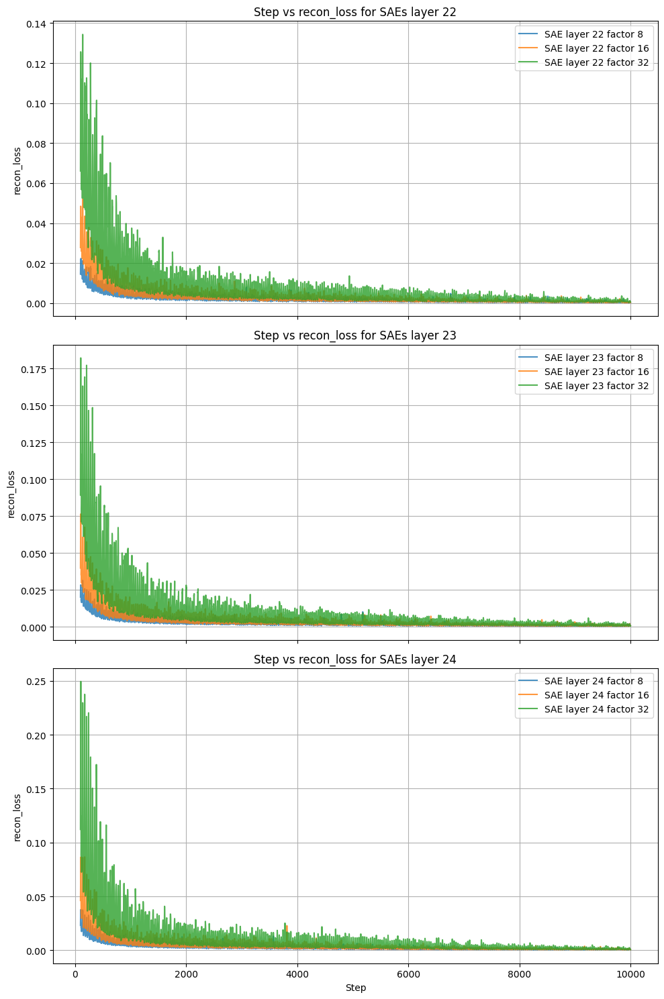

In [ ]:
import matplotlib.pyplot as plt

def plot_sae_loss(df_22x8, df_22x16, df_22x32, df_23x8, df_23x16, df_23x32, df_24x8, df_24x16, df_24x32, n=100, loss_col="recon_loss"):
    """
    Genera gráficos de 'Step vs Recon Loss' para diferentes configuraciones de SAE.

    Parámetros:
        df_22x8, df_22x16, df_22x32: DataFrames para SAE de 22 capas con diferentes factores.
        df_23x8, df_23x16, df_23x32: DataFrames para SAE de 23 capas con diferentes factores.
        n: Paso mínimo a considerar en los gráficos.
        loss_col: Nombre de la columna que contiene la pérdida reconstructiva.
    """
    fig, axes = plt.subplots(3, 1, figsize=(10, 15), sharex=True)


    axes[0].plot(df_22x8[df_22x8["Step"] >= n]["Step"], df_22x8[df_22x8["Step"] >= n][loss_col], label="SAE layer 22 factor 8", alpha=0.8)
    axes[0].plot(df_22x16[df_22x16["Step"] >= n]["Step"], df_22x16[df_22x16["Step"] >= n][loss_col], label="SAE layer 22 factor 16", alpha=0.8)
    axes[0].plot(df_22x32[df_22x32["Step"] >= n]["Step"], df_22x32[df_22x32["Step"] >= n][loss_col], label="SAE layer 22 factor 32", alpha=0.8)
    axes[0].set_ylabel(loss_col)
    axes[0].set_title(f"Step vs {loss_col} for SAEs layer 22")
    axes[0].legend()
    axes[0].grid()


    axes[1].plot(df_23x8[df_23x8["Step"] >= n]["Step"], df_23x8[df_23x8["Step"] >= n][loss_col], label="SAE layer 23 factor 8", alpha=0.8)
    axes[1].plot(df_23x16[df_23x16["Step"] >= n]["Step"], df_23x16[df_23x16["Step"] >= n][loss_col], label="SAE layer 23 factor 16", alpha=0.8)
    axes[1].plot(df_23x32[df_23x32["Step"] >= n]["Step"], df_23x32[df_23x32["Step"] >= n][loss_col], label="SAE layer 23 factor 32", alpha=0.8)
    axes[1].set_ylabel(loss_col)
    axes[1].set_title(f"Step vs {loss_col} for SAEs layer 23")
    axes[1].legend()
    axes[1].grid()


    axes[2].plot(df_24x8[df_24x8["Step"] >= n]["Step"], df_24x8[df_24x8["Step"] >= n][loss_col], label="SAE layer 24 factor 8", alpha=0.8)
    axes[2].plot(df_24x16[df_24x16["Step"] >= n]["Step"], df_24x16[df_24x16["Step"] >= n][loss_col], label="SAE layer 24 factor 16", alpha=0.8)
    axes[2].plot(df_24x32[df_24x32["Step"] >= n]["Step"], df_24x32[df_24x32["Step"] >= n][loss_col], label="SAE layer 24 factor 32", alpha=0.8)
    axes[2].set_xlabel("Step")
    axes[2].set_ylabel(loss_col)
    axes[2].set_title(f"Step vs {loss_col} for SAEs layer 24")
    axes[2].legend()
    axes[2].grid()



    plt.tight_layout()
    plt.show()

plot_sae_loss(df_22x8, df_22x16, df_22x32, df_23x8, df_23x16, df_23x32, df_24x8, df_24x16, df_24x32, n=100, loss_col="recon_loss")


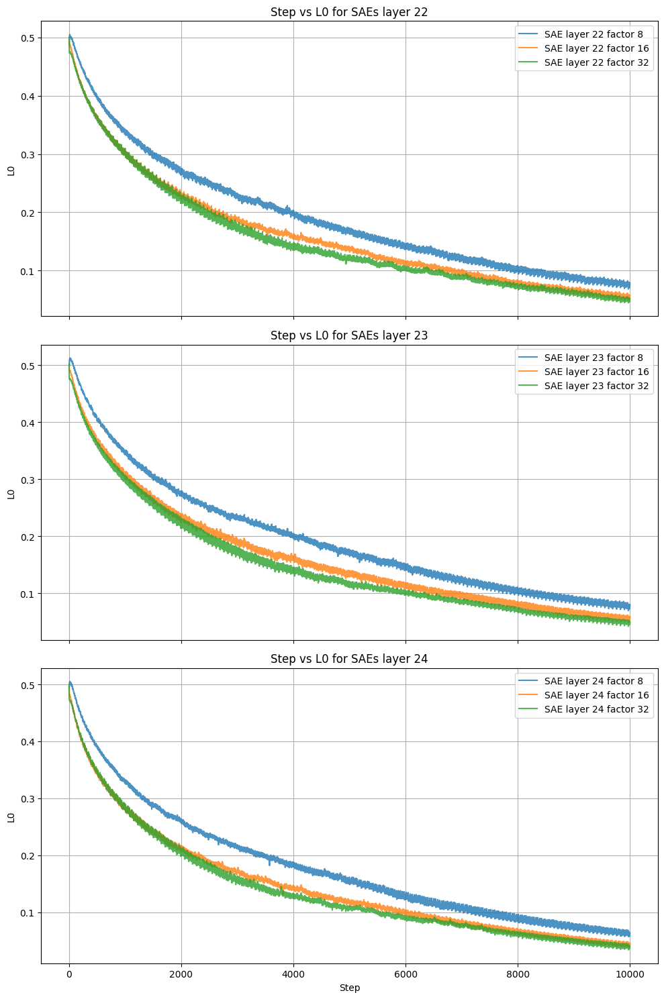

In [ ]:
plot_sae_loss(df_22x8, df_22x16, df_22x32, df_23x8, df_23x16, df_23x32, df_24x8, df_24x16, df_24x32, n=0, loss_col="L0")


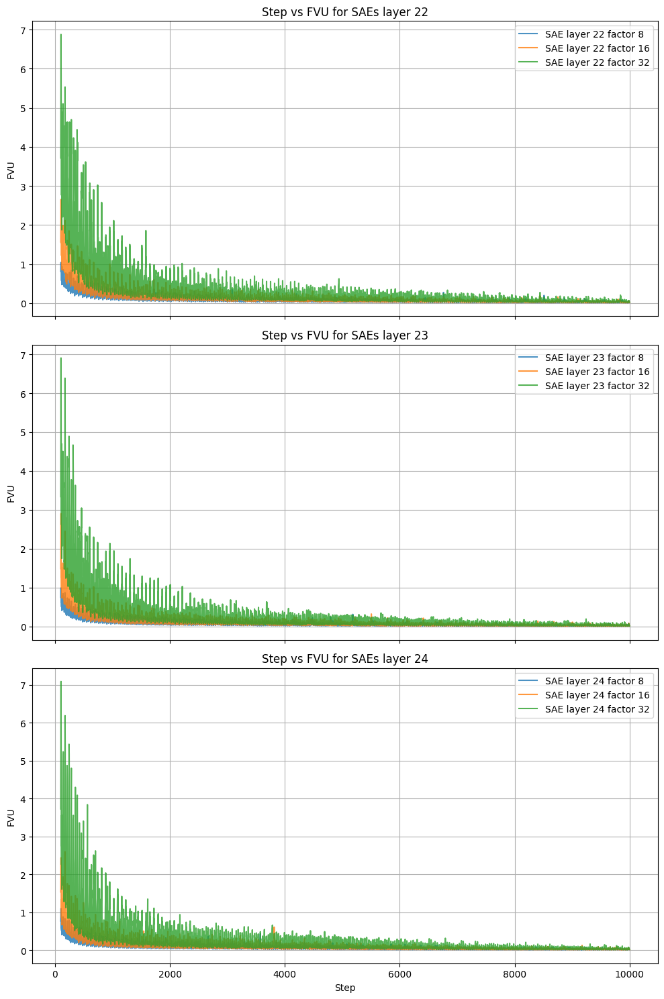

In [ ]:
plot_sae_loss(df_22x8, df_22x16, df_22x32, df_23x8, df_23x16, df_23x32, df_24x8, df_24x16, df_24x32, n=100, loss_col="FVU")


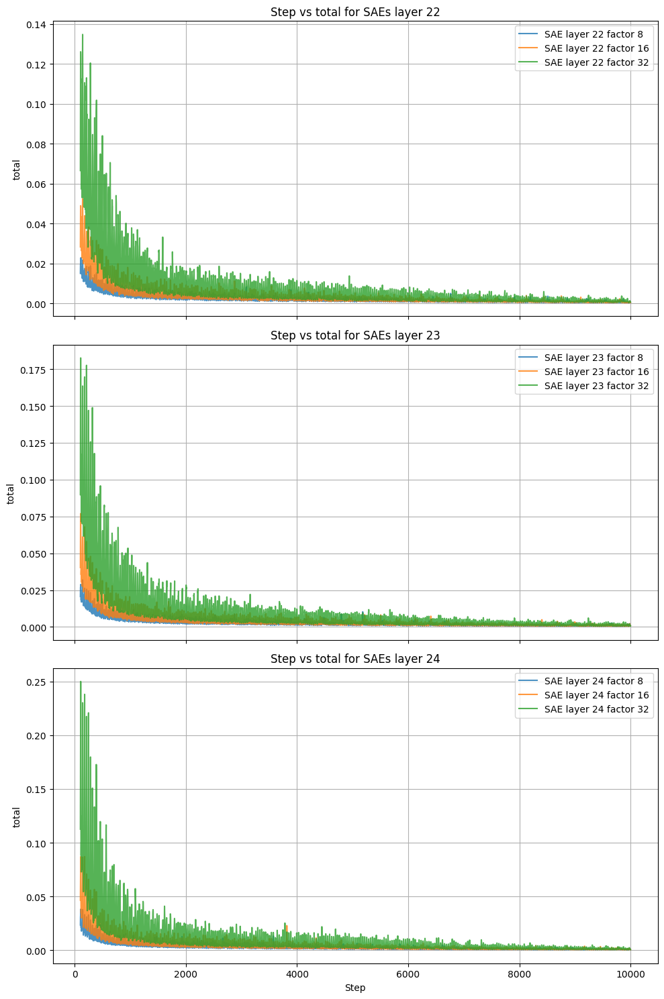

In [ ]:
plot_sae_loss(df_22x8, df_22x16, df_22x32, df_23x8, df_23x16, df_23x32, df_24x8, df_24x16, df_24x32, n=100, loss_col="total")


### **Sparsity vs Fidelity**

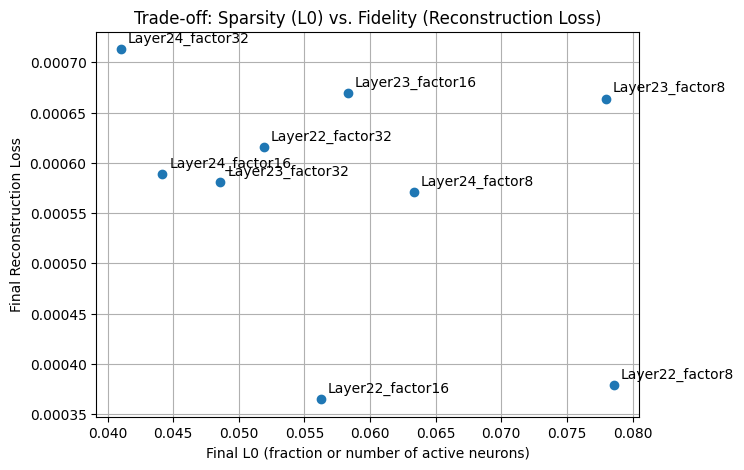

In [ ]:
results = [
    ("Layer22_factor8",  df_22x8.iloc[-1]['L0'], df_22x8.iloc[-1]['recon_loss']),
    ("Layer22_factor16", df_22x16.iloc[-1]['L0'], df_22x16.iloc[-1]['recon_loss']),
    ("Layer22_factor32", df_22x32.iloc[-1]['L0'], df_22x32.iloc[-1]['recon_loss']),
    ("Layer23_factor8",  df_23x8.iloc[-1]['L0'], df_23x8.iloc[-1]['recon_loss']),
    ("Layer23_factor16", df_23x16.iloc[-1]['L0'], df_23x16.iloc[-1]['recon_loss']),
    ("Layer23_factor32", df_23x32.iloc[-1]['L0'], df_23x32.iloc[-1]['recon_loss']),
    ("Layer24_factor8",  df_24x8.iloc[-1]['L0'], df_24x8.iloc[-1]['recon_loss']),
    ("Layer24_factor16", df_24x16.iloc[-1]['L0'], df_24x16.iloc[-1]['recon_loss']),
    ("Layer24_factor32", df_24x32.iloc[-1]['L0'], df_24x32.iloc[-1]['recon_loss']),
]

# Extraer x (L0) e y (recon_loss) y labels
x_vals = [r[1] for r in results]  # L0
y_vals = [r[2] for r in results]  # recon_loss
labels = [r[0] for r in results]

plt.figure(figsize=(7,5))
plt.scatter(x_vals, y_vals)

# Opcional: anotar los puntos con su label (capa/factor)
for label, x, y in zip(labels, x_vals, y_vals):
    plt.annotate(label, (x, y), textcoords="offset points", xytext=(5,5))

plt.xlabel("Final L0 (fraction or number of active neurons)")
plt.ylabel("Final Reconstruction Loss")
plt.title("Trade-off: Sparsity (L0) vs. Fidelity (Reconstruction Loss)")

plt.grid(True)
plt.show()





### **Final values**

In [ ]:
import pandas as pd
all_dfs = {
    "Layer22_factor8": df_22x8,
    "Layer22_factor16": df_22x16,
    "Layer22_factor32": df_22x32,
    "Layer23_factor8": df_23x8,
    "Layer23_factor16": df_23x16,
    "Layer23_factor32": df_23x32,
    "Layer24_factor8": df_24x8,
    "Layer24_factor16": df_24x16,
    "Layer24_factor32": df_24x32,
}

# 2) Recorremos cada DF, extraemos la fila final y registramos los valores
summary_rows = []

for config_name, df in all_dfs.items():
    # Extraer la última fila: df.iloc[-1]
    # (o también df[df["Step"] == 10000].iloc[0] si quieres asegurar Step=10000)
    final_row = df.iloc[-1]

    # parsear la info "Layer22_factor8" -> Layer=22, factor=8
    # un approach rápido:
    layer_str = config_name.split("_")[0]   # "Layer22"
    factor_str = config_name.split("_")[1]  # "factor8"
    layer_num = layer_str.replace("Layer","")        # "22"
    factor_num = factor_str.replace("factor","")     # "8"

    summary_rows.append({
        "Layer": layer_num,
        "Factor": factor_num,
        "Final Step": final_row["Step"],
        "Recon Loss": final_row["recon_loss"],
        "L0": final_row["L0"],
        "FVU": final_row["FVU"],
        "Total": final_row["total"]
    })

# 3) Crear un DataFrame con esos resúmenes
summary_df = pd.DataFrame(summary_rows)

# Opcional: ordenar por layer y factor
summary_df = summary_df.sort_values(by=["Layer","Factor"])

# 4) Mostrar
print(summary_df)


  Layer Factor  Final Step  Recon Loss        L0       FVU     Total
1    22     16     10000.0    0.000365  0.056236  0.014365  0.000421
2    22     32     10000.0    0.000616  0.051922  0.024245  0.000668
0    22      8     10000.0    0.000379  0.078598  0.014912  0.000457
4    23     16     10000.0    0.000669  0.058304  0.018721  0.000727
5    23     32     10000.0    0.000581  0.048595  0.016264  0.000630
3    23      8     10000.0    0.000664  0.077942  0.018580  0.000742
7    24     16     10000.0    0.000589  0.044174  0.014702  0.000633
8    24     32     10000.0    0.000713  0.041019  0.017796  0.000754
6    24      8     10000.0    0.000571  0.063339  0.014251  0.000634


### **Histrogram of activation**

In [ ]:
def hist_activ(df, layer):
    # Convert body_state to binary labels
    labels = np.array([1 if state == "O" else 0 for state in df["body_state"]])  # 1: bra, 0: no bra

    # Load .npy files
    H_list = []
    for file_path in df[layer]:
        if os.path.exists(file_path):
            H_list.append(np.load(file_path))
        else:
            print(f"File not found: {file_path}")

    if not H_list:
        return None, None  # Return None if H_list is empty

    # Convert H_list to numpy array (assuming all elements have the same shape)
    H_array = np.array(H_list)  # Shape: (num_samples, num_features)

    # Partition by labels
    H_bra = H_array[labels == 1]  # Subset where label == 1
    H_no_bra = H_array[labels == 0]  # Subset where label == 0

    # Compute column-wise mean
    mean_global = np.mean(H_array, axis=0)
    mean_bra = np.mean(H_bra, axis=0) if len(H_bra) > 0 else None
    mean_no_bra = np.mean(H_no_bra, axis=0) if len(H_no_bra) > 0 else None

    return mean_bra, mean_no_bra, mean_global, H_bra, H_no_bra, H_array


In [ ]:
def plot_transformed_histograms(mean_bra, mean_no_bra, mean_global, layer, factor):
    """
    Plots transformed histograms for neuron activations, ensuring correct visualization.

    X-axis: Neuron index (1 to 8192)
    Y-axis: Average activation (transformed)

    Parameters:
        mean_bra (numpy array): Mean activations for samples where label == 1
        mean_no_bra (numpy array): Mean activations for samples where label == 0
        mean_global (numpy array): Mean activations for all samples combined
    """
    # Ensure inputs are 1D arrays
    mean_bra = mean_bra.ravel() if mean_bra is not None else np.array([])
    mean_no_bra = mean_no_bra.ravel() if mean_no_bra is not None else np.array([])
    mean_global = mean_global.ravel() if mean_global is not None else np.array([])
    difference = mean_bra - mean_no_bra
    difference[difference < 0] = 0


    # Apply log transformation to handle large variations in activation values
    mean_bra_log = np.log1p(mean_bra)
    mean_no_bra_log = np.log1p(mean_no_bra)
    mean_global_log = np.log1p(mean_global)
    difference_log = np.log1p(difference)

    neuron_indices = np.arange(1, len(mean_bra) + 1)  # Neuron indices from 1 to 8192

    plt.figure(figsize=(20, 12))

    info = f' Factor {factor} - layer {layer}'

    # Plot mean_bra activations
    plt.subplot(2, 2, 1)
    plt.bar(neuron_indices, mean_bra_log, color='blue', alpha=0.7)
    plt.title("Transformed Activations (mean_bra)"+info)
    plt.xlabel("Neuron Index")
    plt.ylabel("log(1 + Activation)")

    # Plot mean_no_bra activations
    plt.subplot(2, 2, 2)
    plt.bar(neuron_indices, mean_no_bra_log, color='red', alpha=0.7)
    plt.title("Transformed Activations (mean_no_bra)"+info)
    plt.xlabel("Neuron Index")
    plt.ylabel("log(1 + Activation)")

    # Plot mean_global activations
    plt.subplot(2, 2, 3)
    plt.bar(neuron_indices, mean_global_log, color='green', alpha=0.7)
    plt.title("Transformed Activations (mean_global)"+info)
    plt.xlabel("Neuron Index")
    plt.ylabel("log(1 + Activation)")

    # Plot transformed difference
    plt.subplot(2, 2, 4)
    plt.bar(neuron_indices, difference_log, color='purple', alpha=0.7)
    plt.title("Transformed Difference: mean_bra - mean_no_bra (Clipped at 0)"+info)
    plt.xlabel("Neuron Index")
    plt.ylabel("log(1 + Difference)")

    plt.tight_layout()
    plt.show()

### SAE X8

In [ ]:
path_json_layer= "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/latens_activation/data_extraction_without_intervene.json"
df_layers = pd.read_json(path_json_layer)
factor = 'x8'

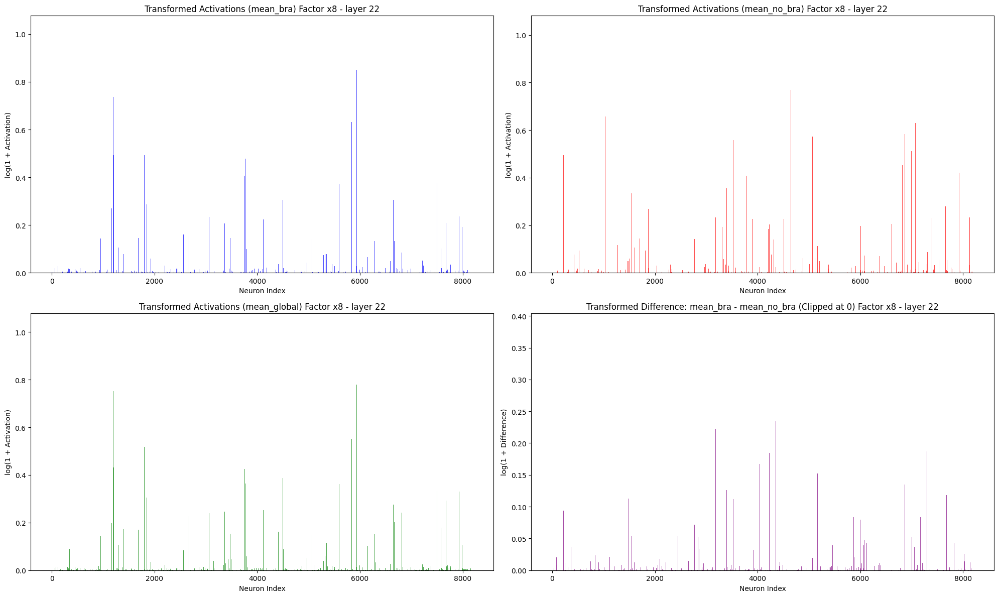

In [ ]:
layer = '22'
mean_bra_22_8, mean_no_bra_22_8, mean_global_22_8, H_bra_22_8, H_no_bra_22_8, H_array_22_8 = hist_activ(df_layers,'layer_22_file_path')
plot_transformed_histograms(mean_bra_22_8, mean_no_bra_22_8, mean_global_22_8,layer, factor)

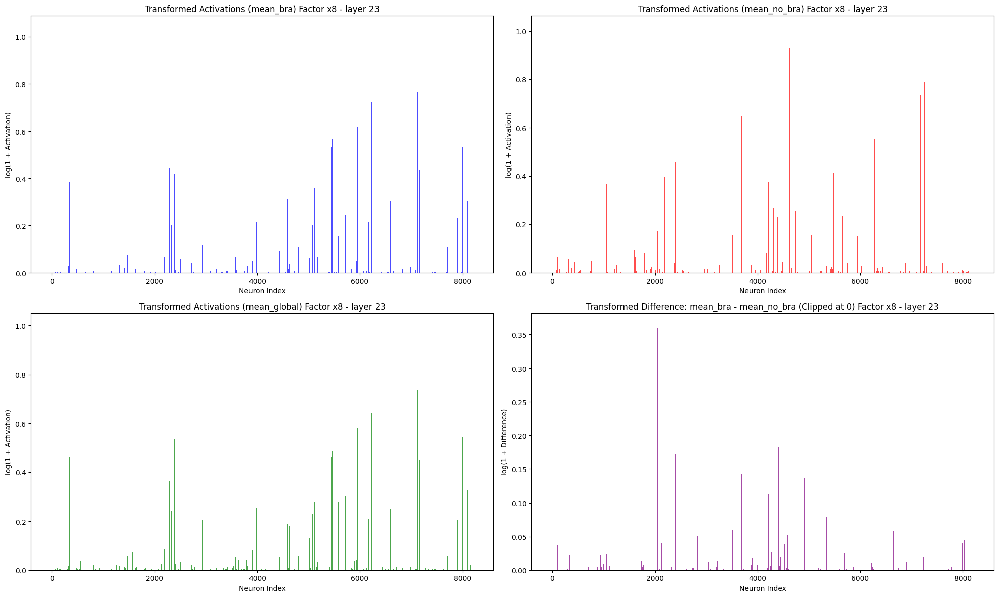

In [ ]:
layer = '23'
mean_bra_23_8, mean_no_bra_23_8, mean_global_23_8, H_bra_23_8, H_no_bra_23_8, H_array_23_8 = hist_activ(df_layers,'layer_23_file_path')
plot_transformed_histograms(mean_bra_23_8, mean_no_bra_23_8, mean_global_23_8,layer, factor)

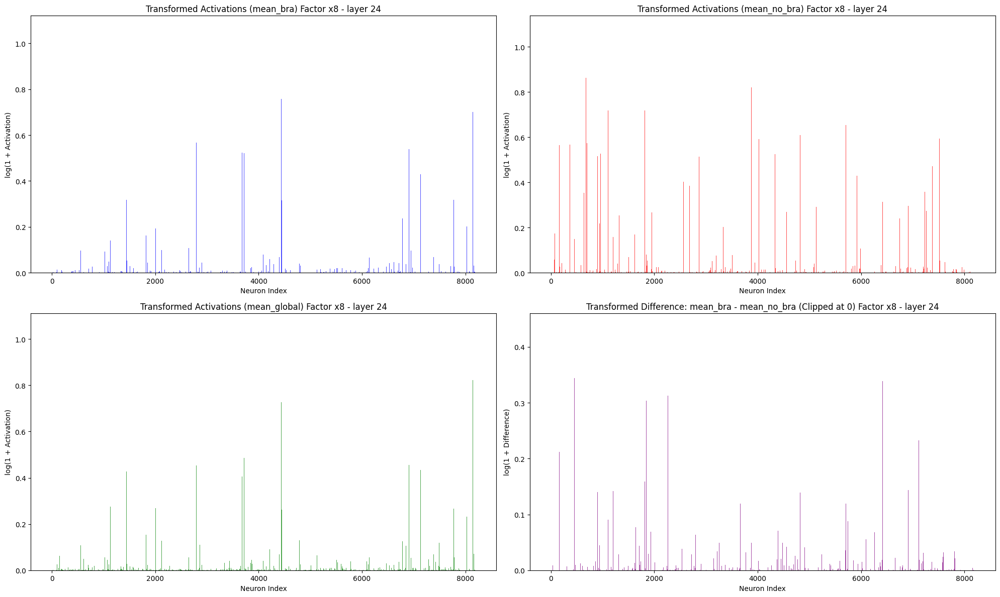

In [ ]:
layer = '24'
mean_bra_24_8, mean_no_bra_24_8, mean_global_24_8, H_bra_24_8, H_no_bra_24_8, H_array_24_8 = hist_activ(df_layers,'layer_24_file_path')
plot_transformed_histograms(mean_bra_24_8, mean_no_bra_24_8, mean_global_24_8,layer, factor)

### SAE X16

In [ ]:
path_json_layer= "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/latens_activation/data_extraction_without_intervene.json"
df_layers = pd.read_json(path_json_layer)
factor='16'

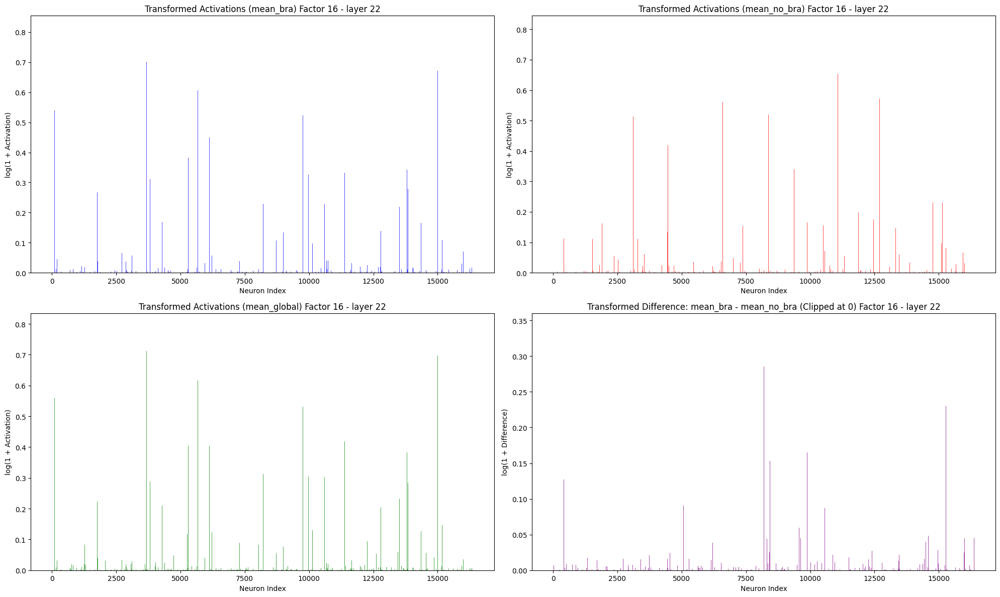

In [ ]:
layer = '22'
mean_bra_22_16, mean_no_bra_22_16, mean_global_22_16, H_bra_22_16, H_no_bra_22_16, H_array_22_16 = hist_activ(df_layers,'layer_22_file_path')
plot_transformed_histograms(mean_bra_22_16, mean_no_bra_22_16, mean_global_22_16,layer, factor)

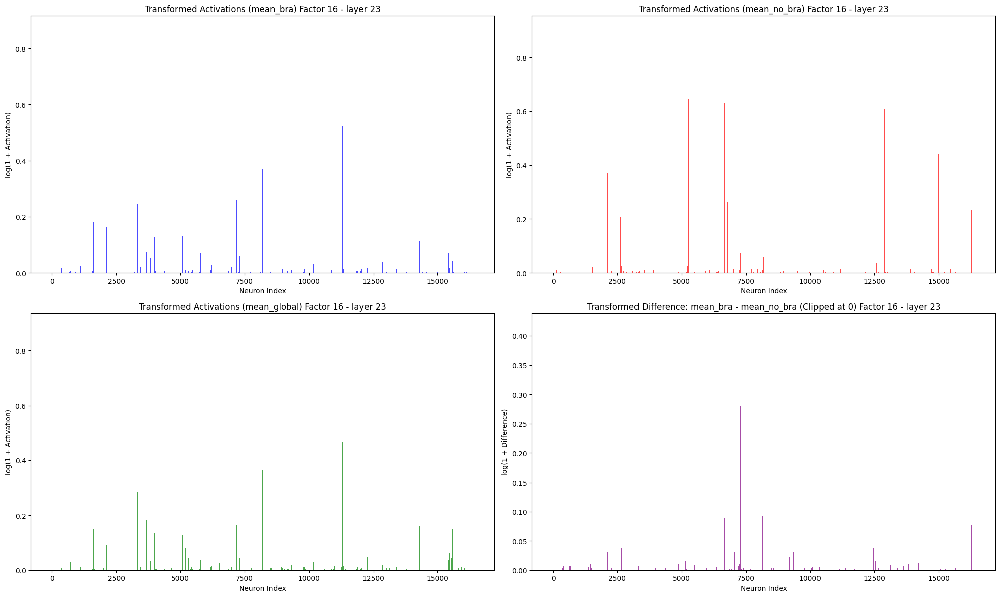

In [ ]:
layer = '23'
mean_bra_23_16, mean_no_bra_23_16, mean_global_23_16, H_bra_23_16, H_no_bra_23_16, H_array_23_16 = hist_activ(df_layers,'layer_23_file_path')
plot_transformed_histograms(mean_bra_23_16, mean_no_bra_23_16, mean_global_23_16,layer, factor)

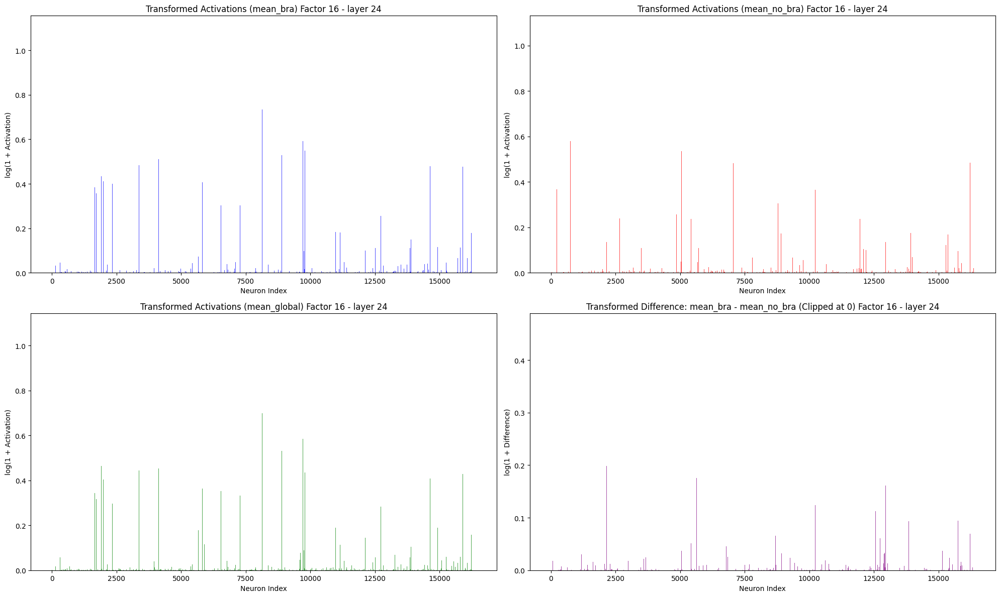

In [ ]:
layer = '24'
mean_bra_24_16, mean_no_bra_24_16, mean_global_24_16, H_bra_24_16, H_no_bra_24_16, H_array_24_16 = hist_activ(df_layers,'layer_24_file_path')
plot_transformed_histograms(mean_bra_24_16, mean_no_bra_24_16, mean_global_24_16,layer, factor)

### SAE X32

In [ ]:
path_json_layer= "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/latens_activation/data_extraction_without_intervene.json"
df_layers = pd.read_json(path_json_layer)
factor='32'

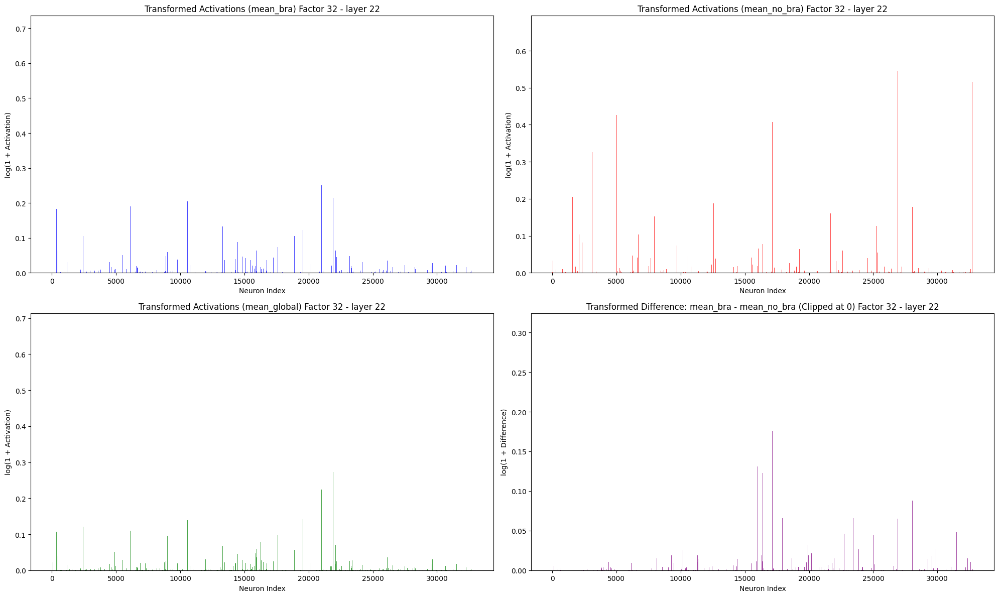

In [ ]:
layer = '22'
mean_bra_22_32, mean_no_bra_22_32, mean_global_22_32, H_bra_22_32, H_no_bra_22_32, H_array_22_32 = hist_activ(df_layers,'layer_22_file_path')
plot_transformed_histograms(mean_bra_22_32, mean_no_bra_22_32, mean_global_22_32,layer, factor)

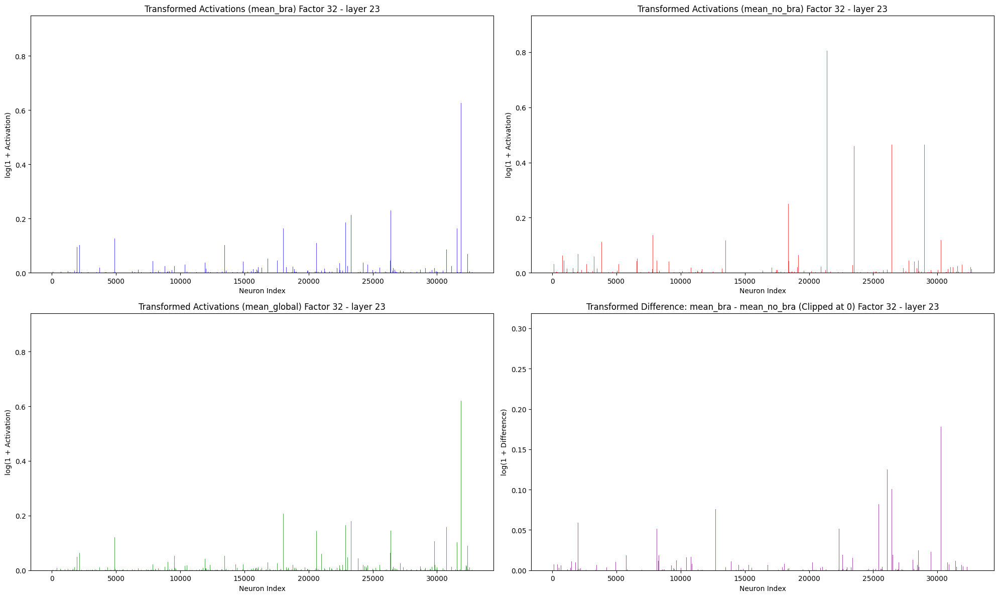

In [ ]:
layer = '23'
mean_bra_23_32, mean_no_bra_23_32, mean_global_23_32, H_bra_23_32, H_no_bra_23_32, H_array_23_32 = hist_activ(df_layers,'layer_23_file_path')
plot_transformed_histograms(mean_bra_23_32, mean_no_bra_23_32, mean_global_23_32,layer, factor)

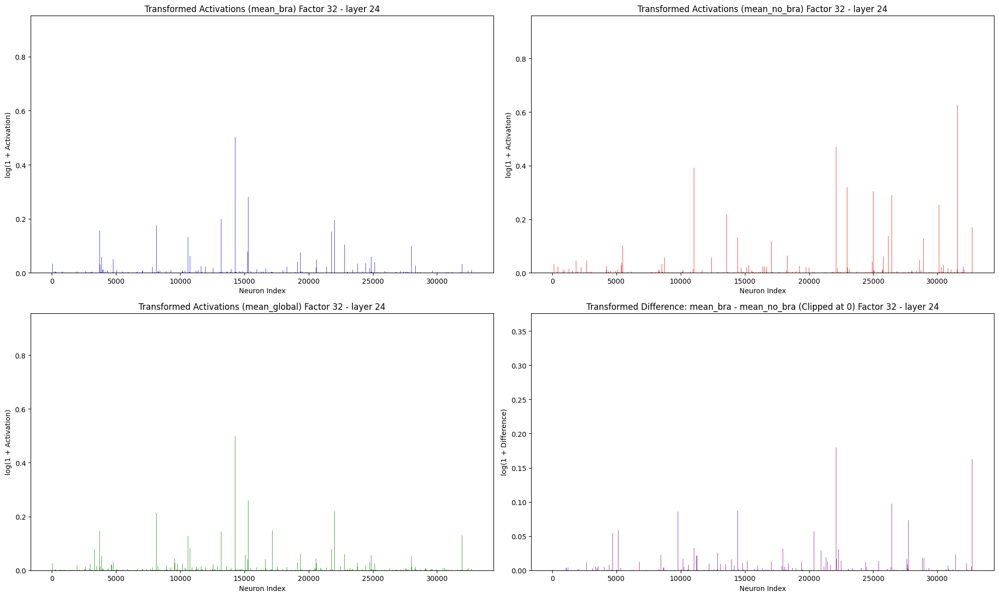

In [ ]:
layer = '24'
mean_bra_24_32, mean_no_bra_24_32, mean_global_24_32, H_bra_24_32, H_no_bra_24_32, H_array_24_32 = hist_activ(df_layers,'layer_24_file_path')
plot_transformed_histograms(mean_bra_24_32, mean_no_bra_24_32, mean_global_24_32,layer, factor)

In [ ]:
sl

### **Layer selection**

In [ ]:
from scipy.stats import mannwhitneyu
import numpy as np
from scipy.stats import shapiro, ks_2samp
from scipy.stats import mannwhitneyu, ks_2samp
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
means_bra_no_bra_l_f = [[mean_bra_22_8,mean_no_bra_22_8],
                        [mean_bra_23_8,mean_no_bra_23_8],
                        [mean_bra_24_8,mean_no_bra_24_8],
                        [mean_bra_22_16,mean_no_bra_22_16],
                        [mean_bra_23_16,mean_no_bra_23_16],
                        [mean_bra_24_16,mean_no_bra_24_16],
                        [mean_bra_22_32,mean_no_bra_22_32],
                        [mean_bra_23_32,mean_no_bra_23_32],
                        [mean_bra_24_32,mean_no_bra_24_32],]


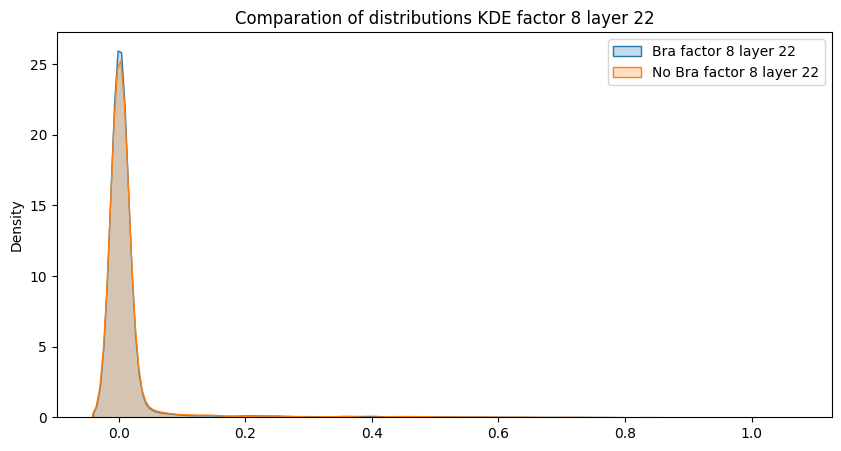

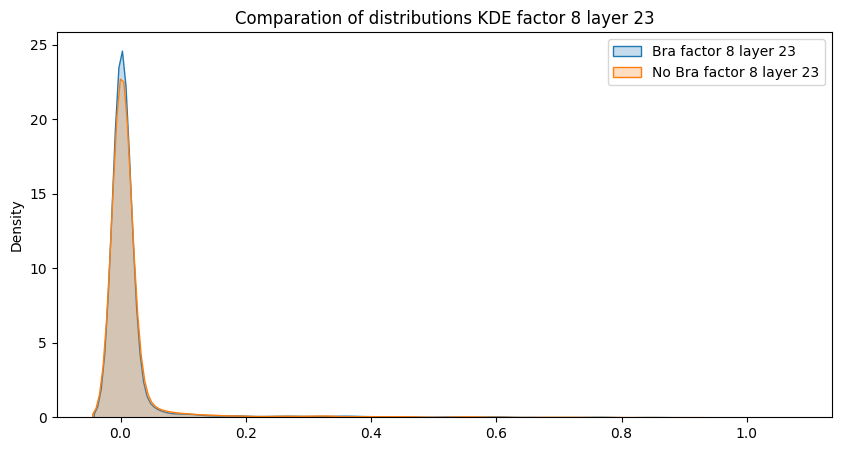

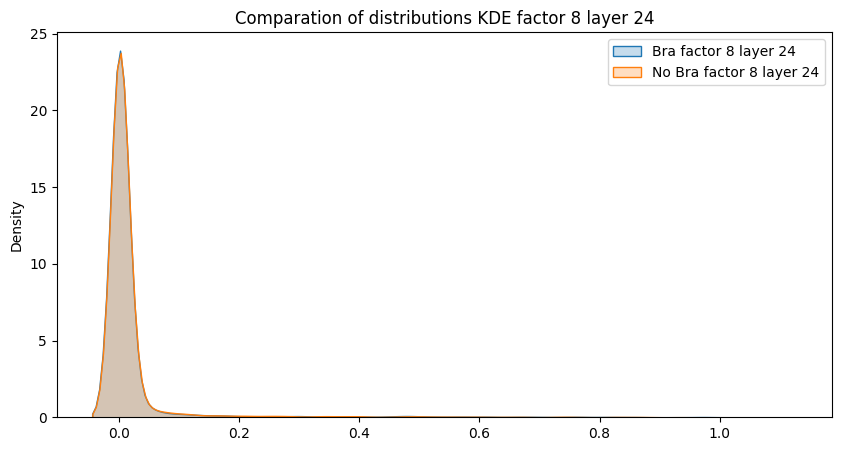

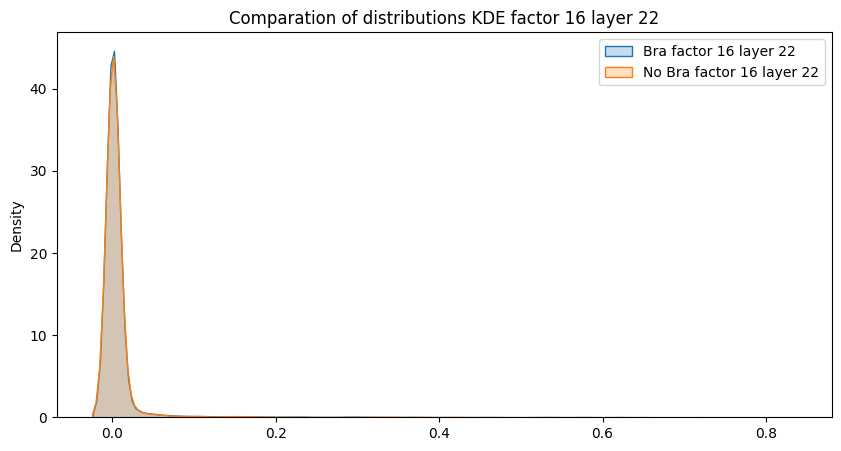

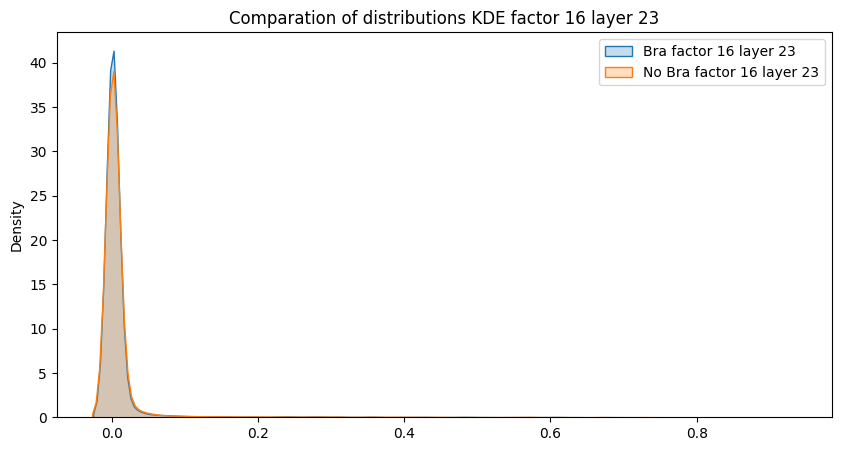

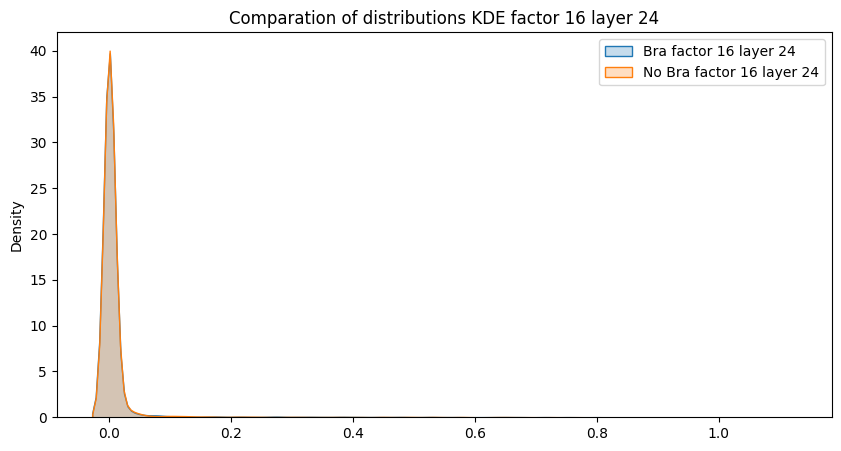

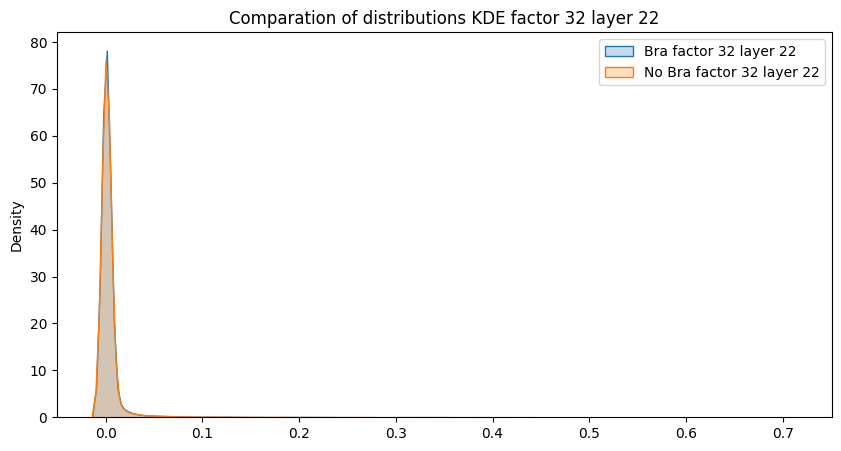

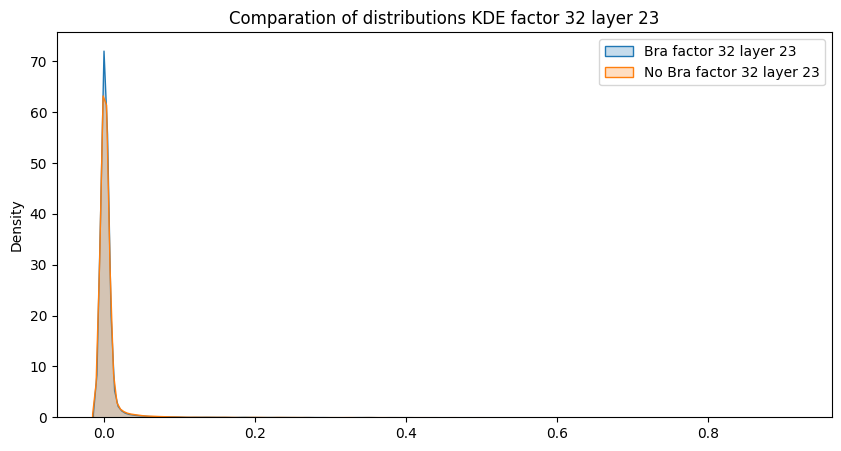

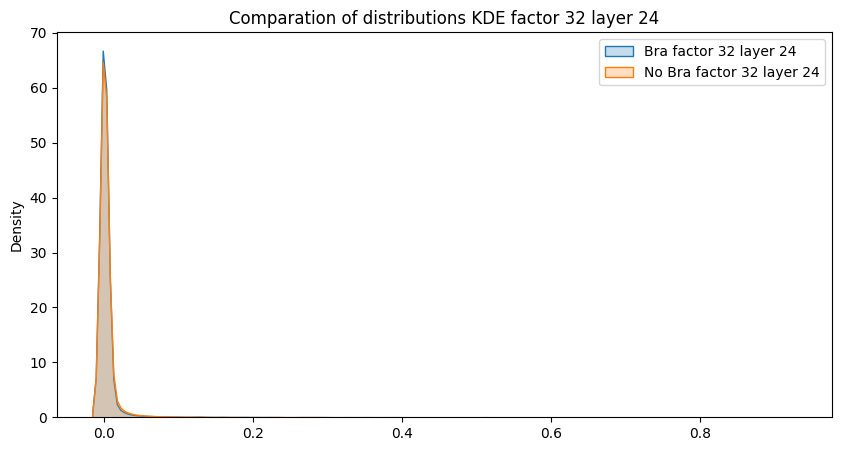

In [ ]:
lays =['22','23','24']
facs = ['8','16','32']
coun = 0
for i in facs:

  for j in lays:
    plt.figure(figsize=(10,5))
    sns.kdeplot(np.log1p(means_bra_no_bra_l_f[coun][0].flatten()), label=f'Bra factor {i} layer {j}', fill=True)
    sns.kdeplot(np.log1p(means_bra_no_bra_l_f[coun][1].flatten()), label=f'No Bra factor {i} layer {j}', fill=True)
    plt.legend()
    plt.title(f"Comparation of distributions KDE factor {i} layer {j}")
    plt.show()
    coun +=1


Test Shapiro-Wilk

In [ ]:
coun=0
for i in facs:
  for j in lays:

    stat1, p1 = shapiro(np.log1p(means_bra_no_bra_l_f[coun][0].flatten()))
    stat2, p2 = shapiro(np.log1p(means_bra_no_bra_l_f[coun][1].flatten()))

    print('')
    print('------------------------------------------------------------------')

    print(f'Norm Bra factor {i} layer {j},  p = {p1}')
    print(f'Norm No Bra factor {i} layer {j}, p = {p2}')

    if p1 > 0.05 and p2 > 0.05:
      print("Both groups could be normal (use t-test instead of Mann–Whitney).")
    else:
      print("The data do not appear normal (continue with nonparametric tests).")

    print('------------------------------------------------------------------')
    print('')
    coun +=1



------------------------------------------------------------------
Norm Bra factor 8 layer 22,  p = 2.054813003646684e-102
Norm No Bra factor 8 layer 22, p = 2.802113804823485e-102
The data do not appear normal (continue with nonparametric tests).
------------------------------------------------------------------


------------------------------------------------------------------
Norm Bra factor 8 layer 23,  p = 3.111849638104202e-102
Norm No Bra factor 8 layer 23, p = 7.850516697324561e-102
The data do not appear normal (continue with nonparametric tests).
------------------------------------------------------------------


------------------------------------------------------------------
Norm Bra factor 8 layer 24,  p = 4.623523366863628e-103
Norm No Bra factor 8 layer 24, p = 1.1732574361262864e-102
The data do not appear normal (continue with nonparametric tests).
------------------------------------------------------------------


-----------------------------------------------

/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 8192.
  res = hypotest_fun_out(*samples, **kwds)
/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 16384.
  res = hypotest_fun_out(*samples, **kwds)
/usr/local/lib/python3.11/dist-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 32768.
  res = hypotest_fun_out(*samples, **kwds)


Mann–Whitney and KS-Test

In [ ]:
table_mwks = []
coun = 0
for i in facs:
  for j in lays:

    # Mann–Whitney U test
    stat_mw, p_mw = mannwhitneyu(np.log1p(means_bra_no_bra_l_f[coun][0].flatten()), np.log1p(means_bra_no_bra_l_f[coun][1].flatten()), alternative='two-sided')

    # Kolmogorov-Smirnov Test
    stat_ks, p_ks = ks_2samp(np.log1p(means_bra_no_bra_l_f[coun][0].flatten()), np.log1p(means_bra_no_bra_l_f[coun][1].flatten()))

    print('')
    print('------------------------------------------------------------------')

    print(f'For factor {i} in layer {j}')
    print(f'Mann–Whitney U Test: p = {p_mw}')
    print(f'Kolmogorov-Smirnov Test: p = {p_ks}')

    if p_mw < 0.05:
        print("Mann–Whitney suggests that the groups are significantly different in their median.")
    if p_ks < 0.05:
        print("Kolmogorov-Smirnov suggests that the distributions of the groups are significantly different.")

    print('------------------------------------------------------------------')
    print('')
    table_mwks.append([i,j,p_mw,p_ks]
                      )
    coun +=1


df_mwks = pd.DataFrame(table_mwks, columns=['Factor','Layer','P-Value Mann','P-Value KS'])



------------------------------------------------------------------
For factor 8 in layer 22
Mann–Whitney U Test: p = 0.01207973098481583
Kolmogorov-Smirnov Test: p = 0.004876461726428956
Mann–Whitney suggests that the groups are significantly different in their median.
Kolmogorov-Smirnov suggests that the distributions of the groups are significantly different.
------------------------------------------------------------------


------------------------------------------------------------------
For factor 8 in layer 23
Mann–Whitney U Test: p = 0.5562772966405998
Kolmogorov-Smirnov Test: p = 0.01590470682846025
Kolmogorov-Smirnov suggests that the distributions of the groups are significantly different.
------------------------------------------------------------------


------------------------------------------------------------------
For factor 8 in layer 24
Mann–Whitney U Test: p = 0.055894895311565246
Kolmogorov-Smirnov Test: p = 0.0004586767843144955
Kolmogorov-Smirnov suggests t

In [ ]:
df_mwks

,Factor,Layer,P-Value Mann,P-Value KS
0,8,22,1.207973e-02,4.876462e-03
1,8,23,5.562773e-01,1.590471e-02
2,8,24,5.589490e-02,4.586768e-04
3,16,22,1.041592e-09,1.826376e-10
4,16,23,4.570977e-01,7.208009e-02
5,16,24,8.925771e-03,6.030629e-06
6,32,22,7.099602e-17,1.038326e-16
7,32,23,8.643934e-11,1.262699e-12
8,32,24,2.213508e-03,3.671749e-15


In [ ]:
def cliffs_delta(data1, data2):
    """
    Calculates Cliff's Delta between two datasets.
    """
    n1, n2 = len(data1), len(data2)
    greater = sum([1 for x in data1 for y in data2 if x > y])
    lesser = sum([1 for x in data1 for y in data2 if x < y])
    delta = (greater - lesser) / (n1 * n2)
    return delta


coun = 0
for i in facs:
  for j in lays:

      # Replace these with your actual data
      data_bra = np.log1p(means_bra_no_bra_l_f[coun][0].flatten())
      data_no_bra = np.log1p(means_bra_no_bra_l_f[coun][1].flatten())
      # Mann–Whitney U Test
      stat, p = mannwhitneyu(data_bra, data_no_bra, alternative='two-sided')

      # Calculate effect size r
      n1, n2 = len(data_bra), len(data_no_bra)
      r = stat / (n1 * n2)

      # Calculate Cliff's Delta
      delta = cliffs_delta(data_bra, data_no_bra)

      # Print results
      print(f"Factor {i}, Layer {j}:")
      print(f"  Mann–Whitney U Test: p = {p}, r = {r}")
      print(f"  Cliff's Delta: δ = {delta}")
      print("-" * 50)
      coun += 1





Factor 8, Layer 22:
  Mann–Whitney U Test: p = 0.01207973098481583, r = 0.5097155049443245
  Cliff's Delta: δ = 0.019431009888648987
--------------------------------------------------
Factor 8, Layer 23:
  Mann–Whitney U Test: p = 0.5562772966405998, r = 0.5022999122738838
  Cliff's Delta: δ = 0.004599824547767639
--------------------------------------------------
Factor 8, Layer 24:
  Mann–Whitney U Test: p = 0.055894895311565246, r = 0.4924074411392212
  Cliff's Delta: δ = -0.015185117721557617
--------------------------------------------------
Factor 16, Layer 22:
  Mann–Whitney U Test: p = 1.041591835149649e-09, r = 0.5159490276128054
  Cliff's Delta: δ = 0.03189805522561073
--------------------------------------------------
Factor 16, Layer 23:
  Mann–Whitney U Test: p = 0.4570977309476594, r = 0.5019780211150646
  Cliff's Delta: δ = 0.003956042230129242
--------------------------------------------------
Factor 16, Layer 24:
  Mann–Whitney U Test: p = 0.008925770690997368, r = 0.4

∣δ∣≈0.1: Tamaño del efecto pequeño.

∣δ∣≈0.3: Tamaño del efecto moderado.

∣δ∣≈0.5: Tamaño del efecto grande.

### **Laten space and PCA**

### SAE X8

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
CLIP_SAE = CustomCLIPVisionModel(dir_sae_hf='22_resid/1200013184.pt',layer_sae='22').to(device)
CLIP_SAE.eval()
preprocess_text_img = CLIPProcessor.from_pretrained("laion/CLIP-ViT-L-14-laion2B-s32B-b82K")


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_token.py:90: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:
n=8

state_dict_22_x8 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/weights_layer22.pth')
sae_22_x8 = JumpReluSAE(1024,1024*n)
sae_22_x8.load_state_dict(state_dict_22_x8, strict=False)
sae_22_x8 = sae_22_x8.to(device)

state_dict_23_x8 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/weights_layer23.pth')
sae_23_x8 = JumpReluSAE(1024,1024*n)
sae_23_x8.load_state_dict(state_dict_23_x8, strict=False)
sae_23_x8 = sae_23_x8.to(device)

state_dict_24_x8 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/weights_layer24.pth')
sae_24_x8 = JumpReluSAE(1024,1024*n)
sae_24_x8.load_state_dict(state_dict_24_x8, strict=False)
sae_24_x8 = sae_24_x8.to(device)

SAEs = [sae_22_x8,sae_23_x8,sae_24_x8]

<ipython-input-25-19d7886020f5>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict_22_x8 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-App

In [ ]:


BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/"
laten_path = os.path.join(BASE_PATH, "latens_activation/")
output_json_path = os.path.join(BASE_PATH, "latens_activation/data_extraction_without_intervene.json")


# Load existing results or initialize a new list
if os.path.exists(output_json_path):
    with open(output_json_path, "r") as f:
        results = json.load(f)
    print(f"JSON found: Loaded {len(results)} previous results.")
else:
    results = []
    print("No previous JSON found. Initializing empty results.")


# Process dataset
for idx in range(0,281):
    img, mask_gt, prompt, state, img_name = dataset[idx]


    # Preprocess image and text
    preprocessed = preprocess_text_img(images=img, text=[prompt])
    img_preprocessed = torch.tensor(np.array(preprocessed['pixel_values'])).to(device)
    text_processed = torch.tensor(preprocessed['input_ids']).to(device)



    # Generate explanation using CLIP-SAE
    general_info = CLIP_SAE.forward(pixel_values=img_preprocessed,
                                    text_values = text_processed,
                                    n=25,
                                    intervene_layer_sae=22,
                                    SAEs=SAEs,
                                    data_extraction=True,
                                    intervene_laten_vector=None)

    name = os.path.splitext(img_name)[0]

    #Layer_22
    laten_layer_22  = general_info['data_extraction_laten'][0].detach().cpu().numpy()
    cos_layer_22 = general_info['cos_reconstruction_laten'][0].detach().cpu().numpy()

    layer_22_file_path = os.path.join(f'{laten_path}/22/', f"{name}_laten_22.npy")
    np.save(layer_22_file_path, laten_layer_22)

    #Layer_23
    laten_layer_23  = general_info['data_extraction_laten'][1].detach().cpu().numpy()
    cos_layer_23 = general_info['cos_reconstruction_laten'][1].detach().cpu().numpy()

    layer_23_file_path = os.path.join(f'{laten_path}/23/', f"{name}_laten_23.npy")
    np.save(layer_23_file_path, laten_layer_23)

    #Layer_24
    laten_layer_24  = general_info['data_extraction_laten'][2].detach().cpu().numpy()
    cos_layer_24 = general_info['cos_reconstruction_laten'][2].detach().cpu().numpy()

    layer_24_file_path = os.path.join(f'{laten_path}/24/', f"{name}_laten_24.npy")
    np.save(layer_24_file_path, laten_layer_24)

    results.append({
        "image_name_url": img_name,
        "prompt": prompt,
        "body_state": state,
        "cosine_global":general_info['cos_reconstruction_constractive'].detach().cpu().item(),

        "layer_22_file_path":layer_22_file_path,
        "cos_layer_22": float(cos_layer_22),

        "layer_23_file_path":layer_23_file_path,
        "cos_layer_23": float(cos_layer_23),

        "layer_24_file_path":layer_24_file_path,
        "cos_layer_24": float(cos_layer_24),

        })

    # Save results to JSON
    with open(output_json_path, "w") as outfile:
        json.dump(results, outfile, indent=4)

    print(f"Processed index: {idx}")

No previous JSON found. Initializing empty results.


It looks like you are trying to rescale already rescaled images. If the input images have pixel values between 0 and 1, set `do_rescale=False` to avoid rescaling them again.


Coseno reconstru layer 21 tensor([0.9993], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9979], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9725], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2337], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 0


<ipython-input-26-8ef5d068c046>:67: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  "cos_layer_22": float(cos_layer_22),
<ipython-input-26-8ef5d068c046>:70: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  "cos_layer_23": float(cos_layer_23),
<ipython-input-26-8ef5d068c046>:73: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  "cos_layer_24": float(cos_layer_24),


Coseno reconstru layer 21 tensor([0.9992], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9987], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9979], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2698], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 1
Coseno reconstru layer 21 tensor([0.9995], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9990], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9986], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2414], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 2
Coseno reconstru layer 21 tensor([0.9992], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9989], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9974], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2091], device='cuda:0', grad_fn=<SumBa

IndexError: list index out of range

In [ ]:
path_json_layer= "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_8/latens_activation/data_extraction_without_intervene.json"
df_layers = pd.read_json(path_json_layer)

In [ ]:
df_layers

,image_name_url,prompt,body_state,cosine_global,layer_22_file_path,cos_layer_22,layer_23_file_path,cos_layer_23,layer_24_file_path,cos_layer_24
0,7_NE_O_1_JPG.rf.bf04958fa6724ae2c5313b6e5a767d...,a photo of a person neutral,O,0.233731,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999324,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.997930,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.972484
1,6_AN2_NO_1_jpg.rf.aa23c117a2415de68e6684e68bae...,a photo of a person angry,NO,0.269782,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999211,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.998685,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.997850
2,1_SA2_O_1_jpg.rf.d30532db595d921ad4e6de0939a56...,a photo of a person sad,O,0.241403,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999481,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999040,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.998615
3,9_HA1_O_2_JPG.rf.d72fa78f8a0829e7f20ec7b7ea23d...,a photo of a person happy,O,0.209101,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999158,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.998917,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.997441
4,6_HA2_O_2_JPG.rf.3870fb93a1bbf4f6ccc5d7990fab0...,a photo of a person happy,O,0.215110,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999227,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.998173,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.997404
...,...,...,...,...,...,...,...,...,...,...
275,2_AN2_NO_1_JPG.rf.2d63fc98192b07f75ac6b79966f4...,a photo of a person angry,NO,0.259639,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999146,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.998517,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.996338
276,7_HA2_NO_1_JPG.rf.4073e843d2f8e9e74943b2462303...,a photo of a person happy,NO,0.221857,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999391,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.998884,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.998199
277,8_HA1_O_1_JPG.rf.5cbab2e1eedf0fa8c405f507b6bdd...,a photo of a person happy,O,0.209350,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999426,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999098,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.998935
278,5_HA1_O_2_JPG.rf.340006acfc62dbb570e55a38c79f3...,a photo of a person happy,O,0.217700,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.999452,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.998280,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.997798


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from matplotlib.colors import ListedColormap, to_rgba
import matplotlib.cm as cm
import os

def analyze_clusters(df,layer, pca_components=2, cluster_range=(2, 10), cmap_points=None):
    """
    Function to perform cluster analysis using PCA and K-Means.

    Args:
        df (pd.DataFrame): DataFrame containing file paths and labels.
        pca_components (int): Number of principal components for PCA.
        cluster_range (tuple): Range of clusters to test for K-Means (min, max).
        cmap_points (list): Colors for the points based on true labels. Default is None.

    Returns:
        None: Displays plots and results directly.
    """
    if cmap_points is None:
        cmap_points = ["blue", "red"]

    # Convert body_state to binary labels
    labels = np.array([1 if state == "O" else 0 for state in df["body_state"]])  # 1: bra, 0: no bra

    # Load .npy files
    H_list = []
    for file_path in df[layer]:
        if os.path.exists(file_path):
            H_list.append(np.load(file_path))
        else:
            print(f"File not found: {file_path}")

    # Check if data is loaded
    if H_list:
        H = np.vstack(H_list).astype(np.float64)  # Ensure data is float64

        # Apply PCA for dimensionality reduction
        pca = PCA(n_components=pca_components)
        h_2d = pca.fit_transform(H)

        # Evaluate different k values using the elbow method and silhouette score
        inertia = []
        silhouette_scores = []
        k_values = range(cluster_range[0], cluster_range[1])

        for k in k_values:
            kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
            cluster_labels = kmeans.fit_predict(h_2d)
            inertia.append(kmeans.inertia_)  # Store inertia (elbow method)
            silhouette_scores.append(silhouette_score(h_2d, cluster_labels))  # Silhouette Score

        # Plot the elbow method
        plt.figure(figsize=(8, 4))
        plt.plot(k_values, inertia, marker='o', linestyle='--', color='b', label="Inertia (Elbow Method)")
        plt.xlabel('Number of clusters (k)')
        plt.ylabel('Inertia')
        plt.title('Elbow Method to select k')
        plt.legend()
        plt.show()

        # Plot the silhouette score
        plt.figure(figsize=(8, 4))
        plt.plot(k_values, silhouette_scores, marker='o', linestyle='--', color='g', label="Silhouette Score")
        plt.xlabel('Number of clusters (k)')
        plt.ylabel('Silhouette Score')
        plt.title('Silhouette Score to select k')
        plt.legend()
        plt.show()

        # Select the best k based on the Silhouette Score (maximum value)
        best_k = k_values[np.argmax(silhouette_scores)]
        print(f"The best number of clusters based on the silhouette score is: {best_k}")

        # Apply K-Means with the best number of clusters
        kmeans = KMeans(n_clusters=best_k, random_state=42, n_init=10)
        cluster_labels = kmeans.fit_predict(h_2d.astype(np.float64))

        # Define plot limits
        x_min, x_max = h_2d[:, 0].min() - 0.5, h_2d[:, 0].max() + 0.5
        y_min, y_max = h_2d[:, 1].min() - 0.5, h_2d[:, 1].max() + 0.5

        # Create a mesh grid to predict cluster for each point
        xx, yy = np.meshgrid(np.linspace(x_min, x_max, 300),
                             np.linspace(y_min, y_max, 300))

        # Convert the mesh grid to float64 to avoid type errors
        grid_points = np.c_[xx.ravel(), yy.ravel()].astype(np.float64)

        # Predict clusters on the mesh grid
        Z = kmeans.predict(grid_points)
        Z = Z.reshape(xx.shape)

        # Generate a dynamic colormap for clusters
        dynamic_cmap = cm.get_cmap("tab10", best_k)
        cluster_colors = [to_rgba(dynamic_cmap(i)) for i in range(best_k)]
        cmap_background = ListedColormap(cluster_colors)

        # Create the plot with cluster regions
        plt.figure(figsize=(8, 6))
        plt.contourf(xx, yy, Z, cmap=cmap_background, alpha=0.3)  # Cluster regions

        # Plot the points with true labels
        plt.scatter(h_2d[labels == 0, 0], h_2d[labels == 0, 1], color=cmap_points[0], label='no bra')
        plt.scatter(h_2d[labels == 1, 0], h_2d[labels == 1, 1], color=cmap_points[1], label='bra')

        # Mark centroids
        centroids = kmeans.cluster_centers_
        plt.scatter(centroids[:, 0], centroids[:, 1], marker='X', s=200, color='black', label='Centroids')

        plt.legend()
        plt.title('Cluster Regions with K-Means and PCA')
        plt.xlabel('Principal Component 1')
        plt.ylabel('Principal Component 2')
        plt.show()

    else:
        print("No valid .npy files found to process.")


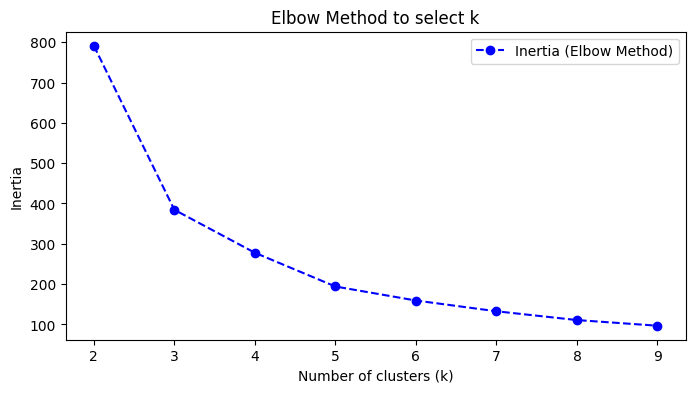

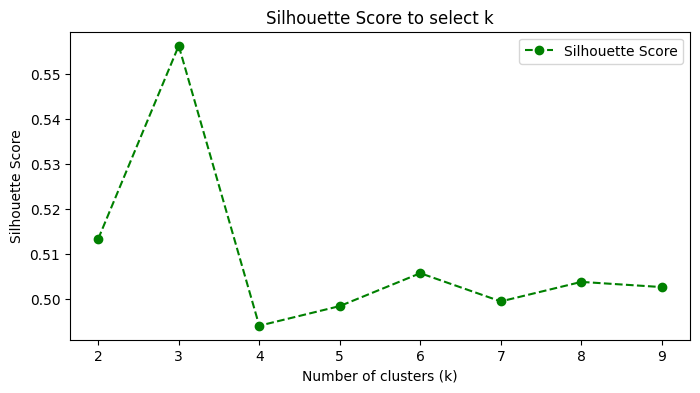

The best number of clusters based on the silhouette score is: 3


<ipython-input-46-8c48260df3ab>:99: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  dynamic_cmap = cm.get_cmap("tab10", best_k)


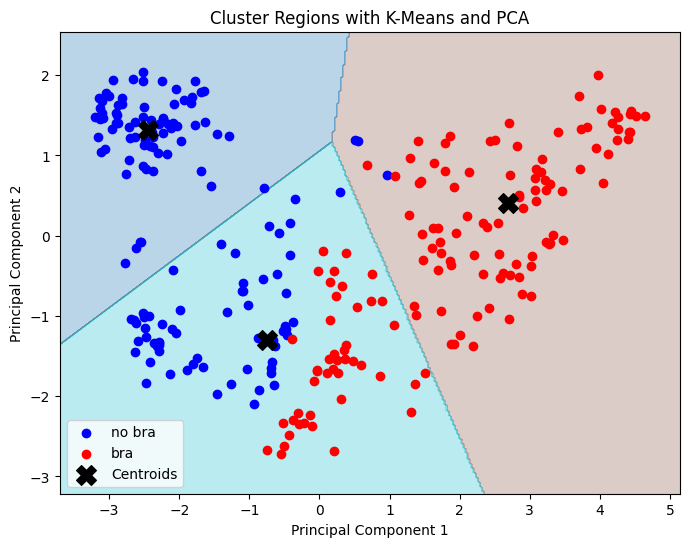

In [ ]:
analyze_clusters(df_layers,layer='layer_22_file_path', pca_components=2, cluster_range=(2, 10), cmap_points=None)

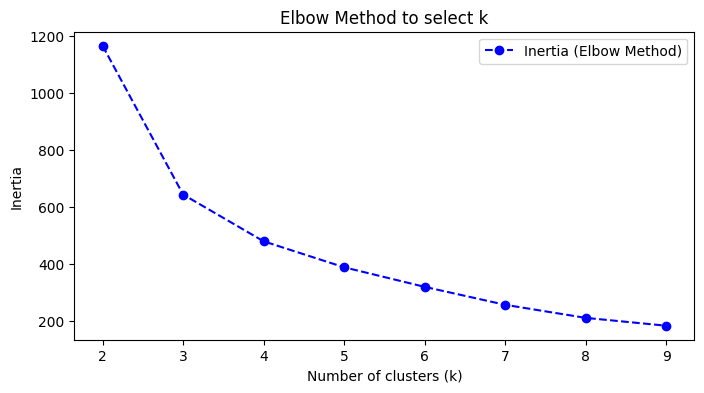

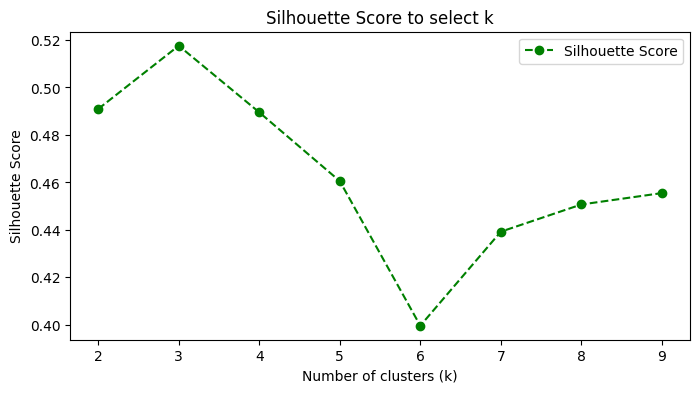

The best number of clusters based on the silhouette score is: 3


<ipython-input-46-8c48260df3ab>:99: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  dynamic_cmap = cm.get_cmap("tab10", best_k)


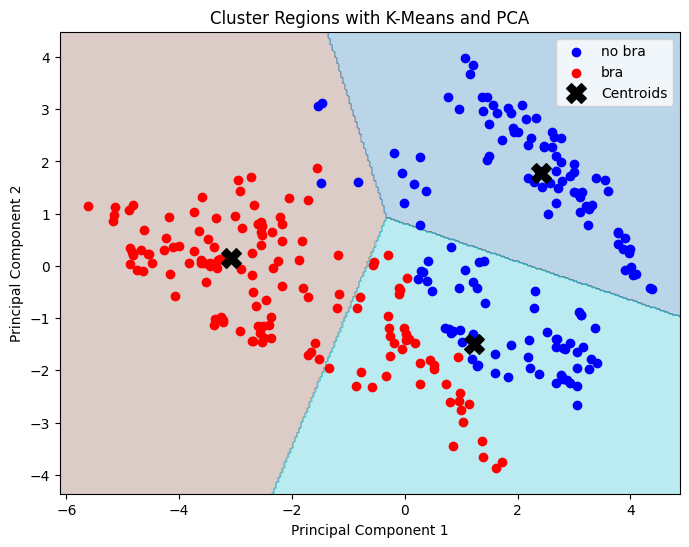

In [ ]:
analyze_clusters(df_layers,layer='layer_23_file_path', pca_components=2, cluster_range=(2, 10), cmap_points=None)

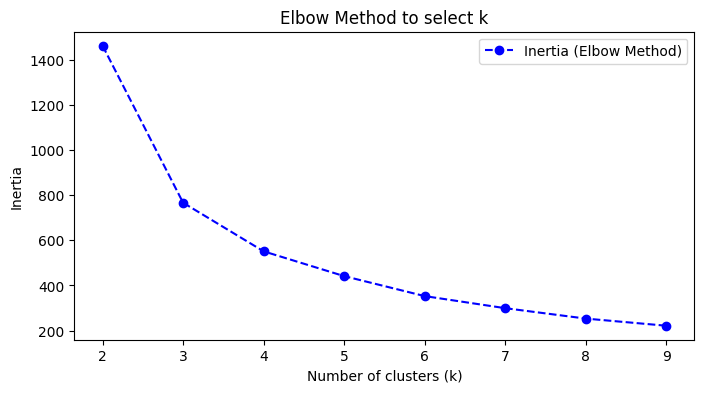

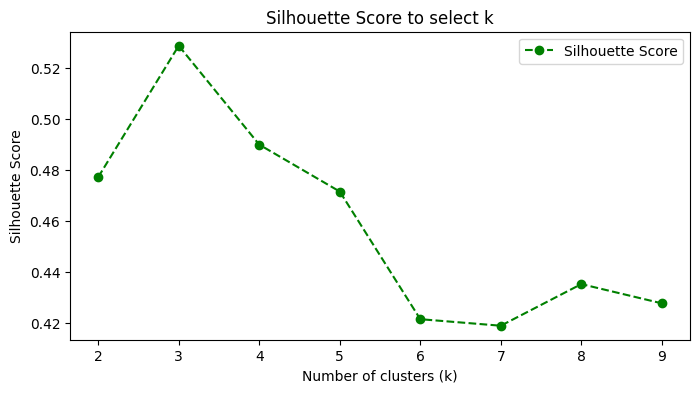

The best number of clusters based on the silhouette score is: 3


<ipython-input-46-8c48260df3ab>:99: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  dynamic_cmap = cm.get_cmap("tab10", best_k)


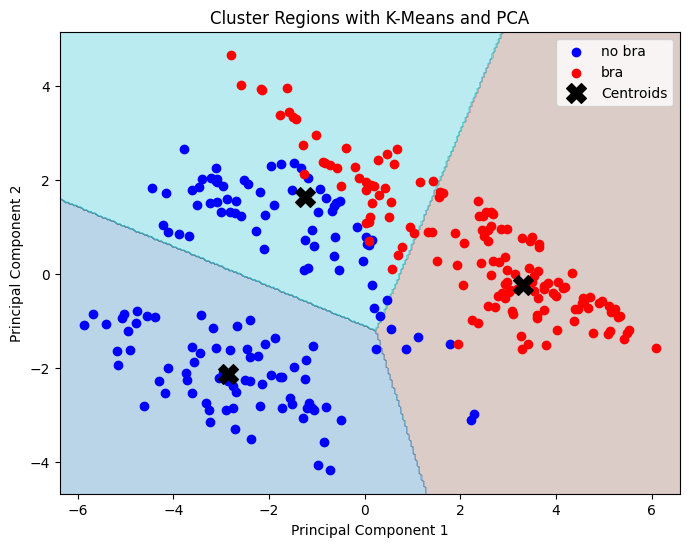

In [ ]:
analyze_clusters(df_layers,layer='layer_24_file_path', pca_components=2, cluster_range=(2, 10), cmap_points=None)


### SAE X16

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
CLIP_SAE = CustomCLIPVisionModel(dir_sae_hf='22_resid/1200013184.pt',layer_sae='22').to(device)
CLIP_SAE.eval()
preprocess_text_img = CLIPProcessor.from_pretrained("laion/CLIP-ViT-L-14-laion2B-s32B-b82K")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_token.py:90: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:
n=16

state_dict_22_x16 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/weights_layer22.pth')
sae_22_x16 = JumpReluSAE(1024,1024*n)
sae_22_x16.load_state_dict(state_dict_22_x16, strict=False)
sae_22_x16 = sae_22_x16.to(device)

state_dict_23_x16 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/weights_layer23.pth')
sae_23_x16 = JumpReluSAE(1024,1024*n)
sae_23_x16.load_state_dict(state_dict_23_x16, strict=False)
sae_23_x16 = sae_23_x16.to(device)

state_dict_24_x16 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/weights_layer24.pth')
sae_24_x16 = JumpReluSAE(1024,1024*n)
sae_24_x16.load_state_dict(state_dict_24_x16, strict=False)
sae_24_x16 = sae_24_x16.to(device)

SAEs = [sae_22_x16,sae_23_x16,sae_24_x16]

<ipython-input-25-ba1bf41d6bdd>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict_22_x16 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Ap

In [ ]:


BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/"
laten_path = os.path.join(BASE_PATH, "latens_activation/")
output_json_path = os.path.join(BASE_PATH, "latens_activation/data_extraction_without_intervene.json")


# Load existing results or initialize a new list
if os.path.exists(output_json_path):
    with open(output_json_path, "r") as f:
        results = json.load(f)
    print(f"JSON found: Loaded {len(results)} previous results.")
else:
    results = []
    print("No previous JSON found. Initializing empty results.")


# Process dataset
for idx in range(0,281):
    img, mask_gt, prompt, state, img_name = dataset[idx]


    # Preprocess image and text
    preprocessed = preprocess_text_img(images=img, text=[prompt])
    img_preprocessed = torch.tensor(np.array(preprocessed['pixel_values'])).to(device)
    text_processed = torch.tensor(preprocessed['input_ids']).to(device)



    # Generate explanation using CLIP-SAE
    general_info = CLIP_SAE.forward(pixel_values=img_preprocessed,
                                    text_values = text_processed,
                                    n=25,
                                    intervene_layer_sae=22,
                                    SAEs=SAEs,
                                    data_extraction=True,
                                    intervene_laten_vector=None)

    name = os.path.splitext(img_name)[0]

    #Layer_22
    laten_layer_22  = general_info['data_extraction_laten'][0].detach().cpu().numpy()
    cos_layer_22 = general_info['cos_reconstruction_laten'][0].detach().cpu().numpy()

    layer_22_file_path = os.path.join(f'{laten_path}22/', f"{name}_laten_22.npy")
    np.save(layer_22_file_path, laten_layer_22)

    #Layer_23
    laten_layer_23  = general_info['data_extraction_laten'][1].detach().cpu().numpy()
    cos_layer_23 = general_info['cos_reconstruction_laten'][1].detach().cpu().numpy()

    layer_23_file_path = os.path.join(f'{laten_path}23/', f"{name}_laten_23.npy")
    np.save(layer_23_file_path, laten_layer_23)

    #Layer_24
    laten_layer_24  = general_info['data_extraction_laten'][2].detach().cpu().numpy()
    cos_layer_24 = general_info['cos_reconstruction_laten'][2].detach().cpu().numpy()

    layer_24_file_path = os.path.join(f'{laten_path}24/', f"{name}_laten_24.npy")
    np.save(layer_24_file_path, laten_layer_24)

    results.append({
        "image_name_url": img_name,
        "prompt": prompt,
        "body_state": state,
        "cosine_global":general_info['cos_reconstruction_constractive'].detach().cpu().item(),

        "layer_22_file_path":layer_22_file_path,
        "cos_layer_22": float(cos_layer_22),

        "layer_23_file_path":layer_23_file_path,
        "cos_layer_23": float(cos_layer_23),

        "layer_24_file_path":layer_24_file_path,
        "cos_layer_24": float(cos_layer_24),

        })

    # Save results to JSON
    with open(output_json_path, "w") as outfile:
        json.dump(results, outfile, indent=4)

    print(f"Processed index: {idx}")

No previous JSON found. Initializing empty results.
Coseno reconstru layer 21 tensor([0.9993], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9977], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9811], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2404], device='cuda:0', grad_fn=<SumBackward1>)


<ipython-input-30-755f563041f7>:67: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  "cos_layer_22": float(cos_layer_22),
<ipython-input-30-755f563041f7>:70: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  "cos_layer_23": float(cos_layer_23),
<ipython-input-30-755f563041f7>:73: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  "cos_layer_24": float(cos_layer_24),


Processed index: 0
Coseno reconstru layer 21 tensor([0.9992], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9982], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9976], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2689], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 1
Coseno reconstru layer 21 tensor([0.9993], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9986], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9977], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2444], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 2
Coseno reconstru layer 21 tensor([0.9991], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9979], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9964], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2111], device='cuda

IndexError: list index out of range

In [ ]:
path_json_layer= "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/latens_activation/data_extraction_without_intervene.json"
df_layers = pd.read_json(path_json_layer)

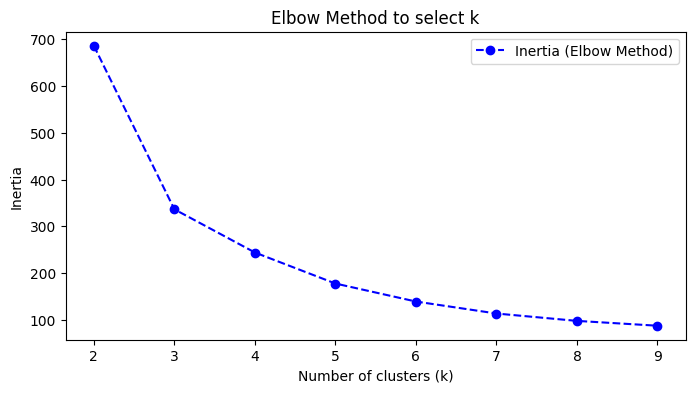

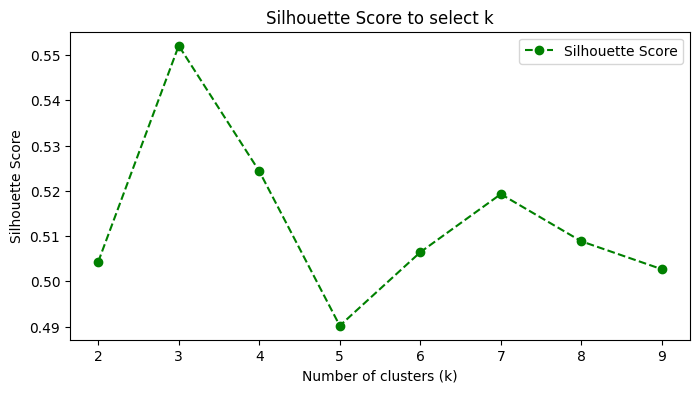

The best number of clusters based on the silhouette score is: 3


<ipython-input-32-818dacb67f03>:99: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  dynamic_cmap = cm.get_cmap("tab10", best_k)


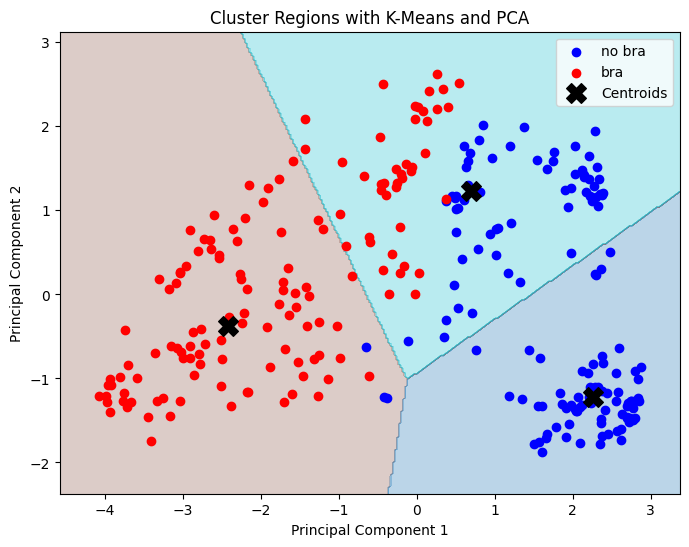

In [ ]:
analyze_clusters(df_layers,layer='layer_22_file_path', pca_components=2, cluster_range=(2, 10), cmap_points=None)

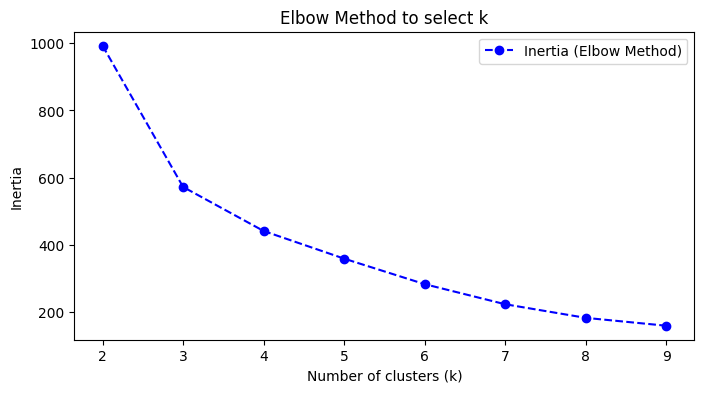

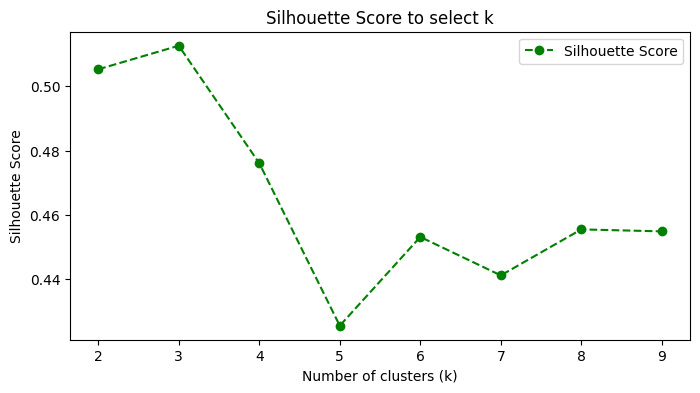

The best number of clusters based on the silhouette score is: 3


<ipython-input-32-818dacb67f03>:99: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  dynamic_cmap = cm.get_cmap("tab10", best_k)


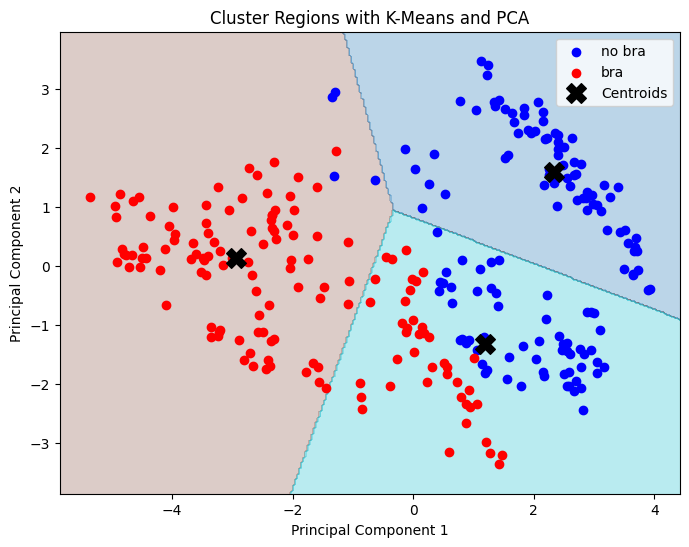

In [ ]:
analyze_clusters(df_layers,layer='layer_23_file_path', pca_components=2, cluster_range=(2, 10), cmap_points=None)

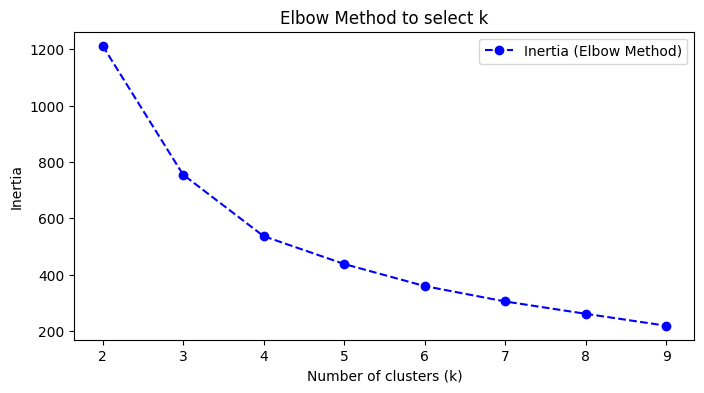

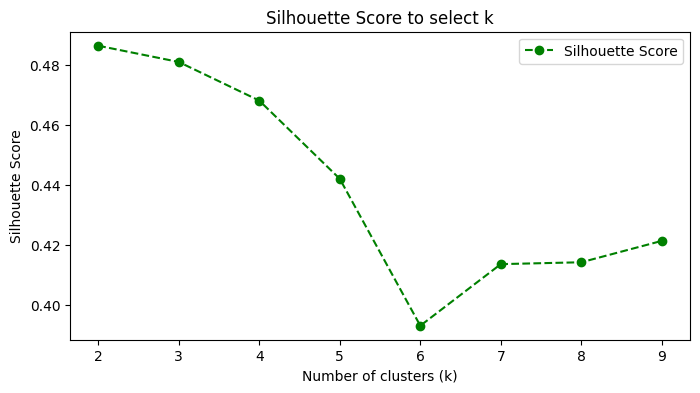

The best number of clusters based on the silhouette score is: 2


<ipython-input-32-818dacb67f03>:99: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  dynamic_cmap = cm.get_cmap("tab10", best_k)


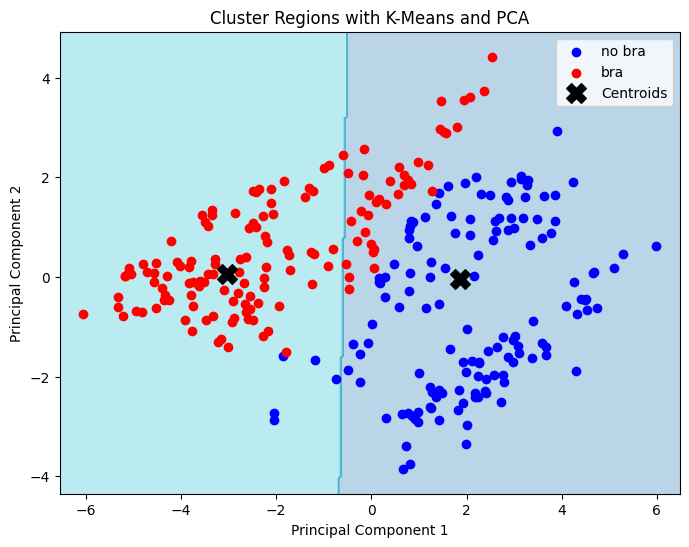

In [ ]:
analyze_clusters(df_layers,layer='layer_24_file_path', pca_components=2, cluster_range=(2, 10), cmap_points=None)

### SAE X32

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
CLIP_SAE = CustomCLIPVisionModel(dir_sae_hf='22_resid/1200013184.pt',layer_sae='22').to(device)
CLIP_SAE.eval()
preprocess_text_img = CLIPProcessor.from_pretrained("laion/CLIP-ViT-L-14-laion2B-s32B-b82K")

In [ ]:
n=32

state_dict_22_x32 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/weights_layer22.pth')
sae_22_x32 = JumpReluSAE(1024,1024*n)
sae_22_x32.load_state_dict(state_dict_22_x32, strict=False)
sae_22_x32 = sae_22_x32.to(device)

state_dict_23_x32 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/weights_layer23.pth')
sae_23_x32 = JumpReluSAE(1024,1024*n)
sae_23_x32.load_state_dict(state_dict_23_x32, strict=False)
sae_23_x32 = sae_23_x32.to(device)

state_dict_24_x32 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/weights_layer24.pth')
sae_24_x32 = JumpReluSAE(1024,1024*n)
sae_24_x32.load_state_dict(state_dict_24_x32, strict=False)
sae_24_x32 = sae_24_x32.to(device)

SAEs = [sae_22_x32,sae_23_x32,sae_24_x32]

<ipython-input-27-2fce782d41f7>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict_22_x32 = torch.load('/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Ap

In [ ]:


BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/"
laten_path = os.path.join(BASE_PATH, "latens_activation/")
output_json_path = os.path.join(BASE_PATH, "latens_activation/data_extraction_without_intervene.json")


# Load existing results or initialize a new list
if os.path.exists(output_json_path):
    with open(output_json_path, "r") as f:
        results = json.load(f)
    print(f"JSON found: Loaded {len(results)} previous results.")
else:
    results = []
    print("No previous JSON found. Initializing empty results.")


# Process dataset
for idx in range(0,281):
    img, mask_gt, prompt, state, img_name = dataset[idx]


    # Preprocess image and text
    preprocessed = preprocess_text_img(images=img, text=[prompt])
    img_preprocessed = torch.tensor(np.array(preprocessed['pixel_values'])).to(device)
    text_processed = torch.tensor(preprocessed['input_ids']).to(device)



    # Generate explanation using CLIP-SAE
    general_info = CLIP_SAE.forward(pixel_values=img_preprocessed,
                                    text_values = text_processed,
                                    n=25,
                                    intervene_layer_sae=22,
                                    SAEs=SAEs,
                                    data_extraction=True,
                                    intervene_laten_vector=None)

    name = os.path.splitext(img_name)[0]

    #Layer_22
    laten_layer_22  = general_info['data_extraction_laten'][0].detach().cpu().numpy()
    cos_layer_22 = general_info['cos_reconstruction_laten'][0].detach().cpu().numpy()

    layer_22_file_path = os.path.join(f'{laten_path}/22/', f"{name}_laten_22.npy")
    np.save(layer_22_file_path, laten_layer_22)

    #Layer_23
    laten_layer_23  = general_info['data_extraction_laten'][1].detach().cpu().numpy()
    cos_layer_23 = general_info['cos_reconstruction_laten'][1].detach().cpu().numpy()

    layer_23_file_path = os.path.join(f'{laten_path}/23/', f"{name}_laten_23.npy")
    np.save(layer_23_file_path, laten_layer_23)

    #Layer_24
    laten_layer_24  = general_info['data_extraction_laten'][2].detach().cpu().numpy()
    cos_layer_24 = general_info['cos_reconstruction_laten'][2].detach().cpu().numpy()

    layer_24_file_path = os.path.join(f'{laten_path}/24/', f"{name}_laten_24.npy")
    np.save(layer_24_file_path, laten_layer_24)

    results.append({
        "image_name_url": img_name,
        "prompt": prompt,
        "body_state": state,
        "cosine_global":general_info['cos_reconstruction_constractive'].detach().cpu().item(),

        "layer_22_file_path":layer_22_file_path,
        "cos_layer_22": float(cos_layer_22),

        "layer_23_file_path":layer_23_file_path,
        "cos_layer_23": float(cos_layer_23),

        "layer_24_file_path":layer_24_file_path,
        "cos_layer_24": float(cos_layer_24),

        })

    # Save results to JSON
    with open(output_json_path, "w") as outfile:
        json.dump(results, outfile, indent=4)

    print(f"Processed index: {idx}")

No previous JSON found. Initializing empty results.
Coseno reconstru layer 21 tensor([0.9985], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9948], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9304], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2218], device='cuda:0', grad_fn=<SumBackward1>)


<ipython-input-28-9015ef2b2547>:67: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  "cos_layer_22": float(cos_layer_22),
<ipython-input-28-9015ef2b2547>:70: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  "cos_layer_23": float(cos_layer_23),
<ipython-input-28-9015ef2b2547>:73: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  "cos_layer_24": float(cos_layer_24),


Processed index: 0
Coseno reconstru layer 21 tensor([0.9985], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9973], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9961], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2678], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 1
Coseno reconstru layer 21 tensor([0.9989], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9979], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9978], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2383], device='cuda:0', grad_fn=<SumBackward1>)
Processed index: 2
Coseno reconstru layer 21 tensor([0.9991], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 22 tensor([0.9981], device='cuda:0', grad_fn=<SumBackward1>)
Coseno reconstru layer 23 tensor([0.9968], device='cuda:0', grad_fn=<SumBackward1>)
Final consin  tensor([0.2109], device='cuda

IndexError: list index out of range

In [ ]:
path_json_layer= "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_32/latens_activation/data_extraction_without_intervene.json"
df_layers = pd.read_json(path_json_layer)

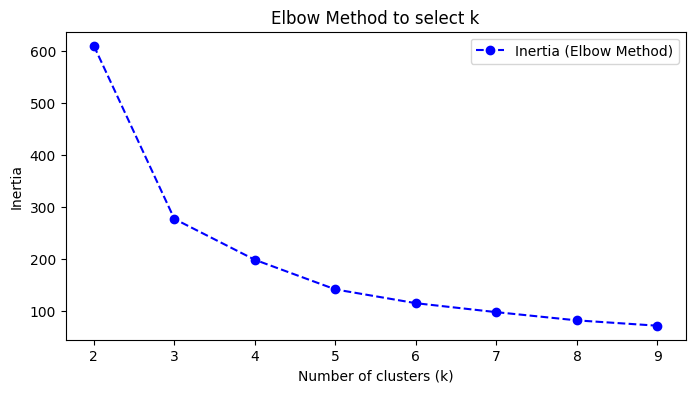

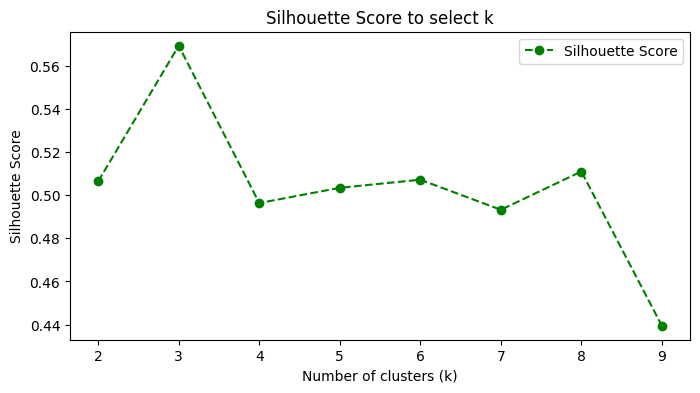

The best number of clusters based on the silhouette score is: 3


<ipython-input-46-8c48260df3ab>:99: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  dynamic_cmap = cm.get_cmap("tab10", best_k)


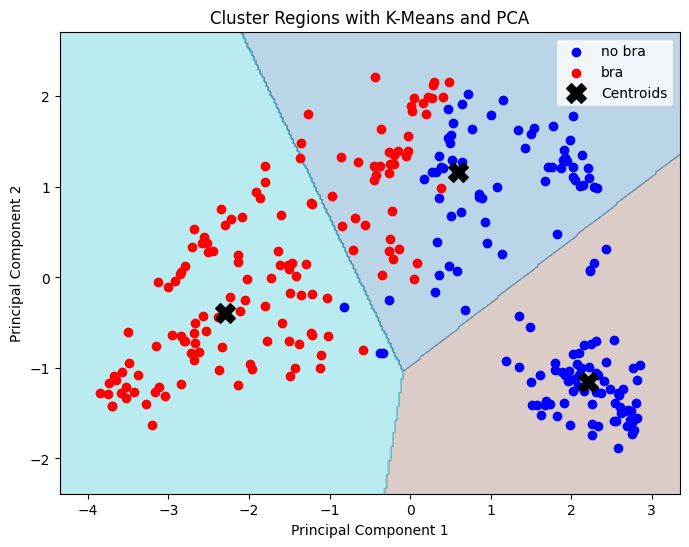

In [ ]:
analyze_clusters(df_layers,layer='layer_22_file_path', pca_components=2, cluster_range=(2, 10), cmap_points=None)

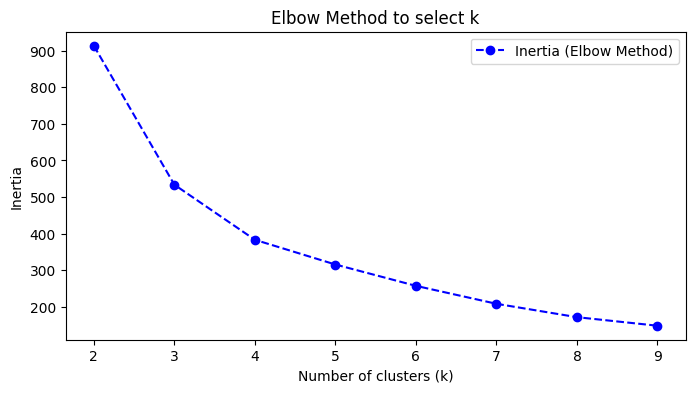

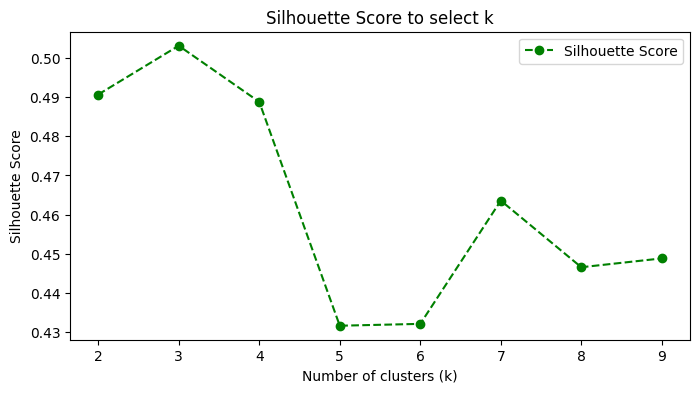

The best number of clusters based on the silhouette score is: 3


<ipython-input-46-8c48260df3ab>:99: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  dynamic_cmap = cm.get_cmap("tab10", best_k)


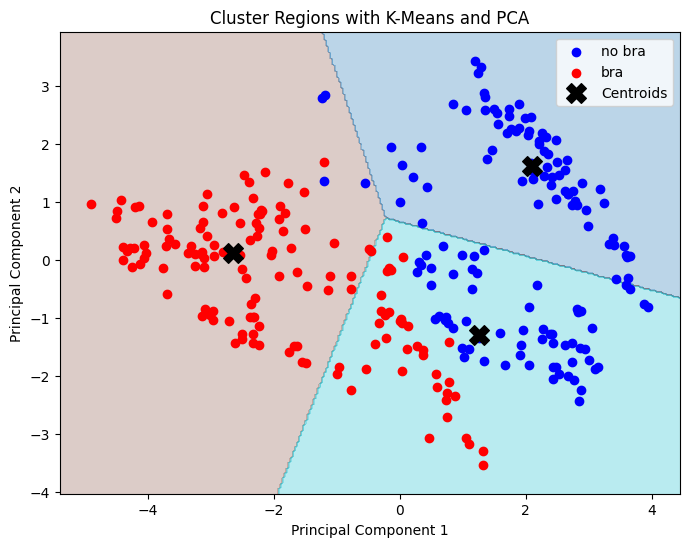

In [ ]:
analyze_clusters(df_layers,layer='layer_23_file_path', pca_components=2, cluster_range=(2, 10), cmap_points=None)

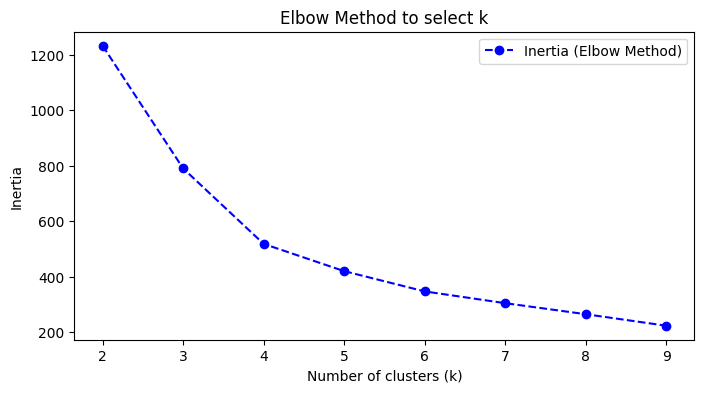

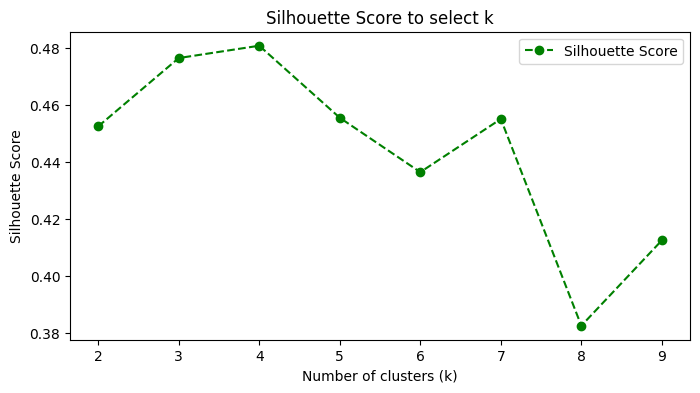

The best number of clusters based on the silhouette score is: 4


<ipython-input-46-8c48260df3ab>:99: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  dynamic_cmap = cm.get_cmap("tab10", best_k)


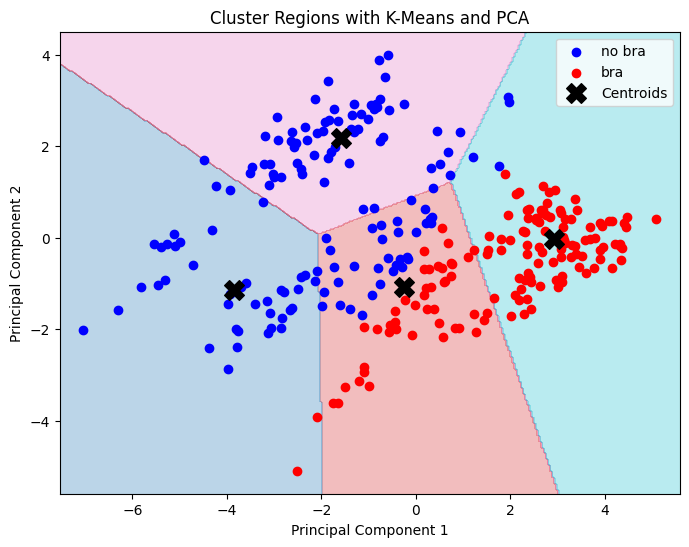

In [ ]:
analyze_clusters(df_layers,layer='layer_24_file_path', pca_components=2, cluster_range=(2, 10), cmap_points=None)

### **Evaluation of Cos similitud**

In [ ]:
import os
import pandas as pd
import json

# Main path where the folders are located
base_path = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES"
base_cosine_path = '/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/DATASET/SAE_DATASET/data_extraction_without_intervene.json'

# Load the original cosine data
with open(base_cosine_path, 'r') as file:
    json_data = json.load(file)
    df_oring_cosine = pd.DataFrame(json_data)

def process_json_files(base_path):
    dataframes = {}
    cosine_columns = {}

    # Iterate through the main folders
    for factor_folder in os.listdir(base_path):
        factor_path = os.path.join(base_path, factor_folder)

        if os.path.isdir(factor_path):
            latens_path = os.path.join(factor_path, "latens_activation")

            if os.path.exists(latens_path):

                # Iterate through JSON files in latens_activation
                for json_file in os.listdir(latens_path):

                    if json_file.endswith(".json"):
                        json_file_path = os.path.join(latens_path, json_file)

                        # Read the JSON file and convert it to a DataFrame
                        with open(json_file_path, 'r') as file:
                            try:
                                json_data = json.load(file)
                                df = pd.DataFrame(json_data)

                                # Save the DataFrame in the dictionary
                                key = f"{factor_folder}/{json_file}"
                                dataframes[key] = df

                                # Extract the 'cosine_global' column
                                if 'cosine_global' in df.columns:
                                    cosine_columns[factor_folder] = df['cosine_global']

                            except Exception as e:
                                print(f"Error processing {json_file_path}: {e}")

    # Create a new table with the cosine_global columns
    final_table = pd.DataFrame()
    for factor, cosine_column in sorted(cosine_columns.items()):
        column_name = f"cosine_globalx{factor.split('_')[-1]}"
        final_table[column_name] = cosine_column.reset_index(drop=True)

    return dataframes, final_table

# Call the function
all_dataframes, cosine_global_table = process_json_files(base_path)

# Add the original cosine_global column
cosin_tablet = cosine_global_table
cosin_tablet['cosine_global'] = df_oring_cosine['cosine']

# Calculate the absolute differences
cosin_tablet["diff_x16"] = abs(cosin_tablet["cosine_global"] - cosin_tablet["cosine_globalx16"])
cosin_tablet["diff_x32"] = abs(cosin_tablet["cosine_global"] - cosin_tablet["cosine_globalx32"])
cosin_tablet["diff_x8"] = abs(cosin_tablet["cosine_global"] - cosin_tablet["cosine_globalx8"])

# Display the final table
print("Final table with cosine_global columns:")
print(cosin_tablet.head())

# Calculate global metrics
summary = cosin_tablet[["diff_x16", "diff_x32", "diff_x8"]].describe()

# Display the summary
summary

Final table with cosine_global columns:
   cosine_globalx16  cosine_globalx32  cosine_globalx8  cosine_global  \
0          0.240418          0.221757         0.233731       0.247811   
1          0.268932          0.267818         0.269782       0.269169   
2          0.244392          0.238299         0.241403       0.241333   
3          0.211080          0.210899         0.209101       0.205120   
4          0.211106          0.213941         0.215110       0.209355   

   diff_x16  diff_x32   diff_x8  
0  0.007393  0.026054  0.014081  
1  0.000236  0.001351  0.000613  
2  0.003058  0.003035  0.000070  
3  0.005960  0.005779  0.003981  
4  0.001752  0.004586  0.005755  


,diff_x16,diff_x32,diff_x8
count,280.000000,280.000000,280.000000
mean,0.003751,0.004153,0.003465
std,0.003945,0.005361,0.004523
min,0.000008,0.000050,0.000022
25%,0.001003,0.001044,0.000862
50%,0.002449,0.002410,0.001907
75%,0.005122,0.004536,0.004240
max,0.026835,0.033800,0.039550


# **SELECTION N VALUE GRAD ECLIP**

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
CLIP_SAE = CustomCLIPVisionModel(dir_sae_hf='22_resid/1200013184.pt',layer_sae='22').to(device)
CLIP_SAE.eval()
preprocess_text_img = CLIPProcessor.from_pretrained("laion/CLIP-ViT-L-14-laion2B-s32B-b82K")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_token.py:90: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Last layer




In [ ]:
for idx in range(0,20):
    img, mask_gt, prompt, state, img_name = dataset[idx]

    preproces_mixt = preprocess_text_img(images = img, text=[prompt])
    img_preprocessed = torch.tensor(preproces_mixt['pixel_values']).to(device)
    text_processed  = torch.tensor(preproces_mixt['input_ids']).to(device)

    general_info = CLIP_SAE.grad_eclip(pixel_values=img_preprocessed, text_values=text_processed, n=23,intervene_layer_sae=22,intervene_laten_vector=None,img = img, plot = False)

    heatmap_img = Image.fromarray(general_info['heatmap_and_img'] , mode="RGB")
    plt.imshow(heatmap_img)
    plt.show()



Layer 22

In [ ]:
for idx in range(0,20):
    img, mask_gt, prompt, state, img_name = dataset[idx]

    preproces_mixt = preprocess_text_img(images = img, text=[prompt])
    img_preprocessed = torch.tensor(preproces_mixt['pixel_values']).to(device)
    text_processed  = torch.tensor(preproces_mixt['input_ids']).to(device)


    general_info = CLIP_SAE.grad_eclip(pixel_values=img_preprocessed, text_values=text_processed, n=22,intervene_layer_sae=22,intervene_laten_vector=None,img = img, plot = False)

    heatmap_img = Image.fromarray(general_info['heatmap_and_img'] , mode="RGB")
    plt.imshow(heatmap_img)
    plt.show()




Layer 20

In [ ]:
for idx in range(0,20):
    img, mask_gt, prompt, state, img_name = dataset[idx]

    preproces_mixt = preprocess_text_img(images = img, text=[prompt])
    img_preprocessed = torch.tensor(preproces_mixt['pixel_values']).to(device)
    text_processed  = torch.tensor(preproces_mixt['input_ids']).to(device)
    #n=19

    general_info = CLIP_SAE.grad_eclip(pixel_values=img_preprocessed, text_values=text_processed, n=20,intervene_layer_sae=22,intervene_laten_vector=None,img = img, plot = False)


    heatmap_img = Image.fromarray(general_info['heatmap_and_img'] , mode="RGB")
    plt.imshow(heatmap_img)
    plt.show()


Layer 17

In [ ]:
for idx in range(0,20):
    img, mask_gt, prompt, state, img_name = dataset[idx]

    preproces_mixt = preprocess_text_img(images = img, text=[prompt])
    img_preprocessed = torch.tensor(preproces_mixt['pixel_values']).to(device)
    text_processed  = torch.tensor(preproces_mixt['input_ids']).to(device)

    general_info = CLIP_SAE.grad_eclip(pixel_values=img_preprocessed, text_values=text_processed, n=17,intervene_layer_sae=22,intervene_laten_vector=None,img = img, plot = False)

    heatmap_img = Image.fromarray(general_info['heatmap_and_img'] , mode="RGB")
    plt.imshow(heatmap_img)
    plt.show()

Layer 13

In [ ]:
for idx in range(0,20):
    img, mask_gt, prompt, state, img_name = dataset[idx]

    preproces_mixt = preprocess_text_img(images = img, text=[prompt])
    img_preprocessed = torch.tensor(preproces_mixt['pixel_values']).to(device)
    text_processed  = torch.tensor(preproces_mixt['input_ids']).to(device)

    general_info = CLIP_SAE.grad_eclip(pixel_values=img_preprocessed, text_values=text_processed, n=13,intervene_layer_sae=22,intervene_laten_vector=None,img = img, plot = False)


    heatmap_img = Image.fromarray(general_info['heatmap_and_img'] , mode="RGB")
    plt.imshow(heatmap_img)
    plt.show()


Layer 9

In [ ]:
for idx in range(0,20):
    img, mask_gt, prompt, state, img_name = dataset[idx]

    preproces_mixt = preprocess_text_img(images = img, text=[prompt])
    img_preprocessed = torch.tensor(preproces_mixt['pixel_values']).to(device)
    text_processed  = torch.tensor(preproces_mixt['input_ids']).to(device)

    general_info = CLIP_SAE.grad_eclip(pixel_values=img_preprocessed, text_values=text_processed, n=9,intervene_layer_sae=22,intervene_laten_vector=None,img = img, plot = False)

    heatmap_img = Image.fromarray(general_info['heatmap_and_img'] , mode="RGB")
    plt.imshow(heatmap_img)
    plt.show()


Layer 4

In [ ]:
for idx in range(0,20):
    img, mask_gt, prompt, state, img_name = dataset[idx]

    preproces_mixt = preprocess_text_img(images = img, text=[prompt])
    img_preprocessed = torch.tensor(preproces_mixt['pixel_values']).to(device)
    text_processed  = torch.tensor(preproces_mixt['input_ids']).to(device)

    general_info = CLIP_SAE.grad_eclip(pixel_values=img_preprocessed, text_values=text_processed, n=4,intervene_layer_sae=22,intervene_laten_vector=None,img = img, plot = False)

    heatmap_img = Image.fromarray(general_info['heatmap_and_img'] , mode="RGB")
    plt.imshow(heatmap_img)
    plt.show()


Layer 1

In [ ]:
for idx in range(0,20):
    img, mask_gt, prompt, state, img_name = dataset[idx]

    preproces_mixt = preprocess_text_img(images = img, text=[prompt])
    img_preprocessed = torch.tensor(preproces_mixt['pixel_values']).to(device)
    text_processed  = torch.tensor(preproces_mixt['input_ids']).to(device)

    general_info = CLIP_SAE.grad_eclip(pixel_values=img_preprocessed, text_values=text_processed, n=1,intervene_layer_sae=22,intervene_laten_vector=None,img = img, plot = False)


    heatmap_img = Image.fromarray(general_info['heatmap_and_img'] , mode="RGB")
    plt.imshow(heatmap_img)
    plt.show()




# **DATA EXTRACTION**

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
path_sae = '/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/WEIGTHS_SAES/FACTOR_16/weights_layer22.pth'
CLIP_SAE = CustomCLIPModelGradEclipSae(layer_sae=22,factor=16,path_sae_weigths = path_sae).to(device)
CLIP_SAE.eval()
preprocess_text_img = CLIPProcessor.from_pretrained("laion/CLIP-ViT-L-14-laion2B-s32B-b82K")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_token.py:90: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
<ipython-input-6-0661ec20a7e0>:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the

**For SOBEM dataset**

In [ ]:
# Define paths
BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/RESULTS/whitout_intervene/"
output_json_path = os.path.join(BASE_PATH, "data_extraction_without_intervene.json")
img_with_heatmap_url = os.path.join(BASE_PATH, "img_heatmaps/")
heatmap_url = os.path.join(BASE_PATH, "heatmaps/")
final_masks_url = os.path.join(BASE_PATH, "final_masks/")
json_path = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/DATASET/DATASET-SOBEM-9/train/_annotations.coco.json"

# Define thresholds
thresholds = [0.1 * i for i in range(1, 10)]

# Load existing results or initialize a new list
if os.path.exists(output_json_path):
    with open(output_json_path, "r") as f:
        results = json.load(f)
    print(f"JSON found: Loaded {len(results)} previous results.")
else:
    results = []
    print("No previous JSON found. Initializing empty results.")

# Process dataset
for idx in range(259,281):
    img, mask_gt, prompt, state, img_name = dataset[idx]

    # Preprocess image and text
    preprocessed = preprocess_text_img(images=img, text=[prompt])
    img_preprocessed = torch.tensor(np.array(preprocessed['pixel_values'])).to(device)
    text_processed = torch.tensor(preprocessed['input_ids']).to(device)

    # Generate explanation using CLIP-SAE
    general_info = CLIP_SAE.grad_eclip(
        pixel_values=img_preprocessed,
        text_values=text_processed,
        n=22,
        intervene_laten_vector=None,
        img=img,
        plot=False)

    # Extract image name
    name = os.path.splitext(img_name)[0]

    # Save heatmap
    heatmap = general_info['heatmap']
    heatmap_file_path = os.path.join(heatmap_url, f"{name}_heatmap.npy")
    np.save(heatmap_file_path, heatmap)

    # Save heatmap overlaid on image
    heatmap_img = Image.fromarray(general_info['heatmap_and_img'], mode="RGB")
    heatmap_img_file_path = os.path.join(img_with_heatmap_url, f"{name}_heatmap_with_img.png")
    heatmap_img.save(heatmap_img_file_path)

    # Compute IoUs and save final masks
    ious = []
    for threshold in thresholds:
        iou, final_mask = compute_ious_multiple_objects(mask_gt, heatmap, threshold, plot=False, n=0.001)
        ious.append(iou)

        final_mask_file_path = os.path.join(final_masks_url, f"{name}_IoU_{str(threshold)[2]}.npy")
        np.save(final_mask_file_path, final_mask)

    # Append results
    results.append({
        "image_name_url": img_name,
        "heatmap_url": heatmap_file_path,
        "heatmap_img_url": heatmap_img_file_path,
        "prompt": prompt,
        "body_state": state,
        "cosine_score": general_info['cosine_similarity'].detach().cpu().item(),
        "ious@0.1-0.9": ious,
        "final_masks_url": final_masks_url,
    })

    # Save results to JSON
    with open(output_json_path, "w") as outfile:
        json.dump(results, outfile, indent=4)

    print(f"Processed index: {idx}")


JSON found: Loaded 259 previous results.


It looks like you are trying to rescale already rescaled images. If the input images have pixel values between 0 and 1, set `do_rescale=False` to avoid rescaling them again.


Processed index: 259
Processed index: 260
Processed index: 261
Processed index: 262
Processed index: 263
Processed index: 264
Processed index: 265
Processed index: 266
Processed index: 267
Processed index: 268
Processed index: 269
Processed index: 270
Processed index: 271
Processed index: 272
Processed index: 273
Processed index: 274
Processed index: 275
Processed index: 276
Processed index: 277
Processed index: 278
Processed index: 279


IndexError: list index out of range

**For our dataset**

In [ ]:
# Define paths
BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/RESULTS/whitout_intervene_short_dataset/"
output_json_path = os.path.join(BASE_PATH, "data_extraction_without_intervene.json")
img_with_heatmap_url = os.path.join(BASE_PATH, "img_heatmaps/")

heatmap_url = os.path.join(BASE_PATH, "heatmaps/")
final_masks_url = os.path.join(BASE_PATH, "final_masks/")

# Load existing results or initialize a new list
if os.path.exists(output_json_path):
    with open(output_json_path, "r") as f:
        results = json.load(f)
    print(f"JSON found: Loaded {len(results)} previous results.")
else:
    results = []
    print("No previous JSON found. Initializing empty results.")

# Process dataset
for idx in range(18,27):
    img, prompt, state, img_name = short_dataset[idx]

    # Preprocess image and text
    preprocessed = preprocess_text_img(images=img, text=[prompt])
    img_preprocessed = torch.tensor(np.array(preprocessed['pixel_values'])).to(device)
    text_processed = torch.tensor(preprocessed['input_ids']).to(device)

    # Generate explanation using CLIP-SAE
    general_info = CLIP_SAE.grad_eclip(
        pixel_values=img_preprocessed,
        text_values=text_processed,
        n=22,
        intervene_layer_sae=22,
        intervene_laten_vector=None,
        img=img,
        plot=False
    )

    # Extract image name
    name = os.path.splitext(img_name)[0]

    # Save latent space vectors
    latent_vectors = general_info['laten_space']
    latent_vector = torch.cat(latent_vectors, dim=0)
    latent_file_path = os.path.join(laten_spaces_url, f"{name}_laten.npy")
    np.save(latent_file_path, latent_vector.detach().cpu().numpy())

    # Save heatmap
    heatmap = general_info['heatmap']
    heatmap_file_path = os.path.join(heatmap_url, f"{name}_heatmap.npy")
    np.save(heatmap_file_path, heatmap)

    # Save heatmap overlaid on image
    heatmap_img = Image.fromarray(general_info['heatmap_and_img'], mode="RGB")
    heatmap_img_file_path = os.path.join(img_with_heatmap_url, f"{name}_heatmap_with_img.png")
    heatmap_img.save(heatmap_img_file_path)


    # Append results
    results.append({
        "image_name_url": img_name,
        "latent_space_url": latent_file_path,
        "heatmap_url": heatmap_file_path,
        "heatmap_img_url": heatmap_img_file_path,
        "prompt": prompt,
        "body_state": state,
        "cosine_score": general_info['cosine_similarity'].detach().cpu().item(),
        "final_masks_url": final_masks_url,
    })

    # Save results to JSON
    with open(output_json_path, "w") as outfile:
        json.dump(results, outfile, indent=4)

    print(f"Processed index: {idx}")

# **DATA ANALYSIS**

For SOBEM Dataset Ablation TopK 1

In [ ]:
BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/RESULTS/whitout_intervene/"
output_json_path = os.path.join(BASE_PATH, "data_extraction_without_intervene.json")

TsV = 9 #threshold values ​​to consider
df_sobem = pd.read_json(output_json_path)
df_sobem["avg_iou"] = df_sobem["ious@0.1-0.9"].apply(lambda iou_list: sum(iou_list[0:TsV])/len(iou_list[0:TsV]))

# mean_Open_NoOpen = df_sobem.groupby("body_state")["avg_iou"].mean()
# print(mean_Open_NoOpen)


thresholds_table = pd.DataFrame()

for i, threshold in enumerate(range(1, 10)):
    column_name = f"th 0.{threshold}"
    thresholds_table[column_name] = df_sobem.groupby("body_state")["ious@0.1-0.9"].apply(
        lambda x:  round(sum([item[threshold - 1] for item in x]) / len(x), 3)
    )

# Transposing to match the required format (columns: thresholds, rows: O and NO)
thresholds_table = thresholds_table.transpose()


averages_table = pd.DataFrame()

for i, threshold in enumerate(range(1, 10)):
    column_name = f"th 0.1-{threshold/10:.1f} avr"
    averages_table[column_name] = df_sobem.groupby("body_state")["ious@0.1-0.9"].apply(
        lambda x: round(sum(sum(item[:threshold]) / threshold for item in x) / len(x), 3)
    )

# Transposing to match the required format (columns: cumulative averages, rows: O and NO)
averages_table = averages_table.transpose()




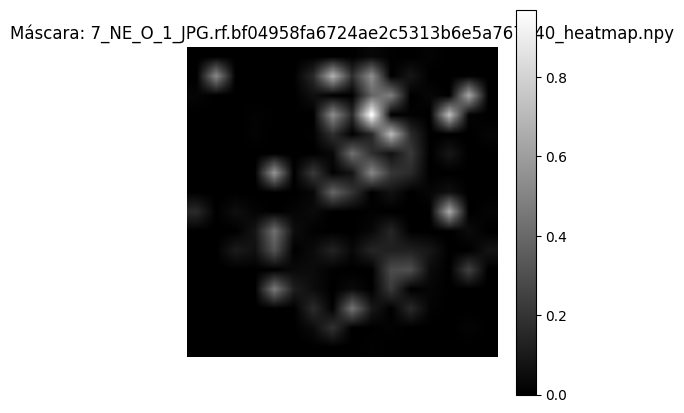

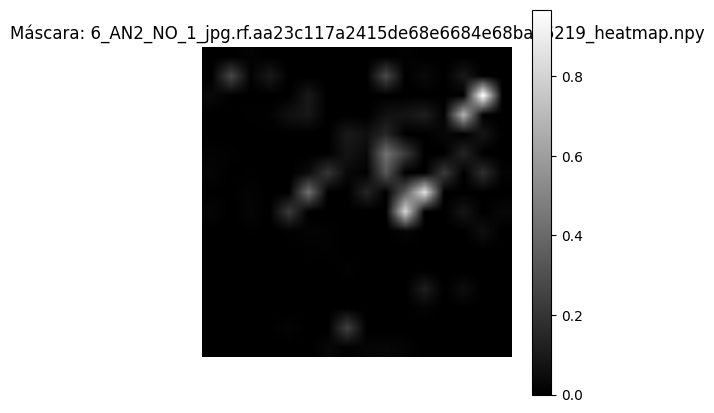

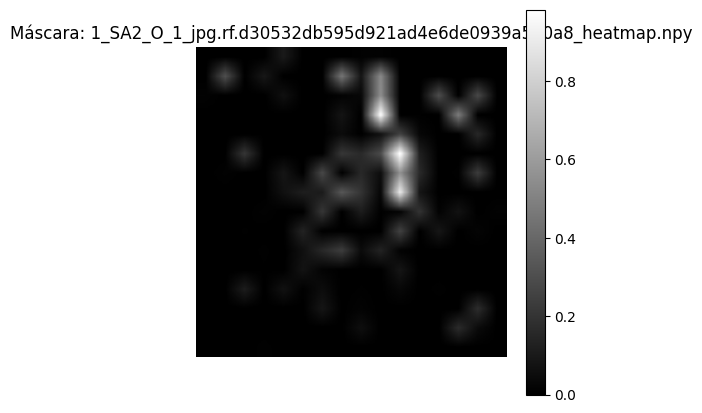

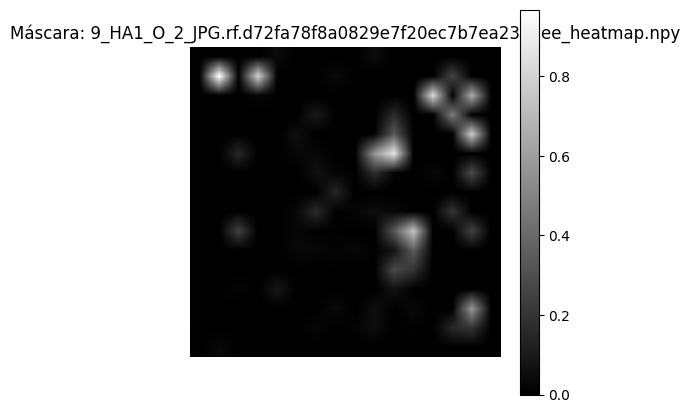

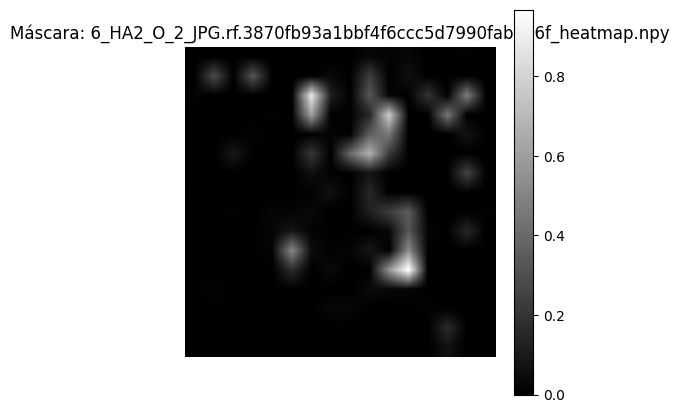

...

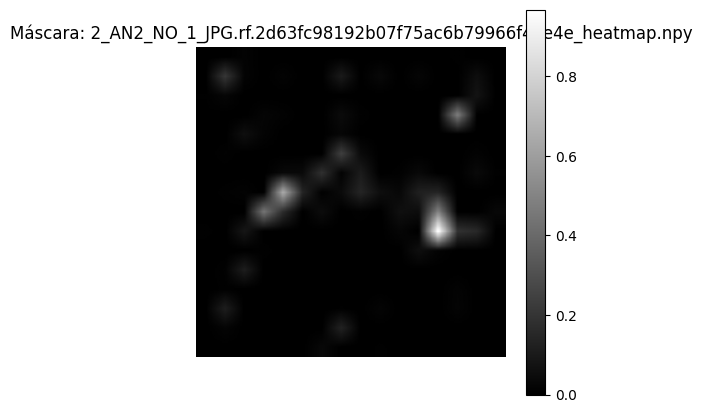

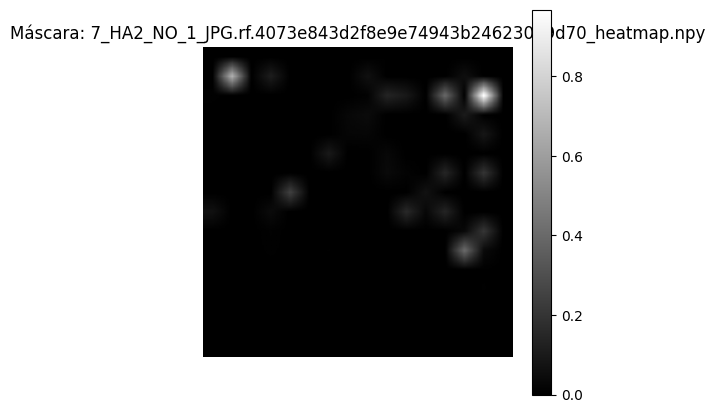

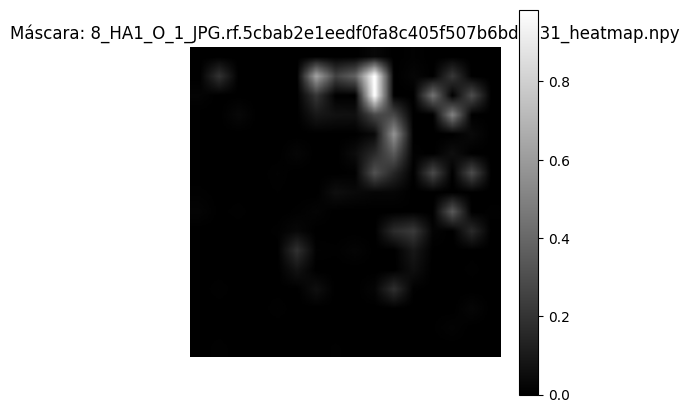

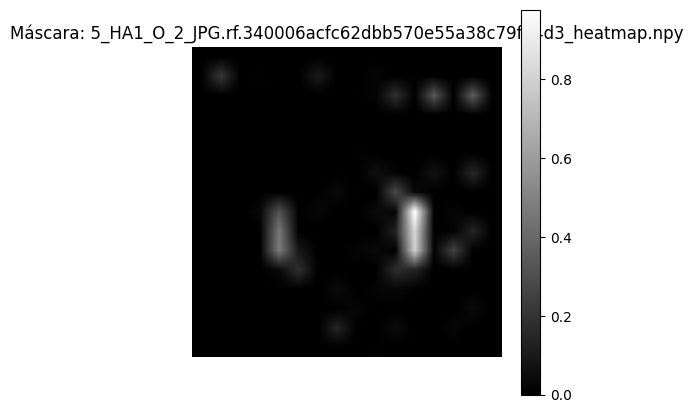

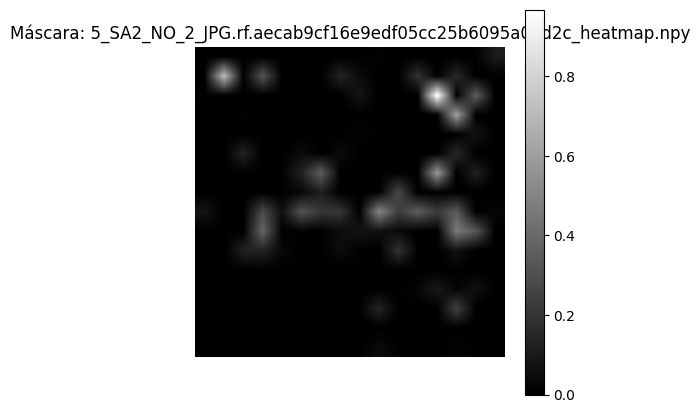

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import os
import glob

# Ruta del folder que contiene las máscaras
folder_path = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/RESULTS/whitout_intervene/heatmaps/"

# Obtener lista de archivos .npy en el folder
npy_files = glob.glob(os.path.join(folder_path, "*.npy"))

# Recorrer cada archivo y mostrarlo
for file_path in npy_files:
    # Cargar la máscara
    mask = np.load(file_path)

    # Mostrar la máscara
    plt.figure(figsize=(5, 5))
    plt.imshow(mask, cmap="gray")  # Usar cmap="gray" para segmentaciones binarias
    plt.colorbar()  # Opcional
    plt.title(f"Máscara: {os.path.basename(file_path)}")
    plt.axis("off")
    plt.show()


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df_sobem

,image_name_url,heatmap_url,heatmap_img_url,prompt,body_state,cosine_score,ious@0.1-0.9,final_masks_url,avg_iou
0,7_NE_O_1_JPG.rf.bf04958fa6724ae2c5313b6e5a767d...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,a photo of a person neutral,O,0.248523,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]",/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.0
1,6_AN2_NO_1_jpg.rf.aa23c117a2415de68e6684e68bae...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,a photo of a person angry,NO,0.268403,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]",/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.0
2,1_SA2_O_1_jpg.rf.d30532db595d921ad4e6de0939a56...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,a photo of a person sad,O,0.240156,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]",/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.0
3,9_HA1_O_2_JPG.rf.d72fa78f8a0829e7f20ec7b7ea23d...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,a photo of a person happy,O,0.203916,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]",/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.0
4,6_HA2_O_2_JPG.rf.3870fb93a1bbf4f6ccc5d7990fab0...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,a photo of a person happy,O,0.209678,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]",/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.0
...,...,...,...,...,...,...,...,...,...
275,2_AN2_NO_1_JPG.rf.2d63fc98192b07f75ac6b79966f4...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,a photo of a person angry,NO,0.263082,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]",/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.0
276,7_HA2_NO_1_JPG.rf.4073e843d2f8e9e74943b2462303...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,a photo of a person happy,NO,0.222588,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]",/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.0
277,8_HA1_O_1_JPG.rf.5cbab2e1eedf0fa8c405f507b6bdd...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,a photo of a person happy,O,0.207288,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]",/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.0
278,5_HA1_O_2_JPG.rf.340006acfc62dbb570e55a38c79f3...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,a photo of a person happy,O,0.217560,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]",/content/drive/MyDrive/AISA/HeatMapSae-A-Gradi...,0.0


In [ ]:
thresholds_table

body_state,NO,O
th 0.1,0.0,0.0
th 0.2,0.0,0.0
th 0.3,0.0,0.0
th 0.4,0.0,0.0
th 0.5,0.0,0.0
th 0.6,0.0,0.0
th 0.7,0.0,0.0
th 0.8,0.0,0.0
th 0.9,0.0,0.0


In [ ]:
averages_table

body_state,NO,O
th 0.1-0.1 avr,0.0,0.0
th 0.1-0.2 avr,0.0,0.0
th 0.1-0.3 avr,0.0,0.0
th 0.1-0.4 avr,0.0,0.0
th 0.1-0.5 avr,0.0,0.0
th 0.1-0.6 avr,0.0,0.0
th 0.1-0.7 avr,0.0,0.0
th 0.1-0.8 avr,0.0,0.0
th 0.1-0.9 avr,0.0,0.0


Analysis of activations

In [ ]:
import numpy as np
import pandas as pd

# Supongamos que tu DataFrame se llama df
# Contiene las columnas: 'latent_space_url' y 'body_state'

# 1. Separar DataFrame
df_o = df_sobem[df_sobem['body_state'] == 'O']
df_no = df_sobem[df_sobem['body_state'] == 'NO']

# 2. Función para cargar y apilar matrices
def load_and_stack(df_subset):
    # Lista para cada matriz
    all_arrays = []
    for idx, row in df_subset.iterrows():
        path = row['latent_space_url']
        # Supongamos que es un archivo .npy en Google Drive
        # (tal vez tengas que montar drive y usar la ruta absoluta)
        latent = np.load(path)  # latent.shape = (8, 65000)

        # Opcional: Normalizar dentro de esta matriz antes de apilar
        # Por ejemplo, zscore fila a fila
        # latent = zscore_normalization_2d(latent)

        all_arrays.append(latent)

    # Apilar en un solo array: shape = (num_instancias, 8, 65000)
    return np.stack(all_arrays, axis=0)

def zscore_per_layer(diff):
    """
    Aplica normalización Z-score a la matriz diff capa por capa.
    diff.shape = (num_layers, num_neurons)
    """
    diff_norm = diff.copy().astype(np.float32)

    for i in range(diff_norm.shape[0]):
        row = diff_norm[i, :]
        mean_val = np.mean(row)
        std_val = np.std(row)
        if std_val < 1e-12:
            std_val = 1e-12
        diff_norm[i, :] = (row - mean_val) / std_val

    return diff_norm




def get_topk_neurons(diff, k=1000):
    # 1. Aplanar la matriz de diferencias
    flat_diff = diff.flatten()  # shape = 8*65000 = 520000

    # 2. Ordenar índices en orden descendente de valor
    # np.argsort() ordena ascendente; el signo negativo -> descendente
    sorted_indices = np.argsort(-flat_diff)

    # 3. Tomar los primeros k
    topk_indices = sorted_indices[:k]

    # 4. Convertir índices planos a (layer, neuron)
    # capa = idx // 65000
    # neurona = idx % 65000
    candidates = []
    for idx in topk_indices:
        layer = idx // diff.shape[1]
        neuron = idx % diff.shape[1]
        value = flat_diff[idx]
        candidates.append((layer, neuron, value))

    return candidates


# 4. Normalizar globalmente si lo deseas
# Por ejemplo, hacer z-score por capa y neurona a través de instancias
# -------------------------------------------------------------------
#   - Esto depende de tu criterio:
#   - a) Normalizar cada conjunto (O/NO) por separado
#   - b) Normalizar ambos juntos
#   - c) Ya lo hiciste en la función load_and_stack

# Ejemplo: normalizar “dentro de cada grupo” (O o NO)
# Por capa y neurona => Se calcula mean y std en axis=0 (las instancias)
# def zscore_across_instances(arr):
#     # # arr = (num_instancias, 8, 65000)
#     # mean_ = arr.mean(axis=0, keepdims=True)  # shape = (1, 8, 65000)
#     # std_  = arr.std(axis=0, keepdims=True)   # shape = (1, 8, 65000)
#     # std_[std_ < 1e-12] = 1e-12               # evitar div por cero
#     # arr_z = (arr - mean_) / std_
#     return arr#arr_z






# arr_o_z = zscore_across_instances(arr_o)  # shape = (N_O, 8, 65000)
# arr_no_z = zscore_across_instances(arr_no)

arr_o = load_and_stack(df_o)  # shape = (N_O, 8, 65000)
arr_no = load_and_stack(df_no)  # shape = (N_NO, 8, 65000)

# 5. Calcular la media por capa y neurona en cada grupo
mean_o = arr_o.mean(axis=0)   # shape = (8, 65000)
mean_no = arr_no.mean(axis=0) # shape = (8, 65000)

# 6. Obtener la diferencia
diff = mean_o - mean_no  # shape = (8, 65000)


diff_norm_zscore = zscore_per_layer(diff)


top_neurons = get_topk_neurons(diff_norm_zscore, k=1000)

top_neurons


[(0, 41215, 50.676052),
 (0, 17492, 35.46369),
 (0, 11693, 30.218721),
 (0, 21088, 25.644037),
 (0, 39254, 20.564802),
 (0, 7326, 18.55556),
 (0, 27466, 17.3283),
 (0, 18604, 11.016098),
 (0, 5188, 10.327964),
 (1, 58081, 10.217147),
 (1, 11431, 10.120387),
 (0, 53601, 9.653541),
 (0, 21388, 9.554192),
 (0, 57360, 9.428106),
 (0, 2264, 9.318742),
 (0, 19973, 9.242732),
 (0, 34295, 9.217096),
 (0, 6790, 9.124243),
 (1, 60461, 8.997882),
 (0, 63107, 8.738768),
 (0, 43968, 8.419278),
 (0, 20828, 8.232379),
 (1, 6413, 8.222463),
 (0, 57846, 8.173482),
 (0, 48674, 8.156063),
 (1, 49433, 8.121232),
 (0, 13144, 8.036955),
 (1, 43968, 7.955667),
 (0, 61904, 7.952821),
 (1, 522, 7.89637),
 (1, 38287, 7.8712482),
 (1, 20828, 7.869391),
 (0, 25615, 7.8088045),
 (0, 26164, 7.7807198),
 (0, 3296, 7.771087),
 (0, 40877, 7.6963325),
 (0, 42585, 7.677537),
 (0, 455, 7.6558576),
 (0, 34105, 7.643851),
 (0, 60713, 7.5990815),
 (0, 39987, 7.579608),
 (0, 2186, 7.5058746),
 (1, 15670, 7.490717),
 (1, 2186

In [ ]:
BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/RESULTS/whitout_intervene_short_dataset/"
output_json_path = os.path.join(BASE_PATH, "data_extraction_without_intervene.json")

df_short_dataset = pd.read_json(output_json_path)

arr_sh_o = load_and_stack(df_short_dataset)

mean_sh_o = arr_sh_o.mean(axis=0)   # shape = (8, 65000)

diff_sh_o = mean_sh_o - mean_no  # shape = (8, 65000)

diff_sh_o_norm_zscore = zscore_per_layer(diff_sh_o)

top_neurons_sh_o = get_topk_neurons(diff_sh_o_norm_zscore, k=1000)

top_neurons_sh_o

[(0, 17492, 46.445805),
 (0, 18604, 43.728672),
 (0, 39254, 42.694035),
 (0, 15851, 28.776525),
 (0, 21088, 18.252031),
 (0, 41215, 17.866644),
 (0, 18739, 15.988541),
 (0, 35177, 14.569529),
 (1, 51138, 12.861559),
 (1, 58081, 12.585483),
 (1, 27184, 12.518534),
 (0, 13144, 11.381396),
 (0, 5188, 11.325733),
 (0, 21680, 11.158583),
 (1, 16691, 10.795427),
 (1, 7608, 10.668629),
 (1, 51562, 10.115738),
 (1, 49433, 10.046416),
 (1, 17671, 9.966894),
 (1, 48447, 9.814956),
 (1, 55813, 9.611721),
 (1, 52829, 9.57978),
 (1, 6413, 9.494851),
 (1, 60092, 9.447519),
 (1, 64042, 9.250812),
 (0, 40937, 9.239981),
 (1, 4358, 9.207317),
 (0, 34105, 9.151455),
 (1, 16356, 9.112067),
 (0, 45018, 9.056564),
 (1, 2186, 9.014246),
 (1, 53421, 8.979216),
 (1, 57593, 8.953991),
 (1, 2093, 8.937607),
 (1, 54286, 8.795985),
 (1, 31924, 8.73011),
 (1, 37182, 8.709632),
 (1, 6010, 8.605195),
 (1, 6182, 8.419359),
 (0, 64231, 8.327204),
 (1, 58568, 8.282672),
 (0, 48674, 8.234943),
 (1, 58949, 8.208306),
 (1

In [ ]:
dict_main = { (c, n): val for (c, n, val) in top_neurons}
dict_new  = { (c, n): val for (c, n, val) in top_neurons_sh_o}

# 2. Hallar intersección de keys
set_main = set(dict_main.keys())
set_new  = set(dict_new.keys())

intersection = set_main.intersection(set_new)

# 3. Ordenar neuronas en común por suma de diffs (ejemplo)
common_sorted = sorted(
    intersection,
    key=lambda x: dict_main[x] + dict_new[x],
    reverse=True
)


In [ ]:
common_sorted[:50]

[(0, 17492),
 (0, 41215),
 (0, 39254),
 (0, 18604),
 (0, 21088),
 (0, 11693),
 (0, 15851),
 (1, 58081),
 (0, 27466),
 (0, 5188),
 (0, 13144),
 (0, 35177),
 (1, 49433),
 (1, 6413),
 (0, 34295),
 (1, 17671),
 (0, 34105),
 (1, 2186),
 (0, 48674),
 (1, 51138),
 (0, 21680),
 (0, 28805),
 (1, 11431),
 (0, 2186),
 (0, 40273),
 (0, 43968),
 (0, 31288),
 (0, 53601),
 (1, 6182),
 (0, 63107),
 (0, 35274),
 (1, 30506),
 (0, 13747),
 (0, 23400),
 (1, 16691),
 (0, 40877),
 (0, 64231),
 (0, 39671),
 (0, 57360),
 (1, 55813),
 (0, 20828),
 (1, 43968),
 (0, 45018),
 (0, 1718),
 (0, 26682),
 (0, 62971),
 (1, 10528),
 (0, 40937),
 (0, 3296),
 (1, 58568)]

# **ABLATION PROCESS**

# **FIRST INTERVENTION TOPK20**

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
CLIP_SAE = CustomCLIPVisionModel(dir_sae_hf='22_resid/1200013184.pt',layer_sae='22').to(device)
CLIP_SAE.eval()
preprocess_text_img = CLIPProcessor.from_pretrained("laion/CLIP-ViT-L-14-laion2B-s32B-b82K")


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_token.py:90: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:

# Define paths
BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/RESULTS/whit_intervene/TOP50K/"
output_json_path = os.path.join(BASE_PATH, "data_extraction_without_intervene.json")
img_with_heatmap_url = os.path.join(BASE_PATH, "img_heatmaps/")
laten_spaces_url = os.path.join(BASE_PATH, "laten_spaces/")
heatmap_url = os.path.join(BASE_PATH, "heatmaps/")
final_masks_url = os.path.join(BASE_PATH, "final_masks/")
json_path = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/DATASET/DATASET-SOBEM-9/train/_annotations.coco.json"

# Define thresholds
thresholds = [0.1 * i for i in range(1, 10)]

# Load existing results or initialize a new list
if os.path.exists(output_json_path):
    with open(output_json_path, "r") as f:
        results = json.load(f)
    print(f"JSON found: Loaded {len(results)} previous results.")
else:
    results = []
    print("No previous JSON found. Initializing empty results.")


intervention_info = common_sorted[:50]
values = 0
intervene_laten_vector = [intervention_info,values]


# Process dataset
for idx in range(270,282):
    img, mask_gt, prompt, state, img_name = dataset[idx]

    # Preprocess image and text
    preprocessed = preprocess_text_img(images=img, text=[prompt])
    img_preprocessed = torch.tensor(np.array(preprocessed['pixel_values'])).to(device)
    text_processed = torch.tensor(preprocessed['input_ids']).to(device)

    # Generate explanation using CLIP-SAE
    general_info = CLIP_SAE.grad_eclip(
        pixel_values=img_preprocessed,
        text_values=text_processed,
        n=22,
        intervene_layer_sae=22,
        intervene_laten_vector=intervene_laten_vector,
        img=img,
        plot=False
    )

    # Extract image name
    name = os.path.splitext(img_name)[0]

    # Save latent space vectors
    latent_vectors = general_info['laten_space']
    latent_vector = torch.cat(latent_vectors, dim=0)
    latent_file_path = os.path.join(laten_spaces_url, f"{name}_laten.npy")
    np.save(latent_file_path, latent_vector.detach().cpu().numpy())

    # Save heatmap
    heatmap = general_info['heatmap']
    heatmap_file_path = os.path.join(heatmap_url, f"{name}_heatmap.npy")
    np.save(heatmap_file_path, heatmap)

    # Save heatmap overlaid on image
    heatmap_img = Image.fromarray(general_info['heatmap_and_img'], mode="RGB")
    heatmap_img_file_path = os.path.join(img_with_heatmap_url, f"{name}_heatmap_with_img.png")
    heatmap_img.save(heatmap_img_file_path)

    # Compute IoUs and save final masks
    ious = []
    for threshold in thresholds:
        iou, final_mask = compute_ious_multiple_objects(mask_gt, heatmap, threshold, plot=False, n=0.001)
        ious.append(iou)

        final_mask_file_path = os.path.join(final_masks_url, f"{name}_IoU_{str(threshold)[2]}.npy")
        np.save(final_mask_file_path, final_mask)

    # Append results
    results.append({
        "image_name_url": img_name,
        "latent_space_url": latent_file_path,
        "heatmap_url": heatmap_file_path,
        "heatmap_img_url": heatmap_img_file_path,
        "prompt": prompt,
        "body_state": state,
        "cosine_score": general_info['cosine_similarity'].detach().cpu().item(),
        "ious@0.1-0.9": ious,
        "final_masks_url": final_masks_url,
    })

    # Save results to JSON
    with open(output_json_path, "w") as outfile:
        json.dump(results, outfile, indent=4)

    print(f"Processed index: {idx}")

JSON found: Loaded 270 previous results.
Processed index: 270
Processed index: 271
Processed index: 272
Processed index: 273
Processed index: 274
Processed index: 275
Processed index: 276
Processed index: 277
Processed index: 278
Processed index: 279


IndexError: list index out of range

# **RESULTDS**

In [ ]:
import re

In [ ]:
def create_IoU_table(url_json):

    match = re.search(r'/TOP(\d+)K/', url_json)
    if match:
        topk = int(match.group(1))
    else:
        topk = 'wo interven'

    df_sobem = pd.read_json(url_json)
    thresholds_table = pd.DataFrame()

    for i, threshold in enumerate(range(1, 10)):
        column_name = f"th 0.{threshold} topk{topk}"
        thresholds_table[column_name] = df_sobem.groupby("body_state")["ious@0.1-0.9"].apply(
            lambda x:  round(sum([item[threshold - 1] for item in x]) / len(x), 3)
        )

    # Transposing to match the required format (columns: thresholds, rows: O and NO)
    thresholds_table = thresholds_table.transpose()


    averages_table = pd.DataFrame()

    for i, threshold in enumerate(range(1, 10)):
        column_name = f"th 0.1-{threshold/10:.1f} avr"
        averages_table[column_name] = df_sobem.groupby("body_state")["ious@0.1-0.9"].apply(
            lambda x: round(sum(sum(item[:threshold]) / threshold for item in x) / len(x), 3)
        )

    # Transposing to match the required format (columns: cumulative averages, rows: O and NO)
    averages_table = averages_table.transpose()

    return thresholds_table, averages_table


In [ ]:
BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/RESULTS/whit_intervene/"
json_file = 'data_extraction_without_intervene.json'
folders = [f'{BASE_PATH}{nombre}/{json_file}' for nombre in os.listdir(BASE_PATH) if os.path.isdir(os.path.join(BASE_PATH, nombre))]
BASE_PATH = "/content/drive/MyDrive/AISA/HeatMapSae-A-Gradient-Centric-Approach-to-Explaining-CLIP-Through-Sparse-Latent-Activations/RESULTS/whitout_intervene/"
folders.append(f'{BASE_PATH}{json_file}')

In [ ]:
result_list = []
for file_url in folders:

  result_list.append(create_IoU_table(file_url))


In [ ]:
pd.concat([result_list[5][1], result_list[7][1]],axis=0)

body_state,NO,O
th 0.1-0.1 avr,0.091,0.129
th 0.1-0.2 avr,0.066,0.095
th 0.1-0.3 avr,0.051,0.073
th 0.1-0.4 avr,0.041,0.059
th 0.1-0.5 avr,0.034,0.048
th 0.1-0.6 avr,0.029,0.041
th 0.1-0.7 avr,0.025,0.035
th 0.1-0.8 avr,0.022,0.031
th 0.1-0.9 avr,0.020,0.028
th 0.1-0.1 avr,0.057,0.186


In [ ]:
result_list[6][0]

body_state,NO,O
th 0.1 topk50,0.090,0.129
th 0.2 topk50,0.042,0.062
th 0.3 topk50,0.021,0.029
th 0.4 topk50,0.011,0.015
th 0.5 topk50,0.006,0.007
th 0.6 topk50,0.003,0.004
th 0.7 topk50,0.001,0.002
th 0.8 topk50,0.000,0.000
th 0.9 topk50,0.000,0.000


In [ ]:
result_list[7][0]

body_state,NO,O
th 0.1 topkwo interven,0.057,0.186
th 0.2 topkwo interven,0.016,0.103
th 0.3 topkwo interven,0.005,0.061
th 0.4 topkwo interven,0.002,0.037
th 0.5 topkwo interven,0.001,0.022
th 0.6 topkwo interven,0.000,0.012
th 0.7 topkwo interven,0.000,0.007
th 0.8 topkwo interven,0.000,0.003
th 0.9 topkwo interven,0.000,0.001
